In [1]:
# Importing DataLoaders for each model. These models include rule-based, vanilla DQN and encoder-decoder DQN.
from DataLoader.DataLoader import YahooFinanceDataLoader
from DataLoader.DataForPatternBasedAgent import DataForPatternBasedAgent
from DataLoader.DataAutoPatternExtractionAgent import DataAutoPatternExtractionAgent
from DataLoader.DataSequential import DataSequential

from DeepRLAgent.MLPEncoder.Train import Train as SimpleMLP
from DeepRLAgent.SimpleCNNEncoder.Train import Train as SimpleCNN
from EncoderDecoderAgent.GRU.Train import Train as GRU
from EncoderDecoderAgent.CNN.Train import Train as CNN
from EncoderDecoderAgent.CNN2D.Train import Train as CNN2d
from EncoderDecoderAgent.CNNAttn.Train import Train as CNN_ATTN
from EncoderDecoderAgent.CNN_GRU.Train import Train as CNN_GRU

# Imports for Deep RL Agent
from DeepRLAgent.VanillaInput.Train import Train as DeepRL

import pandas as pd
import torch
import os
import random
import numpy as np
from utils import save_pkl, load_pkl, set_random_seed, plot_hyperparams, plot_optimization_progress, plot_prob_accusition
import os
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px

DATA_LOADERS = {
    'BTC-USD': YahooFinanceDataLoader(
        'BTC-USD',
        begin_date='2021-01-01',
        split_point='2023-10-01',
        validation_split_point='2024-01-01',
        end_date='2024-03-01',
        load_from_file=False
    ),

    'GOOGL': YahooFinanceDataLoader(
        'GOOGL',
        split_point='2018-01-01',
        validation_split_point='2018-01-01',
        load_from_file=True
    ),

    'AAPL': YahooFinanceDataLoader(
        'AAPL',
        split_point='2018-01-01',
        validation_split_point='2018-01-01',
        begin_date='2010-01-01',
        end_date='2020-08-24',
        load_from_file=True
    ),

    'DJI': YahooFinanceDataLoader(
        'DJI',
        split_point='2016-01-01',
        validation_split_point='2018-01-01',
        begin_date='2009-01-01',
        end_date='2018-09-30',
        load_from_file=True
    ),

    'S&P': YahooFinanceDataLoader(
        'S&P',
        begin_date = '2020-01-01',
        split_point='2023-08-01',
        validation_split_point='2023-10-01',
        load_from_file=True
    ),

    'AMD': YahooFinanceDataLoader(
        'AMD',
        split_point=2000,
        validation_split_point=2000,
        end_date='2018-09-25',
        load_from_file=True
    ),

    'GE': YahooFinanceDataLoader(
        'GE',
        split_point='2015-01-01',
        validation_split_point='2015-01-01',
        load_from_file=True
    ),

    'KSS': YahooFinanceDataLoader(
        'KSS',
        split_point='2018-01-01',
        validation_split_point='2018-01-01',
        load_from_file=True
    ),

    'HSI': YahooFinanceDataLoader(
        'HSI',
        split_point='2015-01-01',
        validation_split_point='2015-01-01',
        load_from_file=True
    ),

    'AAL': YahooFinanceDataLoader(
        'AAL',
        split_point='2018-01-01',
        validation_split_point='2018-01-01',
        load_from_file=True
    )
}


class SensitivityRun:
    def __init__(
        self,
            dataset_name,
            gamma,
            batch_size,
            replay_memory_size,
            feature_size,
            target_update,
            n_episodes,
            n_step,
            window_size,
            device,
            evaluation_parameter='gamma',
            transaction_cost=0):
        """

        @param data_loader:
        @param dataset_name:
        @param gamma:
        @param batch_size:
        @param replay_memory_size:
        @param feature_size:
        @param target_update:
        @param n_episodes:
        @param n_step:
        @param window_size:
        @param device:
        @param evaluation_parameter: shows which parameter are we evaluating and can be: 'gamma', 'batch size',
            or 'replay memory size'
        @param transaction_cost:
        """
        self.data_loader = DATA_LOADERS[dataset_name]
        self.test_data_first_price = self.data_loader.data_test_with_date.close[0]
        self.val_data_first_price = self.data_loader.data_validation_with_date.close[0]
        self.dataset_name = dataset_name
        self.gamma = gamma
        self.batch_size = batch_size
        self.replay_memory_size = replay_memory_size
        self.feature_size = feature_size
        self.target_update = target_update
        self.n_episodes = n_episodes
        self.n_step = n_step
        self.transaction_cost = transaction_cost
        self.window_size = window_size
        self.device = device
        self.evaluation_parameter = evaluation_parameter
        # The state mode is only for autoPatternExtractionAgent. Therefore, for pattern inputs, the state mode would be
        # set to None, because it can be recovered from the name of the data loader (e.g. dataTrain_patternBased).

        self.STATE_MODE_OHLC = 1
        self.STATE_MODE_CANDLE_REP = 4  # %body + %upper-shadow + %lower-shadow
        # window with k candles inside + the trend of those candles
        self.STATE_MODE_WINDOWED = 5

        self.dataTrain_autoPatternExtractionAgent = None
        self.dataTest_autoPatternExtractionAgent = None
        self.dataValidation_autoPatternExtractionAgent = None
        self.dataTrain_patternBased = None
        self.dataTest_patternBased = None
        self.dataValidation_patternBased = None
        self.dataTrain_autoPatternExtractionAgent_candle_rep = None
        self.dataTest_autoPatternExtractionAgent_candle_rep = None
        self.dataValidation_autoPatternExtractionAgent_candle_rep = None
        self.dataTrain_autoPatternExtractionAgent_windowed = None
        self.dataTest_autoPatternExtractionAgent_windowed = None
        self.dataValidation_autoPatternExtractionAgent_windowed = None
        self.dataTrain_sequential = None
        self.dataTest_sequential = None
        self.dataValidation_sequential = None
        self.model_in_question = None
        self.experiment_path = os.path.join(
            os.getcwd(), 'Results/' + self.evaluation_parameter + '/')
        if not os.path.exists(self.experiment_path):
            os.makedirs(self.experiment_path)

        self.models = {
            'DQN-pattern': None,
            'DQN-vanilla': None,
            'DQN-candlerep': None,
            'DQN-windowed': None,
            'MLP-pattern': None,
            'MLP-vanilla': None,
            'MLP-candlerep': None,
            'MLP-windowed': None,
            'CNN1d': None,
            'CNN2d': None,
            'GRU': None,
            'Deep-CNN': None,
            'CNN-GRU': None,
            'CNN-ATTN': None}

        self.test_portfolios = {
            'DQN-pattern': {},
            'DQN-vanilla': {},
            'DQN-candlerep': {},
            'DQN-windowed': {},
            'MLP-pattern': {},
            'MLP-vanilla': {},
            'MLP-candlerep': {},
            'MLP-windowed': {},
            'CNN1d': {},
            'CNN2d': {},
            'GRU': {},
            'Deep-CNN': {},
            'CNN-GRU': {},
            'CNN-ATTN': {}}

        self.train_portfolios = {
            'DQN-pattern': {},
            'DQN-vanilla': {},
            'DQN-candlerep': {},
            'DQN-windowed': {},
            'MLP-pattern': {},
            'MLP-vanilla': {},
            'MLP-candlerep': {},
            'MLP-windowed': {},
            'CNN1d': {},
            'CNN2d': {},
            'GRU': {},
            'Deep-CNN': {},
            'CNN-GRU': {},
            'CNN-ATTN': {}}

        self.validation_portfolios = {
            'DQN-pattern': {},
            'DQN-vanilla': {},
            'DQN-candlerep': {},
            'DQN-windowed': {},
            'MLP-pattern': {},
            'MLP-vanilla': {},
            'MLP-candlerep': {},
            'MLP-windowed': {},
            'CNN1d': {},
            'CNN2d': {},
            'GRU': {},
            'Deep-CNN': {},
            'CNN-GRU': {},
            'CNN-ATTN': {}}
        
        self.reset()

    def reset(self):
        self.load_data()
        self.load_agents()

    def load_data(self):
        self.dataTrain_autoPatternExtractionAgent = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_train,
                self.STATE_MODE_OHLC,
                'action_auto_pattern_extraction',
                self.device,
                self.gamma,
                self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTest_autoPatternExtractionAgent = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_test,
                self.STATE_MODE_OHLC,
                'action_auto_pattern_extraction',
                self.device,
                self.gamma,
                self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataValidation_autoPatternExtractionAgent = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_validation,
                self.STATE_MODE_OHLC,
                'action_auto_pattern_extraction',
                self.device,
                self.gamma,
                self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTrain_patternBased = \
            DataForPatternBasedAgent(
                self.data_loader.data_train,
                self.data_loader.patterns,
                'action_pattern',
                self.device, self.gamma,
                self.n_step, self.batch_size,
                self.transaction_cost)

        self.dataTest_patternBased = \
            DataForPatternBasedAgent(
                self.data_loader.data_test,
                self.data_loader.patterns,
                'action_pattern',
                self.device,
                self.gamma,
                self.n_step,
                self.batch_size,
                self.transaction_cost)

        self.dataValidation_patternBased = \
            DataForPatternBasedAgent(
                self.data_loader.data_validation,
                self.data_loader.patterns,
                'action_pattern',
                self.device,
                self.gamma,
                self.n_step,
                self.batch_size,
                self.transaction_cost)

        self.dataTrain_autoPatternExtractionAgent_candle_rep = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_train,
                self.STATE_MODE_CANDLE_REP,
                'action_candle_rep',
                self.device,
                self.gamma, self.n_step, self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTest_autoPatternExtractionAgent_candle_rep = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_test,
                self.STATE_MODE_CANDLE_REP,
                'action_candle_rep',
                self.device,
                self.gamma, self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataValidation_autoPatternExtractionAgent_candle_rep = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_validation,
                self.STATE_MODE_CANDLE_REP,
                'action_candle_rep',
                self.device,
                self.gamma, self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTrain_autoPatternExtractionAgent_windowed = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_train,
                self.STATE_MODE_WINDOWED,
                'action_auto_extraction_windowed',
                self.device,
                self.gamma, self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTest_autoPatternExtractionAgent_windowed = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_test,
                self.STATE_MODE_WINDOWED,
                'action_auto_extraction_windowed',
                self.device,
                self.gamma, self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataValidation_autoPatternExtractionAgent_windowed = \
            DataAutoPatternExtractionAgent(
                self.data_loader.data_validation,
                self.STATE_MODE_WINDOWED,
                'action_auto_extraction_windowed',
                self.device,
                self.gamma, self.n_step,
                self.batch_size,
                self.window_size,
                self.transaction_cost)

        self.dataTrain_sequential = DataSequential(
            self.data_loader.data_train,
            'action_sequential',
            self.device,
            self.gamma,
            self.n_step,
            self.batch_size,
            self.window_size,
            self.transaction_cost)

        self.dataTest_sequential = DataSequential(
            self.data_loader.data_test,
            'action_sequential',
            self.device,
            self.gamma,
            self.n_step,
            self.batch_size,
            self.window_size,
            self.transaction_cost)

        self.dataValidation_sequential = DataSequential(
            self.data_loader.data_validation,
            'action_sequential',
            self.device,
            self.gamma,
            self.n_step,
            self.batch_size,
            self.window_size,
            self.transaction_cost)

    def load_agents(self):
        self.models['DQN-pattern'] = DeepRL(
            self.data_loader,
            self.dataTrain_patternBased,
            self.dataTest_patternBased,
            self.dataValidation_patternBased,
            self.dataset_name,
            None,
            self.window_size,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['DQN-vanilla'] = DeepRL(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent,
            self.dataTest_autoPatternExtractionAgent,
            self.dataValidation_autoPatternExtractionAgent,
            self.dataset_name,
            self.STATE_MODE_OHLC,
            self.window_size,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['DQN-candlerep'] = DeepRL(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent_candle_rep,
            self.dataTest_autoPatternExtractionAgent_candle_rep,
            self.dataValidation_autoPatternExtractionAgent_candle_rep,
            self.dataset_name,
            self.STATE_MODE_CANDLE_REP,
            self.window_size,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['DQN-windowed'] = DeepRL(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent_windowed,
            self.dataTest_autoPatternExtractionAgent_windowed,
            self.dataValidation_autoPatternExtractionAgent_windowed,
            self.dataset_name,
            self.STATE_MODE_WINDOWED,
            self.window_size,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['MLP-pattern'] = SimpleMLP(
            self.data_loader,
            self.dataTrain_patternBased,
            self.dataTest_patternBased,
            self.dataValidation_patternBased,
            self.dataset_name,
            None,
            self.window_size,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['MLP-vanilla'] = SimpleMLP(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent,
            self.dataTest_autoPatternExtractionAgent,
            self.dataValidation_autoPatternExtractionAgent,
            self.dataset_name,
            self.STATE_MODE_OHLC,
            self.window_size,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['MLP-candlerep'] = SimpleMLP(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent_candle_rep,
            self.dataTest_autoPatternExtractionAgent_candle_rep,
            self.dataValidation_autoPatternExtractionAgent_candle_rep,
            self.dataset_name,
            self.STATE_MODE_CANDLE_REP,
            self.window_size,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['MLP-windowed'] = SimpleMLP(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent_windowed,
            self.dataTest_autoPatternExtractionAgent_windowed,
            self.dataValidation_autoPatternExtractionAgent_windowed,
            self.dataset_name,
            self.STATE_MODE_WINDOWED,
            self.window_size,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['CNN1d'] = SimpleCNN(
            self.data_loader,
            self.dataTrain_autoPatternExtractionAgent,
            self.dataTest_autoPatternExtractionAgent,
            self.dataValidation_autoPatternExtractionAgent,
            self.dataset_name,
            self.STATE_MODE_OHLC,
            self.window_size,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step)

        self.models['CNN2d'] = CNN2d(
            self.data_loader,
            self.dataTrain_sequential,
            self.dataTest_sequential,
            self.dataValidation_sequential,
            self.dataset_name,
            self.feature_size,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step,
            window_size=self.window_size)

        self.models['GRU'] = GRU(
            self.data_loader,
            self.dataTrain_sequential,
            self.dataTest_sequential,
            self.dataValidation_sequential,
            self.dataset_name,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step,
            window_size=self.window_size)

        self.models['Deep-CNN'] = CNN(
            self.data_loader,
            self.dataTrain_sequential,
            self.dataTest_sequential,
            self.dataValidation_sequential,
            self.dataset_name,
            self.transaction_cost,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step,
            window_size=self.window_size)

        self.models['CNN-GRU'] = CNN_GRU(
            self.data_loader,
            self.dataTrain_sequential,
            self.dataTest_sequential,
            self.dataValidation_sequential,
            self.dataset_name,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step,
            window_size=self.window_size)

        self.models['CNN-ATTN'] = CNN_ATTN(
            self.data_loader,
            self.dataTrain_sequential,
            self.dataTest_sequential,
            self.dataValidation_sequential,
            self.dataset_name,
            self.transaction_cost,
            self.feature_size,
            BATCH_SIZE=self.batch_size,
            GAMMA=self.gamma,
            ReplayMemorySize=self.replay_memory_size,
            TARGET_UPDATE=self.target_update,
            n_step=self.n_step,
            window_size=self.window_size)

    def train(self):
        self.models[self.model_in_question].train(self.n_episodes)

    def evaluate_sensitivity(self):
        key = None
        if self.evaluation_parameter == 'gamma':
            key = self.gamma
        elif self.evaluation_parameter == 'batch size':
            key = self.batch_size
        elif self.evaluation_parameter == 'replay memory size':
            key = self.replay_memory_size
        else:
            key = f'G: {self.gamma}, BS: {self.batch_size}, RMS: {self.replay_memory_size}, n: {self.n_step}, episodes: {self.n_episodes}'

        # Train
        self.train_portfolios[self.model_in_question][key] = self.models[self.model_in_question].test(
            test_type='train').get_daily_portfolio_value()

        # Test
        self.test_portfolios[self.model_in_question][key] = self.models[self.model_in_question].test(
            initial_investment=self.test_data_first_price).get_daily_portfolio_value()

        # Validation
        self.validation_portfolios[self.model_in_question][key] = self.models[self.model_in_question].test(
            test_type='validation', initial_investment=self.val_data_first_price).get_daily_portfolio_value()

    def average_return(self):
        key = None
        if self.evaluation_parameter == 'gamma':
            key = self.gamma
        elif self.evaluation_parameter == 'batch size':
            key = self.batch_size
        elif self.evaluation_parameter == 'replay memory size':
            key = self.replay_memory_size
        else:
            key = f'G: {self.gamma}, BS: {self.batch_size}, RMS: {self.replay_memory_size}, n: {self.n_step}, episodes: {self.n_episodes}'

        self.avg_returns = (self.test_portfolios[self.model_in_question][key][-1] - self.test_portfolios[self.model_in_question][key][0]) \
            / self.test_portfolios[self.model_in_question][key][0] * 100
        return self.avg_returns

    def plot_and_save_sensitivity(self, data_set='test'):
        data = None
        if data_set == 'train':
            data = self.train_portfolios
        elif data_set == 'validation':
            data = self.validation_portfolios
        else:
            data = self.test_portfolios

        portfolio_plot_path = os.path.join(
            self.experiment_path, f'plots/portfolio/on_{data_set}')
        if not os.path.exists(portfolio_plot_path):
            os.makedirs(portfolio_plot_path)

        fig = make_subplots(specs=[[{"secondary_y": True}]])
        for gamma, color in zip(data[self.model_in_question], px.colors.qualitative.Plotly):

            profit_percentage = [
                (data[self.model_in_question][gamma][i] - data[self.model_in_question][gamma][0]) /
                data[self.model_in_question][gamma][0] * 100
                for i in range(len(data[self.model_in_question][gamma]))]

            if data_set == 'test':
                difference = len(data[self.model_in_question][gamma]) - \
                    len(self.data_loader.data_test_with_date)
                prediction_df = pd.DataFrame({'date': self.data_loader.data_test_with_date.index,
                                                'portfolio': profit_percentage[difference:]})
            elif data_set == 'train':
                difference = len(data[self.model_in_question][gamma]) - \
                    len(self.data_loader.data_train_with_date)
                prediction_df = pd.DataFrame({'date': self.data_loader.data_train_with_date.index,
                                                'portfolio': profit_percentage[difference:]})

            elif data_set == 'validation':
                difference = len(data[self.model_in_question][gamma]) - \
                    len(self.data_loader.data_validation_with_date)
                prediction_df = pd.DataFrame({'date': self.data_loader.data_validation_with_date.index,
                                                'portfolio': profit_percentage[difference:]})

            # Add a trace for each line
            fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'],
                                        mode='lines', name=gamma, line=dict(color=color)), secondary_y=False)

        # Update plot layout
        fig.update_layout(title=f'Tuning Hyperparameters of {self.model_in_question} using {self.evaluation_parameter} on {data_set} data',
                            xaxis_title='Time',
                            yaxis_title='% Rate of Return',
                            legend_title="Hyper-parameters",
                            font=dict(size=10))

        # Save plot as an file
        fig_file = os.path.join(portfolio_plot_path, f'{self.model_in_question}.html')
        fig.write_html(fig_file)
        fig_file = os.path.join(portfolio_plot_path, f'{self.model_in_question}.pdf')
        fig.write_image(fig_file)
        fig_file = os.path.join(portfolio_plot_path, f'{self.model_in_question}.svg')
        fig.write_image(fig_file)

    def plot_and_save_return(self):
        prediction_plot_path = os.path.join(
            self.experiment_path, 'plots/prediction')
        if not os.path.exists(prediction_plot_path):
            os.makedirs(prediction_plot_path)

        fig = go.Figure()
        colors = px.colors.qualitative.Plotly

        # Train data
        train_df = pd.DataFrame(
            self.data_loader.data_train_with_date.close, index=self.data_loader.data.index)
        fig.add_trace(go.Scatter(x=train_df.index,
                        y=train_df['close'], mode='lines', name='Train', line=dict(color=colors[0])))

        # Test data
        test_df = pd.Series(
            self.data_loader.data_test_with_date.close, index=self.data_loader.data.index)
        fig.add_trace(go.Scatter(x=test_df.index, y=test_df,
                        mode='lines', name='Test', line=dict(color=colors[1])))

        # Validation data
        validation_df = pd.Series(
            self.data_loader.data_validation_with_date.close, index=self.data_loader.data.index)
        fig.add_trace(go.Scatter(x=validation_df.index, y=validation_df,
                        mode='lines', name='Validation', line=dict(color=colors[2])))

        # Predictions
        for gamma, color in zip(self.test_portfolios[self.model_in_question], colors[3:]):
            difference = len(
                self.test_portfolios[self.model_in_question][gamma]) - len(self.data_loader.data_test_with_date)
            prediction_series = pd.Series(self.test_portfolios[self.model_in_question][gamma][difference:],
                                            index=self.data_loader.data_test_with_date.index)
            prediction_series = prediction_series.reindex(
                self.data_loader.data.index, fill_value=np.nan)
            fig.add_trace(go.Scatter(x=prediction_series.index, y=prediction_series,
                            mode='lines', name=gamma, line=dict(color=color)))

        # Update plot layout
        fig.update_layout(title=f'Train, Test and Prediction of model {self.model_in_question} on dataset {self.dataset_name}',
                            xaxis_title='Time',
                            yaxis_title='Close Price',
                            legend_title="Legend",
                            font=dict(size=10))

        # Save plot
        fig_file = os.path.join(prediction_plot_path, f'{self.model_in_question}.html')
        fig.write_html(fig_file)
        fig_file = os.path.join(prediction_plot_path, f'{self.model_in_question}.pdf')
        fig.write_image(fig_file)
        fig_file = os.path.join(prediction_plot_path, f'{self.model_in_question}.svg')
        fig.write_image(fig_file) 

    def save_portfolios(self):
        path = os.path.join(self.experiment_path, 'test_portfolios.pkl')
        save_pkl(path, self.test_portfolios)
        path = os.path.join(self.experiment_path, 'tain_portfolios.pkl')
        save_pkl(path, self.train_portfolios)
        path = os.path.join(self.experiment_path, 'validation_portfolios.pkl')
        save_pkl(path, self.validation_portfolios)

    def save_experiment(self):
        self.plot_and_save_sensitivity(data_set='validation')
        self.plot_and_save_sensitivity(data_set='test')
        self.plot_and_save_sensitivity(data_set='train')
        self.plot_and_save_return()
        self.save_portfolios()


iter = 200
init_set = 20

models = [
    'DQN-pattern',
    'DQN-vanilla',
    'DQN-candlerep',
    'DQN-windowed',
    'MLP-pattern',
    'MLP-vanilla',
    'MLP-candlerep',
    'MLP-windowed',
    'CNN1d',
    'CNN2d',
    'GRU',
    'Deep-CNN',
    'CNN-GRU',
    'CNN-ATTN'
]

params = ['Gamma', 'Batch Size', 'Reply Memory Size', 'Number of Steps', 'Number of Episodes']
# gamma, log2(batch_size), log2(replay_memory_size), log2(n_step), n_episodes / 10
bounds = torch.tensor([[0.4, 8.0, 8.0, 2.0, 10.0], [1.0, 512.0, 512.0, 64.0, 60.0]])
types = [torch.float64, torch.int64, torch.int64, torch.int64, torch.int64]

n_step = 8
window_size = 3
dataset_name = "BTC-USD"
DATA_LOADERS[dataset_name].plot_data()
n_episodes = 30
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print('Running on:', device)
feature_size = 64
target_update = 5

gamma_default = 0.9
batch_size_default = 16
replay_memory_size_default = 32

100%|██████████████████████████████████████| 3470/3470 [00:13<00:00, 258.52it/s]


Running on: cpu


In [2]:
# Imports Optimizer
from Optimizer.SimpleBayesianOptimizer import SimpleBayesianOptimizer
set_random_seed(42)

In [3]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='Simple BO (UCB)',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X
    
    optimizer = SimpleBayesianOptimizer(objective_func, bounds, types, name='Simple BO (UCB)')
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.69it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:08<00:00,  4.43s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [03:56<00:00,  4.22s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.70it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:11<00:00,  2.67it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:54<00:00,  4.54s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:15<00:00,  5.01s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:23<00:00,  4.15s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.86it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.92it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.81it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:22<00:00,  5.48s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.74it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:15<00:00,  6.11s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.80it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.98it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.84it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:45<00:00,  5.34s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.71it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.88it/s]


Complete


0it [00:00, ?it/s]

tensor([  0.9281, 217.5939, 229.0937,  26.1494,  15.2337])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:20<00:00,  5.35s/it]


Complete


1it [01:21, 81.21s/it]

tensor([  0.8801, 222.3382, 217.0579,  41.7318,  56.6706])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:22<00:00,  2.49it/s]


Complete


2it [01:45, 47.47s/it]

tensor([4.1129e-01, 2.7588e+02, 4.4898e+02, 5.5153e+01, 2.6732e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:30<00:00,  5.59s/it]


Complete


3it [04:16, 95.16s/it]

tensor([  0.7291, 338.3382, 104.9341,  38.9003,  37.3885])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:13<00:00,  2.83it/s]


Complete


4it [04:30, 63.09s/it]

tensor([  0.4642,  27.0638, 427.6716,  53.9001,  55.2764])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [03:29<00:00,  3.81s/it]


Complete


5it [08:01, 116.21s/it]

tensor([4.3364e-01, 3.3776e+02, 4.9102e+02, 1.5997e+01, 4.0023e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [04:08<00:00,  6.20s/it]


Complete


6it [12:10, 161.44s/it]

tensor([  0.6551, 282.5963, 241.8485,  42.0119,  27.4824])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:12<00:00,  2.12it/s]


Complete


7it [12:24, 113.10s/it]

tensor([ 0.6345, 80.6187, 32.0169, 17.9740, 52.1026])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:19<00:00,  2.74it/s]


Complete


8it [12:44, 83.49s/it] 

tensor([  0.5816, 134.6269,  94.4800,   9.6699,  23.0057])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:09<00:00,  2.42it/s]


Complete


9it [12:54, 60.67s/it]

tensor([  0.4150, 179.3133,  82.9767,  23.1597,  51.8638])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:20<00:00,  2.52it/s]


Complete


10it [13:16, 48.57s/it]

tensor([  0.8261, 146.2280,  36.5935,  61.8734,  34.8983])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:16<00:00,  2.17it/s]


Complete


11it [13:33, 38.93s/it]

tensor([  0.7909,  12.3399, 413.1211,  36.7286,  51.4422])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [03:15<00:00,  3.84s/it]


Complete


12it [16:49, 86.94s/it]

tensor([  0.6864, 450.8036, 406.1048,  32.1460,  11.0549])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:03<00:00,  2.91it/s]


Complete


13it [16:54, 62.02s/it]

tensor([  0.8750, 180.5010, 185.8302,  34.4200,  52.9894])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [04:32<00:00,  5.14s/it]


Complete


14it [21:27, 125.83s/it]

tensor([  0.5823, 252.2780,  88.0017,  54.1506,  42.3633])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:14<00:00,  2.99it/s]


Complete


15it [21:42, 92.42s/it] 

tensor([  0.6578, 351.1349, 400.1333,  38.7275,  24.7768])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:34<00:00,  6.19s/it]


Complete


16it [24:18, 111.47s/it]

tensor([  0.4665, 221.3069, 463.2367,  37.7238,  23.0066])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:01<00:00,  5.29s/it]


Complete


17it [26:21, 114.75s/it]

tensor([  0.7300, 291.5464, 412.6090,  15.3263,  18.5592])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:51<00:00,  5.88s/it]


Complete


18it [28:13, 114.07s/it]

tensor([  0.9275,  93.0822, 440.0504,  50.8113,  42.0913])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:02<00:00,  4.34s/it]


Complete


19it [31:16, 134.77s/it]

tensor([  0.8053, 452.0954, 299.3311,  58.0838,  24.3627])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.82it/s]


Complete


20it [31:26, 97.19s/it] 

tensor([  0.8673, 383.2365, 140.7430,  50.7714,  19.1111])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:06<00:00,  2.78it/s]


Complete


21it [31:33, 70.32s/it]

tensor([  0.8618, 234.2942, 478.9414,   7.7179,  34.9440])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:17<00:00,  5.64s/it]


Complete


22it [34:51, 108.70s/it]

tensor([ 0.6373, 53.2714, 57.0954, 14.9712, 44.1362])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:04<00:00,  4.18s/it]


Complete


23it [37:57, 131.61s/it]

tensor([  0.7845, 281.2256, 182.2071,  43.7728,  53.5716])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:21<00:00,  2.46it/s]


Complete


24it [38:19, 98.97s/it] 

tensor([  0.4815, 410.4899,  76.8494,   5.6710,  39.0221])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:16<00:00,  2.35it/s]


Complete


25it [38:37, 74.54s/it]

tensor([  0.5447, 160.1841, 458.2812,  48.2364,  18.9308])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:35<00:00,  5.00s/it]


Complete


26it [40:13, 80.98s/it]

tensor([  0.8592,  57.2334, 261.2079,   8.1011,  55.2261])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [03:59<00:00,  4.36s/it]


Complete


27it [44:13, 128.81s/it]

tensor([  0.6268, 265.2895, 386.2831,   6.9647,  30.9119])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:58<00:00,  5.75s/it]


Complete


28it [47:13, 143.93s/it]

tensor([  0.4756, 277.1232, 374.7190,   7.5237,  34.8816])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:22<00:00,  5.79s/it]


Complete


29it [50:36, 161.84s/it]

tensor([  0.7771, 392.6680, 376.4492,   6.6499,  38.4620])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:17<00:00,  2.15it/s]


Complete


30it [50:55, 118.86s/it]

tensor([  0.9299, 365.0025, 362.7410,  24.5429,  11.9587])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.31it/s]


Complete


31it [51:01, 85.03s/it] 

tensor([  0.5394, 219.2468, 207.0937,  35.2559,  49.8608])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:22<00:00,  2.19it/s]


Complete


32it [51:25, 66.81s/it]

tensor([4.4723e-01, 4.7897e+02, 2.8023e+02, 2.6018e+01, 1.7144e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:07<00:00,  2.29it/s]


Complete


33it [51:33, 49.26s/it]

tensor([  0.4350, 140.9605, 244.5815,   9.8689,  30.8459])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:32<00:00,  4.93s/it]


Complete


34it [54:07, 80.67s/it]

tensor([  0.9328,  52.7605, 295.8215,  54.8603,  31.7586])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:09<00:00,  4.03s/it]


Complete


35it [56:18, 95.56s/it]

tensor([  0.4388, 368.8625, 203.3283,  50.7351,  38.4252])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:14<00:00,  2.65it/s]


Complete


36it [56:33, 71.45s/it]

tensor([  0.5802, 322.4489, 144.4500,  30.0381,  57.5721])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:20<00:00,  2.84it/s]


Complete


37it [56:54, 56.40s/it]

tensor([  0.7336, 330.5580, 142.6294,  49.4566,  41.3371])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:13<00:00,  2.94it/s]


Complete


38it [57:09, 43.95s/it]

tensor([  0.6529, 201.0475, 191.5239,  34.9047,  49.5597])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.82it/s]


Complete


39it [57:28, 36.37s/it]

tensor([  0.9391, 430.8246, 283.7637,  53.3270,  19.6224])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:06<00:00,  3.02it/s]


Complete


40it [57:35, 27.72s/it]

tensor([  0.5974, 482.9811, 291.1920,  28.2810,  48.1994])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:19<00:00,  2.47it/s]


Complete


41it [57:56, 25.53s/it]

tensor([ 0.5162, 87.2125, 92.2076, 61.1156, 20.6504])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:39<00:00,  4.75s/it]


Complete


42it [59:36, 48.08s/it]

tensor([  0.6097, 153.8687, 223.4213,   9.4853,  41.9184])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:30<00:00,  5.00s/it]


Complete


43it [1:03:07, 96.94s/it]

tensor([  0.8564, 190.0112, 122.2327,  27.8661,  58.0583])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:22<00:00,  2.59it/s]


Complete


44it [1:03:31, 74.89s/it]

tensor([  0.4598, 124.1776, 107.0946,  58.2127,  24.7080])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.75it/s]


Complete


45it [1:03:41, 55.43s/it]

tensor([  0.9493, 112.2183, 274.2244,  44.4200,  12.3171])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:56<00:00,  4.73s/it]


Complete


46it [1:04:39, 56.12s/it]

tensor([  0.7197, 447.8455, 129.9943,  20.8544,  49.0680])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.51it/s]


Complete


47it [1:04:59, 45.39s/it]

tensor([  0.9534, 201.8051, 204.9989,  36.8344,  37.4195])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:18<00:00,  5.38s/it]


Complete


48it [1:08:19, 91.73s/it]

tensor([  0.7217, 457.1557,  72.0845,  54.5290,  44.8643])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:15<00:00,  2.85it/s]


Complete


49it [1:08:35, 69.18s/it]

tensor([  0.8756,  14.0759, 492.1875,  11.2993,  10.7726])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:43<00:00,  3.95s/it]


Complete


50it [1:09:20, 61.73s/it]

tensor([  0.7497, 223.2363, 179.6042,  32.7986,  56.0115])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.62it/s]


Complete


51it [1:09:42, 49.87s/it]

tensor([ 0.5390, 11.8500, 20.1359, 16.1475, 17.4787])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:09<00:00,  4.08s/it]


Complete


52it [1:10:52, 56.07s/it]

tensor([  0.8730, 362.3042, 431.0867,  61.4466,  39.5343])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [04:04<00:00,  6.12s/it]


Complete


53it [1:14:58, 113.04s/it]

tensor([  0.5894, 448.8003, 271.1937,  20.1442,  34.0230])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:13<00:00,  2.47it/s]


Complete


54it [1:15:13, 83.50s/it] 

tensor([  0.5333, 186.3095, 442.9479,  57.1601,  56.7806])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [04:48<00:00,  5.06s/it]


Complete


55it [1:20:02, 145.22s/it]

tensor([  0.7891, 219.9164, 381.9251,  45.6323,  58.6070])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [05:12<00:00,  5.29s/it]


Complete


56it [1:25:15, 195.66s/it]

tensor([  0.5430, 239.5760, 219.6673,  21.7612,  18.9098])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:08<00:00,  2.35it/s]


Complete


57it [1:25:25, 139.71s/it]

tensor([  0.9649, 177.4807, 258.7543,   6.5082,  58.9868])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [05:07<00:00,  5.22s/it]


Complete


58it [1:30:34, 190.49s/it]

tensor([  0.9196,  43.0569, 268.8054,  59.8975,  39.4783])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:39<00:00,  4.09s/it]


Complete


59it [1:33:14, 181.50s/it]

tensor([  0.9438, 246.0561, 462.8447,  40.5980,  13.4849])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:11<00:00,  5.47s/it]


Complete


60it [1:34:26, 148.62s/it]

tensor([  0.4693, 134.2784,  35.8638,  18.1429,  27.1463])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:10<00:00,  2.56it/s]


Complete


61it [1:34:38, 107.50s/it]

tensor([  0.7902, 398.7796, 247.8720,  59.8973,  28.4392])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.73it/s]


Complete


62it [1:34:49, 78.61s/it] 

tensor([  0.4805, 256.6321, 293.1731,  43.5454,  24.2394])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:16<00:00,  5.69s/it]


Complete


63it [1:37:06, 96.26s/it]

tensor([  0.8314, 182.4536, 283.7903,  14.1150,  52.8182])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [04:36<00:00,  5.21s/it]


Complete


64it [1:41:44, 150.56s/it]

tensor([  0.7418, 282.9543, 477.8185,   6.0309,  45.8166])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [04:32<00:00,  5.92s/it]


Complete


65it [1:46:17, 187.46s/it]

tensor([  0.6987, 426.1935, 222.7623,  14.6829,  53.7690])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:19<00:00,  2.84it/s]


Complete


66it [1:46:37, 137.23s/it]

tensor([  0.8834, 229.4397,  86.7845,  20.3062,  28.6031])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.24it/s]


Complete


67it [1:46:51, 100.26s/it]

tensor([ 0.7119, 21.2122, 22.7413, 48.7484, 10.7065])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:43<00:00,  3.92s/it]


Complete


68it [1:47:35, 83.38s/it] 

tensor([  0.7463, 117.2592,  88.2367,  40.7830,  25.0450])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:10<00:00,  2.33it/s]


Complete


69it [1:47:47, 61.98s/it]

tensor([  0.7633, 292.7126, 375.1302,  20.4013,  37.9881])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:46<00:00,  5.96s/it]


Complete


70it [1:51:35, 111.64s/it]

tensor([  0.5113, 508.6252, 158.5904,  58.7614,  45.8204])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:17<00:00,  2.70it/s]


Complete


71it [1:51:53, 83.61s/it] 

tensor([  0.9617,  65.7288, 486.2766,   9.1842,  55.0354])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [04:26<00:00,  4.84s/it]


Complete


72it [1:56:20, 138.71s/it]

tensor([  0.4732, 384.3737,  18.7003,  58.6944,  38.5803])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.87it/s]


Complete


73it [1:56:35, 101.44s/it]

tensor([ 0.4237, 89.8830, 54.5112, 30.6876, 16.4667])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.42it/s]


Complete


74it [1:56:42, 73.29s/it] 

tensor([  0.5691, 298.8562, 156.6362,   5.2457,  39.7439])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:18<00:00,  2.15it/s]


Complete


75it [1:57:02, 57.13s/it]

tensor([  0.7262, 445.3765, 477.5356,  49.0396,  37.6846])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [04:24<00:00,  6.96s/it]


Complete


76it [2:01:27, 119.62s/it]

tensor([  0.7950, 448.3000, 236.4341,  21.9704,  12.7955])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.81it/s]


Complete


77it [2:01:33, 85.55s/it] 

tensor([  0.5432, 276.2510, 451.4458,  29.8830,  37.5342])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:40<00:00,  5.79s/it]


Complete


78it [2:05:14, 126.21s/it]

tensor([  0.7071, 265.5704, 239.9729,  39.2859,  53.4572])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:24<00:00,  2.17it/s]


Complete


79it [2:05:40, 96.02s/it] 

tensor([  0.6805, 510.5014,  84.1600,  25.9346,  56.3205])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.61it/s]


Complete


80it [2:06:02, 73.95s/it]

tensor([  0.5343, 321.8257, 273.2770,  61.3084,  57.7921])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:22<00:00,  2.53it/s]


Complete


81it [2:06:26, 58.93s/it]

tensor([  0.8777, 240.8739, 109.9491,  56.9049,  42.5993])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:14<00:00,  2.95it/s]


Complete


82it [2:06:42, 45.88s/it]

tensor([  0.6849, 369.8817, 205.5766,  61.8821,  38.7344])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.99it/s]


Complete


83it [2:06:56, 36.30s/it]

tensor([  0.6356,  91.2638, 371.3870,  55.7296,  57.8146])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:18<00:00,  4.46s/it]


Complete


84it [2:11:15, 103.23s/it]

tensor([  0.7060, 138.0986, 170.8172,  21.0038,  40.0251])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [03:13<00:00,  4.85s/it]


Complete


85it [2:14:30, 130.82s/it]

tensor([  0.6694,  46.0613, 364.6372,  11.0965,  53.5977])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [03:46<00:00,  4.19s/it]


Complete


86it [2:18:17, 159.74s/it]

tensor([  0.9794, 319.5157, 306.9399,  29.7085,  14.7152])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.55it/s]


Complete


87it [2:18:24, 113.88s/it]

tensor([  0.9997, 212.3853, 348.3317,  42.8109,  27.5868])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:30<00:00,  5.36s/it]


Complete


88it [2:20:55, 125.10s/it]

tensor([  0.8075, 252.8457, 425.0047,  53.2153,  24.5877])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:17<00:00,  5.51s/it]


Complete


89it [2:23:14, 129.21s/it]

tensor([  0.8417, 406.7478, 119.8586,  26.2201,  16.7387])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.58it/s]


Complete


90it [2:23:22, 92.71s/it] 

tensor([  0.4960, 291.3354, 397.3113,  56.1985,  36.5700])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:32<00:00,  5.76s/it]


Complete


91it [2:26:56, 129.12s/it]

tensor([  0.5066, 242.1742, 490.7249,  34.3445,  32.8716])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [03:04<00:00,  5.58s/it]


Complete


92it [2:30:01, 145.98s/it]

tensor([  0.5264,  59.9823, 339.2140,  23.2460,  52.0011])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [03:46<00:00,  4.35s/it]


Complete


93it [2:33:49, 170.40s/it]

tensor([  0.8229,  49.3232, 448.1300,  27.5053,  14.3553])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:57<00:00,  4.14s/it]


Complete


94it [2:34:48, 136.97s/it]

tensor([  0.8877, 167.1718, 488.0013,   6.4833,  58.2459])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:59<00:00,  5.17s/it]


Complete


95it [2:39:49, 186.18s/it]

tensor([ 0.8874, 71.6234, 66.7946, 37.7919, 18.0334])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.92it/s]


Complete


96it [2:39:56, 132.52s/it]

tensor([  0.6559,  91.7815, 200.5507,   5.3582,  39.6909])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [03:16<00:00,  4.90s/it]


Complete


97it [2:43:13, 151.85s/it]

tensor([  0.9379,  80.2579, 405.4111,  34.7707,  41.4800])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:00<00:00,  4.39s/it]


Complete


98it [2:46:14, 160.59s/it]

tensor([  0.4063, 372.7026, 322.5016,   2.1604,  14.8680])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.56it/s]


Complete


99it [2:46:21, 114.43s/it]

tensor([  0.7605, 452.0060, 493.0304,  44.4722,  37.3740])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [04:15<00:00,  6.91s/it]


Complete


100it [2:50:37, 157.14s/it]

tensor([  0.5346,  24.4239, 442.8893,  29.3463,  21.8889])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:26<00:00,  3.94s/it]


Complete


101it [2:52:05, 136.33s/it]

tensor([  0.5299, 336.8391, 415.2350,  55.1480,  35.6898])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:37<00:00,  6.03s/it]


Complete


102it [2:55:43, 160.94s/it]

tensor([  0.6000, 340.7867, 436.1334,  54.8825,  31.3904])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:07<00:00,  6.05s/it]


Complete


103it [2:58:52, 169.23s/it]

tensor([  0.4865, 457.8415,  60.1912,  54.1485,  35.3920])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.76it/s]


Complete


104it [2:59:06, 122.56s/it]

tensor([  0.9280, 121.0371, 151.2412,  37.7418,  59.6149])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [04:40<00:00,  4.68s/it]


Complete


105it [3:03:47, 170.23s/it]

tensor([  0.7669, 486.9892, 240.4947,  11.8572,  45.9924])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:21<00:00,  2.19it/s]


Complete


106it [3:04:09, 125.77s/it]

tensor([  0.5739,  29.6381, 424.2206,  26.2352,  47.2896])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:07<00:00,  4.00s/it]


Complete


107it [3:07:18, 144.73s/it]

tensor([  0.6036, 352.2375, 134.0483,  12.3552,  13.5515])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.36it/s]


Complete


108it [3:07:25, 103.43s/it]

tensor([  0.5131, 326.7432,  26.2199,  57.2243,  24.6568])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.78it/s]


Complete


109it [3:07:35, 75.39s/it] 

tensor([  0.6867, 166.5866, 227.4087,  10.3003,  49.4629])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:18<00:00,  5.27s/it]


Complete


110it [3:11:54, 130.49s/it]

tensor([  0.4075, 362.0587, 397.5582,  42.8337,  14.6171])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:32<00:00,  6.20s/it]


Complete


111it [3:13:28, 119.56s/it]

tensor([  0.4415, 272.2996, 357.3600,  18.7456,  27.5103])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:42<00:00,  5.79s/it]


Complete


112it [3:16:12, 132.66s/it]

tensor([  0.5012, 178.7206, 246.4927,  63.6285,  52.0742])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:17<00:00,  4.96s/it]


Complete


113it [3:20:31, 170.57s/it]

tensor([  0.9666, 100.5894, 274.4114,  50.8384,  21.7188])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:38<00:00,  4.50s/it]


Complete


114it [3:22:10, 149.35s/it]

tensor([  0.9816, 433.0427,  95.1865,  27.5239,  46.9754])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:16<00:00,  2.80it/s]


Complete


115it [3:22:28, 109.87s/it]

tensor([  0.9306, 309.0763, 464.1269,  13.3262,  14.1352])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:26<00:00,  6.15s/it]


Complete


116it [3:23:55, 103.06s/it]

tensor([  0.9233, 317.1103, 259.6664,  57.1943,  43.2233])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:15<00:00,  2.83it/s]


Complete


117it [3:24:11, 76.99s/it] 

tensor([ 0.9736, 16.6458, 50.4737, 47.4698, 13.5952])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:54<00:00,  3.90s/it]


Complete


118it [3:25:07, 70.58s/it]

tensor([  0.5065,  38.7351, 248.2402,  63.9053,  36.5497])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [02:28<00:00,  4.00s/it]


Complete


119it [3:27:36, 94.16s/it]

tensor([  0.6109,  34.3852, 311.8920,  60.2753,  47.9099])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [03:13<00:00,  4.03s/it]


Complete


120it [3:30:51, 124.28s/it]

tensor([  0.7040, 298.2513,  52.7419,  13.3617,  29.2814])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.75it/s]


Complete


121it [3:31:02, 90.49s/it] 

tensor([  0.9664, 230.7099, 411.0399,  55.0878,  44.9213])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:17<00:00,  5.72s/it]


Complete


122it [3:35:21, 140.84s/it]

tensor([  0.8603, 167.3484, 162.8295,  28.1505,  19.8745])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.39it/s]


Complete


123it [3:35:30, 101.47s/it]

tensor([  0.7309, 109.1821, 270.1966,  47.3344,  10.9965])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:50<00:00,  4.57s/it]


Complete


124it [3:36:22, 86.42s/it] 

tensor([  0.6046, 329.6136,  32.7101,  10.2385,  24.6065])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:10<00:00,  2.42it/s]


Complete


125it [3:36:34, 64.04s/it]

tensor([  0.9124, 498.6528, 277.4373,  36.2574,  22.0721])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.73it/s]


Complete


126it [3:36:43, 47.54s/it]

tensor([  0.7146, 490.7424, 301.7221,  34.7236,  49.7040])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:16<00:00,  2.94it/s]


Complete


127it [3:37:01, 38.70s/it]

tensor([  0.7236, 382.1471,  11.1120,  41.3492,  23.3109])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:08<00:00,  2.74it/s]


Complete


128it [3:37:10, 29.92s/it]

tensor([  0.7667, 357.2587, 314.6580,   9.0879,  37.6552])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:13<00:00,  2.74it/s]


Complete


129it [3:37:25, 25.44s/it]

tensor([  0.8602,  22.6949, 180.7651,  24.7028,  10.3121])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:52<00:00,  5.20s/it]


Complete


130it [3:38:18, 33.78s/it]

tensor([4.8638e-01, 2.3290e+02, 5.0170e+02, 5.9419e+00, 2.7581e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:38<00:00,  5.65s/it]


Complete


131it [3:40:58, 71.54s/it]

tensor([  0.7442, 222.6978, 401.8293,  53.5776,  42.6482])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:50<00:00,  5.36s/it]


Complete


132it [3:44:49, 119.53s/it]

tensor([  0.6342, 341.1709, 461.9703,  34.9031,  38.6522])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [04:02<00:00,  6.22s/it]


Complete


133it [3:48:53, 156.83s/it]

tensor([  0.7544,  75.4664, 394.1917,  19.1485,  40.4789])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [02:59<00:00,  4.50s/it]


Complete


134it [3:51:54, 164.08s/it]

tensor([  0.7038, 350.8898, 287.6761,  24.8062,  12.2183])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.42it/s]


Complete


135it [3:52:00, 116.68s/it]

tensor([  0.8781, 261.2340, 337.9623,  52.6402,  15.7797])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:28<00:00,  5.51s/it]


Complete


136it [3:53:30, 108.48s/it]

tensor([  0.9780, 259.9456, 271.7332,  11.2100,  18.8128])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:53<00:00,  6.00s/it]


Complete


137it [3:55:25, 110.57s/it]

tensor([  0.7185, 330.1998, 111.7832,  15.4115,  56.7058])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:23<00:00,  2.41it/s]


Complete


138it [3:55:50, 84.81s/it] 

tensor([  0.9028, 151.4679, 416.1651,  58.3960,  42.7970])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:30<00:00,  4.90s/it]


Complete


139it [3:59:22, 122.89s/it]

tensor([  0.5718, 177.2445, 333.3394,  52.3677,  11.4525])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:56<00:00,  5.09s/it]


Complete


140it [4:00:19, 103.18s/it]

tensor([  0.6889, 169.3460, 279.1137,  12.8952,  53.6308])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:38<00:00,  5.16s/it]


Complete


141it [4:04:59, 156.27s/it]

tensor([  0.5018, 298.2782, 291.6929,  51.1805,  14.8567])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:06<00:00,  2.40it/s]


Complete


142it [4:05:07, 111.74s/it]

tensor([  0.6480, 415.7945, 472.8166,  39.7069,  40.8142])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [04:35<00:00,  6.72s/it]


Complete


143it [4:09:43, 161.20s/it]

tensor([  0.8349, 506.8159, 127.3437,  42.2288,  19.4573])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:06<00:00,  2.87it/s]


Complete


144it [4:09:51, 115.14s/it]

tensor([  0.5509, 435.0372, 261.5169,  11.9412,  48.5929])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:18<00:00,  2.59it/s]


Complete


145it [4:10:11, 86.59s/it] 

tensor([  0.6798, 485.6137, 401.8901,  22.6592,  35.2241])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:13<00:00,  2.65it/s]


Complete


146it [4:10:25, 64.93s/it]

tensor([  0.4566, 387.1916, 364.3687,  24.6001,  18.6782])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.39it/s]


Complete


147it [4:10:34, 48.17s/it]

tensor([  0.8586, 320.2430, 280.5327,  30.6872,  58.5587])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:20<00:00,  2.91it/s]


Complete


148it [4:10:56, 40.15s/it]

tensor([  0.5225, 191.5613, 118.8245,   8.7972,  53.2264])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:21<00:00,  2.50it/s]


Complete


149it [4:11:18, 34.84s/it]

tensor([  0.7521, 414.0828, 189.2015,  48.1924,  58.5598])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:21<00:00,  2.70it/s]


Complete


150it [4:11:41, 31.30s/it]

tensor([  0.4467,  16.1598, 217.3100,  53.5843,  46.9441])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:05<00:00,  3.94s/it]


Complete


151it [4:14:48, 77.89s/it]

tensor([  0.9924, 229.3550, 303.0795,  12.7342,  44.3188])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [04:06<00:00,  5.60s/it]


Complete


152it [4:18:56, 128.84s/it]

tensor([  0.9205,  30.3905, 392.7781,  11.1443,  14.5961])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:00<00:00,  4.06s/it]


Complete


153it [4:19:58, 108.78s/it]

tensor([  0.6386,  34.4032, 422.0337,  52.8766,  38.2296])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [02:32<00:00,  4.02s/it]


Complete


154it [4:22:32, 122.38s/it]

tensor([  0.5617, 366.8802, 163.2443,  15.2547,  29.2973])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.78it/s]


Complete


155it [4:22:43, 89.15s/it] 

tensor([  0.7396, 214.1673, 303.3802,  52.8862,  41.3542])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:37<00:00,  5.30s/it]


Complete


156it [4:26:22, 127.92s/it]

tensor([  0.7652, 369.7970,  23.8614,  22.8374,  35.0362])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:15<00:00,  2.25it/s]


Complete


157it [4:26:39, 94.55s/it] 

tensor([  0.5877, 510.8201, 198.0458,  52.8957,  26.2329])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:09<00:00,  2.61it/s]


Complete


158it [4:26:50, 69.53s/it]

tensor([  0.5110,   8.8866, 139.2413,  44.2252,  12.2969])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:47<00:00,  3.94s/it]


Complete


159it [4:27:38, 63.22s/it]

tensor([  0.8534, 380.4608, 393.5633,  37.3838,  26.3109])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:46<00:00,  6.39s/it]


Complete


160it [4:30:26, 94.51s/it]

tensor([  0.5227, 135.9325,  78.3705,  41.2922,  36.4973])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:12<00:00,  2.82it/s]


Complete


161it [4:30:40, 70.31s/it]

tensor([  0.5250, 273.0337, 263.3138,  17.6649,  52.5452])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:18<00:00,  2.88it/s]


Complete


162it [4:30:59, 55.05s/it]

tensor([  0.8436, 246.5723, 193.1584,  48.2508,  46.1836])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:19<00:00,  2.35it/s]


Complete


163it [4:31:20, 44.76s/it]

tensor([  0.8336, 175.0475, 490.5299,  27.1783,  26.8269])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:24<00:00,  5.35s/it]


Complete


164it [4:33:46, 75.07s/it]

tensor([  0.9420, 395.0889, 314.2906,  28.3971,  53.4979])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:20<00:00,  2.53it/s]


Complete


165it [4:34:08, 59.30s/it]

tensor([  0.5877,  94.2471, 202.9649,  15.1166,  49.3275])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [03:46<00:00,  4.62s/it]


Complete


166it [4:37:55, 109.74s/it]

tensor([  0.7541,  92.2949, 303.4385,   3.4779,  48.8218])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [03:59<00:00,  4.88s/it]


Complete


167it [4:41:56, 148.97s/it]

tensor([  0.7144, 380.9449, 296.6585,  30.0062,  52.8238])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:19<00:00,  2.65it/s]


Complete


168it [4:42:17, 110.64s/it]

tensor([  0.4994, 248.2196,  90.6284,  62.2345,  15.4824])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:06<00:00,  2.47it/s]


Complete


169it [4:42:24, 79.57s/it] 

tensor([  0.7877, 425.0200, 425.1167,  42.1590,  16.5987])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:55<00:00,  6.81s/it]


Complete


170it [4:44:21, 90.81s/it]

tensor([  0.8874,  59.3570, 313.9185,  12.8419,  43.4702])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:12<00:00,  4.48s/it]


Complete


171it [4:47:35, 121.74s/it]

tensor([  0.8185, 225.1867, 206.4753,  60.2381,  49.7655])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:16<00:00,  2.95it/s]


Complete


172it [4:47:53, 90.68s/it] 

tensor([  0.7231, 425.1083, 439.5691,  35.4833,  31.8499])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:38<00:00,  6.84s/it]


Complete


173it [4:51:33, 129.45s/it]

tensor([  0.4343, 112.3845,  59.5375,   4.9799,  13.0115])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.83it/s]


Complete


174it [4:51:39, 92.33s/it] 

tensor([ 0.6272, 15.4458, 63.1712, 21.0447, 47.6730])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [03:11<00:00,  3.99s/it]


Complete


175it [4:54:52, 122.52s/it]

tensor([  0.9689, 304.8333,  42.0702,   4.9793,  52.0245])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:21<00:00,  2.41it/s]


Complete


176it [4:55:15, 92.64s/it] 

tensor([  0.6176, 332.0390, 485.3321,   9.2287,  34.7490])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:45<00:00,  6.45s/it]


Complete


177it [4:59:02, 132.95s/it]

tensor([  0.7054,  87.6042, 280.4432,  39.3456,  17.1035])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:16<00:00,  4.51s/it]


Complete


178it [5:00:20, 116.38s/it]

tensor([  0.6786, 225.7780, 406.9475,  44.4034,  34.8830])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:09<00:00,  5.41s/it]


Complete


179it [5:03:30, 138.64s/it]

tensor([  0.7196, 162.9007, 354.8881,  10.9559,  55.3874])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [04:48<00:00,  5.25s/it]


Complete


180it [5:08:20, 184.01s/it]

tensor([  0.5884,  19.1714, 497.1253,   4.3098,  26.8277])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [01:48<00:00,  4.02s/it]


Complete


181it [5:10:10, 161.74s/it]

tensor([  0.9482, 293.3816, 155.3890,  46.0911,  36.1790])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:12<00:00,  2.82it/s]


Complete


182it [5:10:24, 117.39s/it]

tensor([  0.7496, 308.5613, 379.0312,  50.9343,  27.4072])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:40<00:00,  5.96s/it]


Complete


183it [5:13:06, 130.84s/it]

tensor([  0.9756,  78.1083, 301.5609,  13.3325,  57.3606])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [04:25<00:00,  4.65s/it]


Complete


184it [5:17:33, 171.55s/it]

tensor([  0.4152,  99.4343, 156.5227,  55.6918,  57.7653])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:16<00:00,  4.43s/it]


Complete


185it [5:21:51, 197.61s/it]

tensor([  0.6255, 503.0271, 225.8851,  19.1853,  49.9028])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.80it/s]


Complete


186it [5:22:10, 144.05s/it]

tensor([  0.7308, 452.9684, 470.7503,  52.6892,  45.3389])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [05:12<00:00,  6.95s/it]


Complete


187it [5:27:24, 195.08s/it]

tensor([  0.4022, 214.1552, 138.7120,  25.7560,  31.3486])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:11<00:00,  2.81it/s]


Complete


188it [5:27:36, 140.21s/it]

tensor([  0.8170, 337.8229,  42.3316,  39.1125,  41.5856])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:14<00:00,  2.82it/s]


Complete


189it [5:27:53, 103.00s/it]

tensor([  0.6183, 313.1781, 358.4125,  43.0079,  31.3600])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:08<00:00,  6.09s/it]


Complete


190it [5:31:03, 129.10s/it]

tensor([  0.5516, 243.5305, 264.1880,  35.7054,  39.0540])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [03:37<00:00,  5.57s/it]


Complete


191it [5:34:41, 155.89s/it]

tensor([  0.9950, 412.2773,  19.3443,  45.2229,  31.1388])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:10<00:00,  2.94it/s]


Complete


192it [5:34:53, 112.66s/it]

tensor([  0.9065, 438.5879,  99.0909,   6.6705,  31.5653])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:15<00:00,  2.03it/s]


Complete


193it [5:35:10, 83.95s/it] 

tensor([  0.6208, 313.5077, 281.3097,  57.0952,  44.9374])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:19<00:00,  2.37it/s]


Complete


194it [5:35:30, 64.84s/it]

tensor([  0.8036,  79.2364, 248.1156,  23.5238,  28.5389])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:13<00:00,  4.62s/it]


Complete


195it [5:37:45, 85.92s/it]

tensor([  0.8886, 412.5067, 146.9133,  45.8573,  45.9184])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:15<00:00,  2.96it/s]


Complete


196it [5:38:02, 65.16s/it]

tensor([  0.4678, 252.0101, 315.8107,  20.2594,  29.1141])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:53<00:00,  5.99s/it]


Complete


197it [5:40:57, 98.16s/it]

tensor([  0.5870, 203.3375, 286.3550,  28.5433,  17.4166])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:31<00:00,  5.39s/it]


Complete


198it [5:42:30, 96.61s/it]

tensor([4.1022e-01, 4.7357e+02, 4.5431e+02, 5.9574e+01, 1.0245e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:04<00:00,  2.36it/s]


Complete


199it [5:42:35, 69.27s/it]

tensor([  0.7958, 466.3870, 281.4187,  27.5842,  20.0778])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.72it/s]


Complete


200it [5:42:44, 102.82s/it]


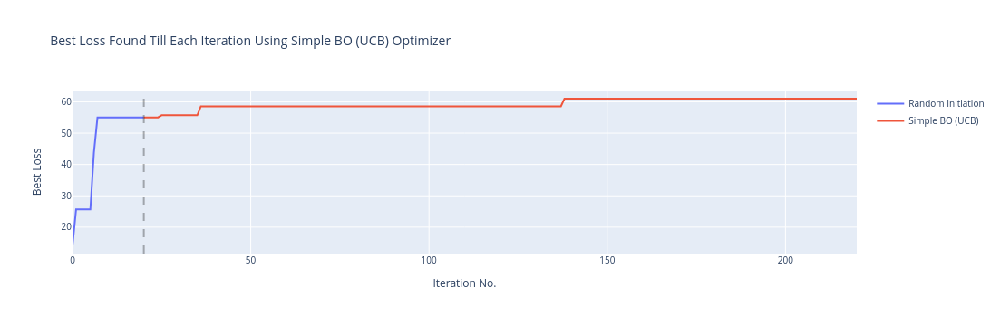

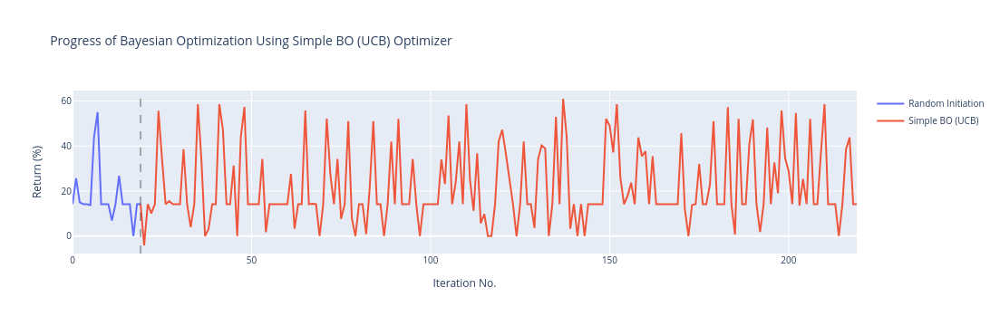

In [4]:
plot_optimization_progress(optimizer, init_set)

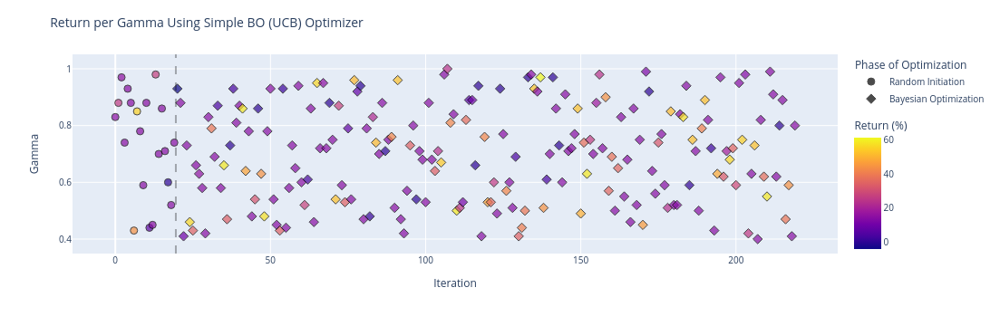

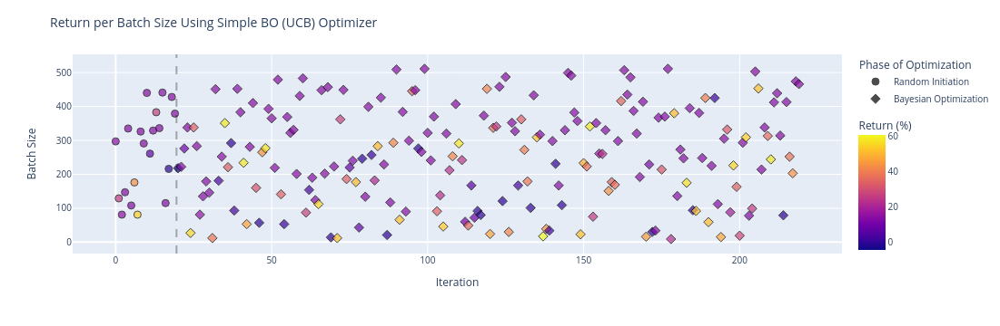

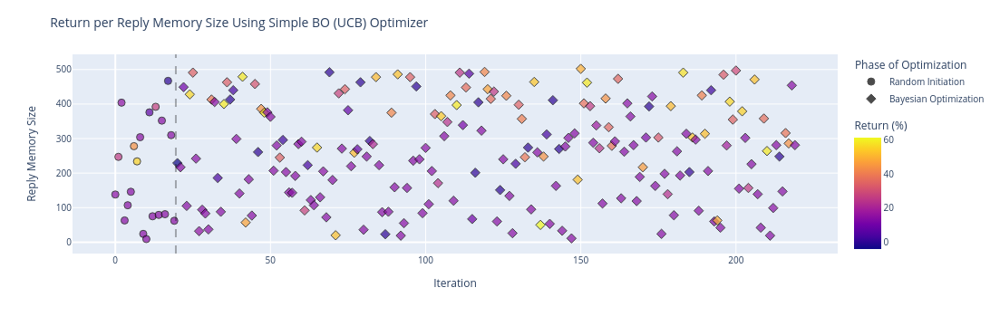

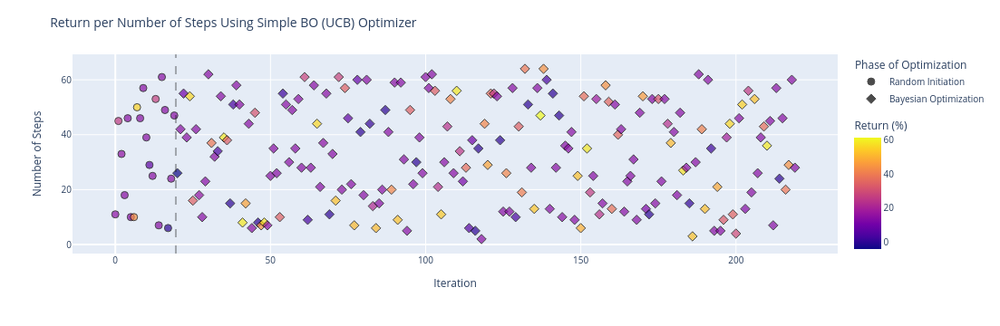

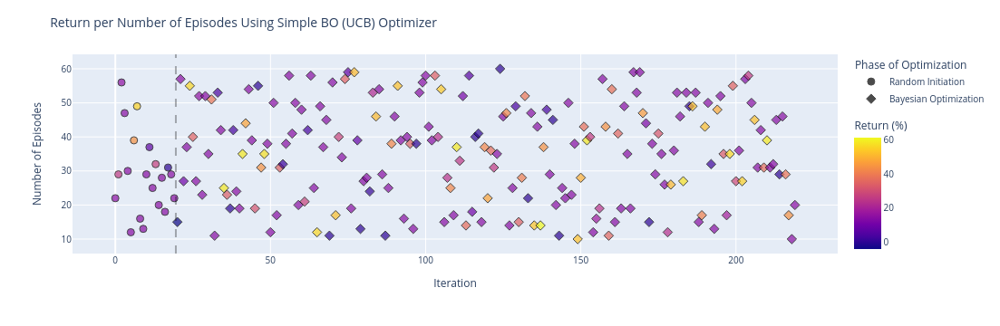

In [5]:
plot_hyperparams(params, optimizer, init_set)

In [6]:
# Imports Optimizer
from Optimizer.SimpleBayesianOptimizer import SimpleBayesianOptimizer
set_random_seed(42)

In [7]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='Simple BO (EI)',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    # optimizer = load_pkl('run/Simple BO/DQN-pattern/optimizer.pkl')

    optimizer = SimpleBayesianOptimizer(objective_func, bounds, types, name='Simple BO (EI)')
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set, acquisition_func='EI')

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:09<00:00,  2.23it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:15<00:00,  4.66s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:01<00:00,  4.32s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.66it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.86it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:54<00:00,  4.56s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:22<00:00,  5.20s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:27<00:00,  4.23s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.66it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  3.07it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.80it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:34<00:00,  5.79s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.69it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:22<00:00,  6.32s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.77it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.81it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.96it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:48<00:00,  5.43s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.61it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.87it/s]


Complete


0it [00:00, ?it/s]

tensor([  0.9512, 142.4240, 296.5804,  11.7505,  23.0569])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:19<00:00,  6.07s/it]


Complete


1it [02:20, 140.74s/it]

tensor([  0.5177, 137.4927, 392.5331,  27.1632,  16.3346])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:18<00:00,  4.90s/it]


Complete


2it [03:40, 105.03s/it]

tensor([  0.6614, 259.1232, 165.9447,  33.6714,  32.0419])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:11<00:00,  2.83it/s]


Complete


3it [03:53, 62.81s/it] 

tensor([  0.5912, 316.4162, 388.2146,  30.5401,  29.9155])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [03:06<00:00,  6.21s/it]


Complete


4it [07:00, 111.93s/it]

tensor([  0.9094, 258.6431,  37.8467,  43.8165,  49.2721])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:17<00:00,  2.73it/s]


Complete


5it [07:19, 78.43s/it] 

tensor([  0.7654, 238.5031, 434.6975,  50.2764,  37.2854])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:24<00:00,  5.52s/it]


Complete


6it [10:44, 121.59s/it]

tensor([  0.9763, 500.8518, 464.5989,  40.7891,  14.7193])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.84it/s]


Complete


7it [10:51, 83.84s/it] 

tensor([4.2875e-01, 5.0357e+02, 1.6294e+02, 1.1094e+01, 5.4507e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:25<00:00,  2.12it/s]


Complete


8it [11:17, 65.67s/it]

tensor([  0.8469,  34.7211, 219.6056,  22.0246,  35.7358])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [02:31<00:00,  4.20s/it]


Complete


9it [13:50, 92.80s/it]

tensor([  0.5181,  44.1795, 327.6841,  49.2824,  16.8929])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:09<00:00,  4.10s/it]


Complete


10it [15:00, 85.93s/it]

tensor([  0.8276,  93.3628, 427.6402,  41.9197,  38.4460])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [02:50<00:00,  4.49s/it]


Complete


11it [17:52, 112.16s/it]

tensor([  0.9734, 325.4547, 261.4149,  45.3594,  56.9274])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:20<00:00,  2.77it/s]


Complete


12it [18:13, 84.57s/it] 

tensor([ 0.8520, 14.2064, 80.6292, 25.5284, 45.0670])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [02:57<00:00,  3.95s/it]


Complete


13it [21:12, 113.16s/it]

tensor([  0.8960, 341.1199, 500.8411,   2.8502,  45.3017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [05:13<00:00,  6.97s/it]


Complete


14it [26:27, 174.03s/it]

tensor([  0.7590, 236.2517,  35.4306,  57.1113,  13.0726])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.74it/s]


Complete


15it [26:33, 123.27s/it]

tensor([  0.8071,  24.9341, 449.4488,  27.0145,  26.6904])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [01:47<00:00,  3.98s/it]


Complete


16it [28:21, 118.81s/it]

tensor([  0.5127, 472.6177, 497.4879,  23.8179,  30.4312])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [03:36<00:00,  7.21s/it]


Complete


17it [31:59, 148.43s/it]

tensor([  0.6038, 278.7095, 167.4339,  38.7778,  33.1574])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:14<00:00,  2.20it/s]


Complete


18it [32:14, 108.64s/it]

tensor([  0.5943, 429.1784, 132.0423,  31.3806,  40.4444])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.77it/s]


Complete


19it [32:30, 80.62s/it] 

tensor([  0.9050, 238.4405, 430.3717,  35.1330,  52.2417])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:53<00:00,  5.64s/it]


Complete


20it [37:24, 144.72s/it]

tensor([  0.8408, 424.3505, 262.7398,  63.8307,  51.0509])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:19<00:00,  2.67it/s]


Complete


21it [37:44, 107.24s/it]

tensor([  0.6419, 338.6837, 440.5180,  38.2695,  21.3699])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [02:12<00:00,  6.30s/it]


Complete


22it [39:57, 115.07s/it]

tensor([  0.7353, 433.7798, 147.7696,  53.4287,  31.6900])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:10<00:00,  2.98it/s]


Complete


23it [40:09, 84.02s/it] 

tensor([  0.7406, 393.0770,  61.0160,  32.6821,  40.4631])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.85it/s]


Complete


24it [40:24, 63.26s/it]

tensor([  0.7560, 462.4574, 385.8119,   7.9194,  40.3876])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.70it/s]


Complete


25it [40:39, 49.01s/it]

tensor([  0.7665, 460.3197, 373.9208,  55.8538,  13.8269])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:04<00:00,  3.01it/s]


Complete


26it [40:45, 35.94s/it]

tensor([  0.7013,  77.7237, 101.8748,  37.1898,  33.8434])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:34<00:00,  4.56s/it]


Complete


27it [43:21, 71.88s/it]

tensor([  0.8353, 162.1450, 374.6669,   5.2049,  18.2248])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:32<00:00,  5.15s/it]


Complete


28it [44:54, 78.36s/it]

tensor([  0.8803, 258.5544, 386.9586,  50.7452,  52.7503])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [05:01<00:00,  5.69s/it]


Complete


29it [49:57, 145.61s/it]

tensor([  0.9761, 212.2705,  47.0022,  63.8015,  59.5615])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:23<00:00,  2.55it/s]


Complete


30it [50:21, 109.26s/it]

tensor([  0.9661, 294.6327, 276.1146,  41.0450,  47.4798])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:18<00:00,  2.57it/s]


Complete


31it [50:40, 82.21s/it] 

tensor([  0.7200, 418.6971, 162.7326,  35.0420,  25.4142])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.93it/s]


Complete


32it [50:49, 60.36s/it]

tensor([  0.8158, 418.4844, 349.5609,  62.4290,  32.4534])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:13<00:00,  2.40it/s]


Complete


33it [51:04, 46.50s/it]

tensor([  0.8582, 141.4548, 127.7601,  25.6716,  45.0328])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:15<00:00,  2.84it/s]


Complete


34it [51:20, 37.57s/it]

tensor([  0.4786, 466.5910, 261.4955,  10.8576,  37.8171])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:13<00:00,  2.79it/s]


Complete


35it [51:35, 30.62s/it]

tensor([  0.9173, 103.5479, 455.0680,  15.9483,  49.7472])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [04:07<00:00,  4.96s/it]


Complete


36it [55:43, 96.06s/it]

tensor([  0.7726, 316.5258, 329.8409,  18.1493,  17.8007])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:49<00:00,  6.11s/it]


Complete


37it [57:34, 100.54s/it]

tensor([  0.5676, 236.8890, 246.7895,   3.1454,  42.5222])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:16<00:00,  5.98s/it]


Complete


38it [1:01:52, 147.70s/it]

tensor([  0.6411,  61.3692, 198.5465,  21.4274,  40.4008])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [02:53<00:00,  4.34s/it]


Complete


39it [1:04:47, 155.73s/it]

tensor([  0.9453, 436.1351, 337.2869,  11.6964,  26.8692])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:11<00:00,  2.32it/s]


Complete


40it [1:04:59, 112.75s/it]

tensor([  0.7886, 295.7142, 195.0404,  61.1091,  56.2594])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.58it/s]


Complete


41it [1:05:22, 85.73s/it] 

tensor([  0.4195,  26.5643, 288.8278,  39.0568,  20.1325])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:21<00:00,  4.05s/it]


Complete


42it [1:06:44, 84.61s/it]

tensor([  0.5407,  60.3038, 396.4661,   4.9040,  44.4566])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:18<00:00,  4.51s/it]


Complete


43it [1:10:03, 119.04s/it]

tensor([  0.9664, 184.6659,  72.3151,  43.0041,  34.3930])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:16<00:00,  2.08it/s]


Complete


44it [1:10:20, 88.51s/it] 

tensor([  0.9086, 370.1116, 157.0679,  21.2147,  55.2689])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:22<00:00,  2.50it/s]


Complete


45it [1:10:43, 68.81s/it]

tensor([  0.7217, 511.1212, 293.6811,  26.5134,  44.6047])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:17<00:00,  2.53it/s]


Complete


46it [1:11:02, 53.82s/it]

tensor([  0.9592, 416.7238,  30.1323,  38.8700,  54.6630])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:19<00:00,  2.79it/s]


Complete


47it [1:11:23, 43.88s/it]

tensor([  0.4919, 396.1546, 378.9929,  38.4213,  35.2410])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.76it/s]


Complete


48it [1:11:37, 34.82s/it]

tensor([  0.4637, 245.5653, 147.4710,  57.2245,  25.2833])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:10<00:00,  2.40it/s]


Complete


49it [1:11:48, 27.80s/it]

tensor([  0.6750, 488.1708, 341.9478,  18.4408,  21.0333])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:09<00:00,  2.21it/s]


Complete


50it [1:11:58, 22.55s/it]

tensor([  0.7113, 313.8479, 429.4491,  26.8265,  34.0225])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [03:39<00:00,  6.45s/it]


Complete


51it [1:15:39, 81.88s/it]

tensor([  0.7789, 184.8536,  35.1678,  10.9599,  26.9593])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:10<00:00,  2.53it/s]


Complete


52it [1:15:50, 60.82s/it]

tensor([  0.6283,  19.8194, 132.3813,  12.4283,  29.7875])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:07<00:00,  4.24s/it]


Complete


53it [1:17:58, 81.02s/it]

tensor([  0.5581, 359.8556, 511.8836,  13.1219,  47.9078])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [05:15<00:00,  6.57s/it]


Complete


54it [1:23:15, 151.64s/it]

tensor([  0.7646, 301.8587, 133.9808,  17.0007,  44.2799])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.56it/s]


Complete


55it [1:23:33, 111.55s/it]

tensor([  0.9809, 292.9583, 289.0562,  19.5821,  40.4917])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.81it/s]


Complete


56it [1:23:48, 82.60s/it] 

tensor([  0.9843, 175.2165, 305.3177,  43.6484,  41.0711])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:37<00:00,  5.30s/it]


Complete


57it [1:27:26, 123.33s/it]

tensor([  0.5494, 316.8979, 488.1504,  59.4468,  42.5825])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:17<00:00,  5.98s/it]


Complete


58it [1:31:44, 163.77s/it]

tensor([  0.9270, 268.9431, 488.5790,  14.9051,  24.9073])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:27<00:00,  5.89s/it]


Complete


59it [1:34:12, 159.07s/it]

tensor([  0.5700,  28.5660, 235.5172,  45.8485,  16.2400])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:03<00:00,  3.97s/it]


Complete


60it [1:35:17, 130.68s/it]

tensor([  0.8086, 375.0652, 131.9274,  39.8271,  35.8767])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:15<00:00,  2.33it/s]


Complete


61it [1:35:33, 96.33s/it] 

tensor([  0.5234, 210.3330, 470.2300,  59.3168,  21.0888])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:51<00:00,  5.31s/it]


Complete


62it [1:37:25, 101.14s/it]

tensor([  0.4081, 263.2849,  95.6027,  27.1808,  22.1106])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:09<00:00,  2.29it/s]


Complete


63it [1:37:36, 73.95s/it] 

tensor([  0.9908, 137.8810,  78.2731,  10.9523,  24.3672])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.73it/s]


Complete


64it [1:37:46, 54.66s/it]

tensor([  0.8830, 370.4758, 121.9658,  35.6714,  54.7513])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:20<00:00,  2.74it/s]


Complete


65it [1:38:07, 44.53s/it]

tensor([  0.9265, 288.7064, 431.6306,  53.5341,  45.0771])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:25<00:00,  5.90s/it]


Complete


66it [1:42:34, 111.55s/it]

tensor([  0.5916, 158.0946,  18.9108,  31.0794,  42.2622])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:15<00:00,  2.77it/s]


Complete


67it [1:42:51, 82.93s/it] 

tensor([  0.5090, 247.3461, 449.2111,  20.8104,  26.5117])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:35<00:00,  5.78s/it]


Complete


68it [1:45:28, 105.19s/it]

tensor([  0.5617, 275.1960,  35.3256,  31.8436,  15.5020])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.99it/s]


Complete


69it [1:45:34, 75.54s/it] 

tensor([  0.5706, 311.4016,  72.2350,  36.2865,  38.9056])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.90it/s]


Complete


70it [1:45:48, 57.19s/it]

tensor([  0.7792, 472.5168, 183.8404,  39.7206,  17.5028])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.49it/s]


Complete


71it [1:45:57, 42.47s/it]

tensor([  0.9661, 101.4132, 252.5281,  24.7205,  16.6692])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:19<00:00,  4.65s/it]


Complete


72it [1:47:16, 53.66s/it]

tensor([  0.5803,  87.1558, 285.0672,  41.1878,  23.0244])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [01:41<00:00,  4.43s/it]


Complete


73it [1:48:59, 68.40s/it]

tensor([4.0717e-01, 3.6193e+02, 4.4914e+02, 2.0002e+01, 1.0346e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [01:03<00:00,  6.38s/it]


Complete


74it [1:50:04, 67.31s/it]

tensor([  0.7824, 284.5858, 252.2207,  34.5253,  20.8034])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:07<00:00,  2.94it/s]


Complete


75it [1:50:12, 49.55s/it]

tensor([  0.7246, 187.8415, 308.9434,  54.7736,  20.5598])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:48<00:00,  5.15s/it]


Complete


76it [1:52:01, 67.35s/it]

tensor([  0.7626, 314.2495, 236.6976,  28.1134,  37.3767])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:14<00:00,  2.63it/s]


Complete


77it [1:52:16, 51.62s/it]

tensor([  0.7710, 439.7271,  75.5890,  42.5084,  58.2460])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:22<00:00,  2.52it/s]


Complete


78it [1:52:40, 43.33s/it]

tensor([  0.8623,  68.3143, 215.4686,  57.0574,  42.1894])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:07<00:00,  4.46s/it]


Complete


79it [1:55:48, 86.76s/it]

tensor([  0.4401, 432.6558,  18.6094,  34.1902,  48.2982])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:21<00:00,  2.23it/s]


Complete


80it [1:56:10, 67.43s/it]

tensor([  0.4100, 362.6900,  24.8772,  11.3046,  10.8144])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.40it/s]


Complete


81it [1:56:16, 48.88s/it]

tensor([  0.8309, 380.7323, 161.7520,  54.8850,  22.5542])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:09<00:00,  2.50it/s]


Complete


82it [1:56:26, 37.22s/it]

tensor([  0.7138, 290.3164,  46.2160,  62.4881,  24.7539])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.98it/s]


Complete


83it [1:56:35, 28.87s/it]

tensor([  0.6017, 403.7787, 321.7936,  51.4710,  16.0583])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.62it/s]


Complete


84it [1:56:42, 22.32s/it]

tensor([  0.6976,  48.1170, 236.0834,  63.4464,  59.2277])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [04:09<00:00,  4.24s/it]


Complete


85it [2:00:53, 90.92s/it]

tensor([  0.7867, 360.8481, 165.0158,   7.9374,  34.8063])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:13<00:00,  2.57it/s]


Complete


86it [2:01:08, 68.01s/it]

tensor([  0.7878, 453.9215, 297.3226,   3.3096,  38.1138])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:13<00:00,  2.74it/s]


Complete


87it [2:01:24, 52.34s/it]

tensor([  0.9041, 223.9987, 418.9671,  36.7941,  56.8373])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [05:14<00:00,  5.52s/it]


Complete


88it [2:06:40, 131.58s/it]

tensor([  0.9550, 422.9886, 276.1723,  29.0658,  42.4571])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:16<00:00,  2.51it/s]


Complete


89it [2:06:58, 97.39s/it] 

tensor([  0.8452, 356.3513, 243.4402,  57.9822,  39.3672])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.89it/s]


Complete


90it [2:07:12, 72.53s/it]

tensor([  0.9668, 506.9592, 315.4767,  26.3498,  30.5131])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:12<00:00,  2.49it/s]


Complete


91it [2:07:26, 54.79s/it]

tensor([  0.9675,  37.3321, 420.8078,   2.1299,  12.4561])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:52<00:00,  4.34s/it]


Complete


92it [2:08:19, 54.23s/it]

tensor([  0.7801, 223.0287, 320.5612,  23.8100,  36.7542])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:25<00:00,  5.56s/it]


Complete


93it [2:11:45, 100.00s/it]

tensor([  0.9763, 207.0793, 300.3643,  17.9165,  18.8899])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:42<00:00,  5.42s/it]


Complete


94it [2:13:29, 101.24s/it]

tensor([  0.9220, 453.7759, 199.6674,   5.3720,  25.9484])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:11<00:00,  2.36it/s]


Complete


95it [2:13:41, 74.43s/it] 

tensor([  0.9907, 140.4230, 396.1032,   8.3761,  49.2762])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:07<00:00,  5.06s/it]


Complete


96it [2:17:50, 126.76s/it]

tensor([  0.6156, 488.4843,  96.0565,   2.0465,  13.6162])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.65it/s]


Complete


97it [2:17:56, 90.60s/it] 

tensor([  0.8606, 281.5034,  88.2872,  36.3467,  35.7262])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:13<00:00,  2.67it/s]


Complete


98it [2:18:11, 67.78s/it]

tensor([  0.9485,  64.4075, 331.6855,  12.5626,  43.7124])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:21<00:00,  4.58s/it]


Complete


99it [2:21:33, 108.17s/it]

tensor([  0.7202, 494.9771, 379.2360,  35.0621,  41.5575])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:15<00:00,  2.63it/s]


Complete


100it [2:21:50, 80.82s/it]

tensor([  0.5545, 469.3885, 234.7807,  49.7824,  53.7811])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:20<00:00,  2.60it/s]


Complete


101it [2:22:12, 63.08s/it]

tensor([  0.4962, 399.9896, 369.0212,  59.2207,  31.5267])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:10<00:00,  2.95it/s]


Complete


102it [2:22:24, 47.69s/it]

tensor([  0.5209,  81.0248, 111.4643,  29.5486,  59.3439])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [04:40<00:00,  4.76s/it]


Complete


103it [2:27:06, 117.89s/it]

tensor([ 0.7566, 12.4142, 98.3897, 33.9790, 38.2621])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [02:28<00:00,  3.90s/it]


Complete


104it [2:29:35, 127.31s/it]

tensor([  0.5160, 334.9676, 163.9001,  37.5709,  15.7971])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.68it/s]


Complete


105it [2:29:42, 91.18s/it] 

tensor([  0.4174, 302.2028, 262.0474,  35.7421,  51.8251])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:19<00:00,  2.68it/s]


Complete


106it [2:30:02, 69.94s/it]

tensor([  0.8769, 463.9203, 499.1331,  31.9626,  21.7365])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [02:41<00:00,  7.32s/it]


Complete


107it [2:32:44, 97.57s/it]

tensor([  0.9628, 475.4380,  20.1102,  52.6108,  58.7902])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:20<00:00,  2.92it/s]


Complete


108it [2:33:05, 74.67s/it]

tensor([  0.4739, 391.7299,  78.6305,  49.8538,  13.4621])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:05<00:00,  2.34it/s]


Complete


109it [2:33:12, 54.23s/it]

tensor([  0.5770, 399.9995,  95.1656,   6.4441,  22.5721])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:08<00:00,  2.84it/s]


Complete


110it [2:33:21, 40.66s/it]

tensor([  0.6199,  95.2406, 419.3712,   5.9549,  52.4389])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:05<00:00,  4.72s/it]


Complete


111it [2:37:27, 102.39s/it]

tensor([4.2535e-01, 4.8192e+02, 1.5331e+02, 4.4625e+01, 2.2997e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:10<00:00,  2.26it/s]


Complete


112it [2:37:38, 75.03s/it] 

tensor([  0.6743, 434.7947, 411.2644,  16.2268,  23.4123])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:09<00:00,  2.42it/s]


Complete


113it [2:37:49, 55.64s/it]

tensor([  0.4322, 195.6938,  32.8438,  46.0208,  20.6283])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:08<00:00,  2.53it/s]


Complete


114it [2:37:58, 41.72s/it]

tensor([  0.7478, 351.0383,  69.3941,  56.3308,  44.3120])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:16<00:00,  2.60it/s]


Complete


115it [2:38:16, 34.60s/it]

tensor([  0.5450, 330.3079, 342.1185,  17.2372,  42.6550])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:43<00:00,  6.59s/it]


Complete


116it [2:43:00, 109.48s/it]

tensor([  0.4508, 381.5100, 427.3473,  17.7939,  30.4732])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [03:20<00:00,  6.68s/it]


Complete


117it [2:46:22, 137.14s/it]

tensor([  0.6452,  53.8535, 138.3558,  38.4185,  19.0417])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:19<00:00,  4.20s/it]


Complete


118it [2:47:43, 120.20s/it]

tensor([  0.7979, 397.4857,  17.7008,  54.7839,  49.0803])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.55it/s]


Complete


119it [2:48:03, 90.20s/it] 

tensor([  0.5905, 315.5927, 313.6537,  51.7730,  49.6140])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:19<00:00,  2.52it/s]


Complete


120it [2:48:24, 69.50s/it]

tensor([  0.7504, 404.9450, 245.1357,  14.1106,  46.3368])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:17<00:00,  2.64it/s]


Complete


121it [2:48:43, 54.20s/it]

tensor([  0.7421, 500.6622, 136.5107,  18.7403,  34.2005])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:11<00:00,  2.86it/s]


Complete


122it [2:48:55, 41.82s/it]

tensor([  0.6865, 262.5146, 292.7520,  39.2134,  42.0713])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [04:11<00:00,  5.98s/it]


Complete


123it [2:53:08, 104.93s/it]

tensor([  0.5899, 464.3405,  58.2888,  24.4622,  41.5066])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:16<00:00,  2.61it/s]


Complete


124it [2:53:25, 78.57s/it] 

tensor([  0.6814,  60.3999, 466.9492,  45.5490,  59.7692])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [04:16<00:00,  4.27s/it]


Complete


125it [2:57:42, 132.19s/it]

tensor([  0.9003, 247.5777, 500.6916,   9.1720,  13.0136])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:14<00:00,  5.73s/it]


Complete


126it [2:58:58, 115.23s/it]

tensor([  0.8800, 465.2604, 326.5961,  54.5307,  11.8837])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.75it/s]


Complete


127it [2:59:03, 82.28s/it] 

tensor([4.5420e-01, 1.4958e+02, 4.6199e+02, 4.0896e+01, 3.5018e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [02:53<00:00,  4.96s/it]


Complete


128it [3:01:58, 110.03s/it]

tensor([  0.9781, 448.6077, 295.1340,  18.2084,  10.4164])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:04<00:00,  2.44it/s]


Complete


129it [3:02:03, 78.57s/it] 

tensor([  0.8394,  29.5411, 382.5160,  55.1799,  24.7373])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [01:38<00:00,  3.95s/it]


Complete


130it [3:03:43, 84.99s/it]

tensor([4.0826e-01, 3.2965e+02, 4.2505e+02, 3.4788e+01, 2.4179e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:32<00:00,  6.34s/it]


Complete


131it [3:06:16, 105.45s/it]

tensor([  0.5436, 226.3396, 399.7808,  14.1588,  42.3804])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:56<00:00,  5.63s/it]


Complete


132it [3:10:14, 145.06s/it]

tensor([  0.5322, 153.3412, 475.7089,  14.5338,  13.0443])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:06<00:00,  5.08s/it]


Complete


133it [3:11:21, 121.68s/it]

tensor([  0.4578, 355.4354, 264.1176,  26.1637,  24.3893])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:10<00:00,  2.29it/s]


Complete


134it [3:11:32, 88.61s/it] 

tensor([  0.5889, 435.0658,  59.2819,  39.2757,  13.2223])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.97it/s]


Complete


135it [3:11:38, 63.65s/it]

tensor([  0.8367, 471.4303, 340.7522,  27.5848,  46.0141])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:17<00:00,  2.63it/s]


Complete


136it [3:11:56, 50.12s/it]

tensor([ 0.5722, 33.6011, 75.5433,  5.9450, 53.9179])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [03:47<00:00,  4.21s/it]


Complete


137it [3:15:45, 103.60s/it]

tensor([  0.4431, 259.7738, 173.7403,  57.6528,  28.0618])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.57it/s]


Complete


138it [3:15:57, 76.11s/it] 

tensor([4.5022e-01, 3.2751e+02, 4.7560e+02, 4.2565e+01, 5.9796e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [06:21<00:00,  6.36s/it]


Complete


139it [3:22:20, 168.18s/it]

tensor([  0.5124, 462.4316,  26.5795,  37.4360,  47.3406])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:19<00:00,  2.41it/s]


Complete


140it [3:22:40, 123.90s/it]

tensor([  0.9457, 213.8534, 295.8939,  44.3714,  30.9755])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:48<00:00,  5.43s/it]


Complete


141it [3:25:29, 137.48s/it]

tensor([  0.8610, 312.4615, 487.0235,   4.3830,  31.4209])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:25<00:00,  6.63s/it]


Complete


142it [3:28:56, 158.28s/it]

tensor([  0.7761, 376.4796, 478.0716,  31.0079,  18.9840])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [02:02<00:00,  6.46s/it]


Complete


143it [3:31:00, 148.01s/it]

tensor([  0.6622, 106.0077,  24.7657,  42.2678,  47.8455])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:21<00:00,  2.27it/s]


Complete


144it [3:31:23, 110.34s/it]

tensor([  0.7627, 140.9483,  55.7125,   4.5672,  17.1360])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:07<00:00,  2.33it/s]


Complete


145it [3:31:31, 79.75s/it] 

tensor([  0.5499, 106.3118, 405.4987,  30.0417,  20.5339])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:44<00:00,  4.97s/it]


Complete


146it [3:33:16, 87.43s/it]

tensor([  0.4851, 317.8372,  29.4496,  28.8386,  41.5526])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:17<00:00,  2.39it/s]


Complete


147it [3:33:35, 66.82s/it]

tensor([  0.5163, 459.6701, 182.2827,  35.3439,  53.1854])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:19<00:00,  2.72it/s]


Complete


148it [3:33:56, 52.96s/it]

tensor([  0.5991, 272.1494, 174.6011,  24.7231,  51.6071])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:19<00:00,  2.64it/s]


Complete


149it [3:34:17, 43.32s/it]

tensor([  0.4277, 181.6903, 389.4801,  55.8600,  43.9108])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:51<00:00,  5.25s/it]


Complete


150it [3:38:09, 100.00s/it]

tensor([  0.8064, 389.1319, 254.3957,  61.4591,  23.6610])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:09<00:00,  2.55it/s]


Complete


151it [3:38:20, 73.23s/it] 

tensor([ 0.8808, 47.0945, 10.4648, 51.4349, 34.5585])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.80it/s]


Complete


152it [3:38:33, 55.37s/it]

tensor([4.0538e-01, 4.2395e+02, 4.8685e+02, 6.2809e+01, 4.5647e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [05:10<00:00,  6.75s/it]


Complete


153it [3:43:45, 132.23s/it]

tensor([  0.4303, 217.4883, 216.5656,  20.6129,  18.1653])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:38<00:00,  5.46s/it]


Complete


154it [3:45:24, 122.40s/it]

tensor([  0.8011, 299.4363,  41.6072,  60.2425,  28.2938])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:11<00:00,  2.50it/s]


Complete


155it [3:45:37, 89.37s/it] 

tensor([  0.9958, 155.3508,  19.7303,  42.4746,  48.7898])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:20<00:00,  2.36it/s]


Complete


156it [3:45:59, 69.14s/it]

tensor([  0.8272, 363.2826, 432.3198,  55.9231,  57.5424])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [06:10<00:00,  6.39s/it]


Complete


157it [3:52:10, 159.94s/it]

tensor([  0.6559,  40.2779, 390.3065,  61.3197,  45.3464])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:06<00:00,  4.14s/it]


Complete


158it [3:55:18, 168.15s/it]

tensor([  0.8018, 249.7908, 229.5911,  46.4795,  53.7653])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:25<00:00,  2.16it/s]


Complete


159it [3:55:44, 125.54s/it]

tensor([  0.7920, 457.3432, 468.6169,  40.2187,  10.1126])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [01:09<00:00,  6.91s/it]


Complete


160it [3:56:54, 108.96s/it]

tensor([  0.7622, 263.8727, 104.1251,  33.6753,  47.7637])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:16<00:00,  2.87it/s]


Complete


161it [3:57:12, 81.66s/it] 

tensor([  0.7038,   8.2484, 498.8012,  41.8424,  33.5991])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:11<00:00,  3.86s/it]


Complete


162it [3:59:25, 96.96s/it]

tensor([ 0.9579, 95.4217, 66.8808, 20.0495, 23.8188])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.71it/s]


Complete


163it [3:59:35, 70.85s/it]

tensor([  0.9028, 413.3954, 342.5848,  60.8639,  43.0483])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:14<00:00,  3.00it/s]


Complete


164it [3:59:50, 54.22s/it]

tensor([  0.4885,  72.6271, 302.6745,  42.8010,  16.8853])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:19<00:00,  4.67s/it]


Complete


165it [4:01:10, 62.09s/it]

tensor([  0.5065, 283.2090, 486.1373,  26.6163,  44.3332])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [04:20<00:00,  5.91s/it]


Complete


166it [4:05:32, 121.85s/it]

tensor([  0.5585, 243.0692,  55.1699,  50.8300,  36.0546])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:14<00:00,  2.47it/s]


Complete


167it [4:05:47, 90.02s/it] 

tensor([  0.6165, 352.1204, 284.8572,  23.2336,  10.5903])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:05<00:00,  2.12it/s]


Complete


168it [4:05:54, 64.89s/it]

tensor([  0.5140, 342.8423,  17.7177,  44.7150,  37.8175])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:14<00:00,  2.59it/s]


Complete


169it [4:06:09, 50.15s/it]

tensor([  0.6697, 215.3432, 387.7363,  36.7490,  25.3671])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:20<00:00,  5.62s/it]


Complete


170it [4:08:31, 77.61s/it]

tensor([  0.5443, 332.2059, 326.3947,  12.9745,  40.8361])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:17<00:00,  2.40it/s]


Complete


171it [4:08:50, 59.83s/it]

tensor([  0.6098, 293.4745, 415.4709,  53.4521,  20.1648])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:57<00:00,  5.88s/it]


Complete


172it [4:10:48, 77.52s/it]

tensor([  0.6540,  29.4324, 361.6968,  17.5012,  24.7034])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [01:44<00:00,  4.16s/it]


Complete


173it [4:12:34, 85.85s/it]

tensor([  0.7745, 371.2128, 129.2912,  28.5835,  45.9473])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:18<00:00,  2.46it/s]


Complete


174it [4:12:53, 66.05s/it]

tensor([  0.5728, 309.2722, 388.4338,  17.1333,  25.4748])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:37<00:00,  6.31s/it]


Complete


175it [4:15:32, 93.91s/it]

tensor([  0.4153,  79.4919, 107.1615,  15.9269,  22.8185])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [01:43<00:00,  4.48s/it]


Complete


176it [4:17:17, 97.06s/it]

tensor([  0.5113, 390.5720, 500.0479,  14.2842,  53.8519])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [06:09<00:00,  6.84s/it]


Complete


177it [4:23:27, 179.08s/it]

tensor([  0.7126,  54.1250, 189.3262,  43.3980,  43.5870])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:04<00:00,  4.20s/it]


Complete


178it [4:26:34, 181.25s/it]

tensor([  0.4268, 144.6848,  82.7319,  47.4036,  51.3001])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:17<00:00,  2.89it/s]


Complete


179it [4:26:53, 132.55s/it]

tensor([  0.4055, 376.4084, 206.3480,  20.4276,  10.7607])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:03<00:00,  2.81it/s]


Complete


180it [4:26:58, 94.33s/it] 

tensor([  0.6771, 187.9059,  69.3803,  11.0652,  50.3401])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.84it/s]


Complete


181it [4:27:17, 71.70s/it]

tensor([  0.7728, 326.0799, 352.1630,  25.8994,  44.1325])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [04:44<00:00,  6.47s/it]


Complete


182it [4:32:02, 135.91s/it]

tensor([  0.7695, 323.9413, 139.5889,  43.2497,  53.6129])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:21<00:00,  2.49it/s]


Complete


183it [4:32:25, 101.95s/it]

tensor([  0.6843,  63.0695, 179.5534,  32.8076,  58.8696])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [04:19<00:00,  4.39s/it]


Complete


184it [4:36:45, 149.41s/it]

tensor([  0.8847,  28.4619, 429.5423,  23.8481,  59.5592])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [04:08<00:00,  4.14s/it]


Complete


185it [4:40:55, 179.46s/it]

tensor([  0.4616, 144.6453,  18.9572,  42.9365,  28.5553])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.30it/s]


Complete


186it [4:41:08, 129.76s/it]

tensor([  0.9195, 150.6262, 481.5681,   5.0777,  48.1937])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [04:08<00:00,  5.18s/it]


Complete


187it [4:45:19, 165.84s/it]

tensor([  0.8268, 470.4937,   9.5504,  28.6547,  18.8258])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:06<00:00,  2.92it/s]


Complete


188it [4:45:26, 118.45s/it]

tensor([  0.6768, 494.1539,  11.2753,  10.0602,  22.3417])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:09<00:00,  2.39it/s]


Complete


189it [4:45:37, 86.01s/it] 

tensor([  0.7920, 341.8612, 227.2904,  25.6464,  44.0793])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:21<00:00,  2.01it/s]


Complete


190it [4:46:00, 67.11s/it]

tensor([  0.6874, 114.6437, 158.1766,  12.2938,  26.6459])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:11<00:00,  4.88s/it]


Complete


191it [4:48:13, 86.94s/it]

tensor([  0.7227, 204.8313, 341.4383,  17.1612,  53.3534])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [04:55<00:00,  5.58s/it]


Complete


192it [4:53:10, 150.05s/it]

tensor([ 0.9815, 18.3608, 12.6011, 58.2276, 29.4683])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.53it/s]


Complete


193it [4:53:23, 108.92s/it]

tensor([  0.6508, 365.8012, 484.1413,  60.6184,  31.6876])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:23<00:00,  6.34s/it]


Complete


194it [4:56:47, 137.48s/it]

tensor([  0.9771, 287.4225, 261.1281,  42.3011,  54.3026])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:23<00:00,  2.34it/s]


Complete


195it [4:57:12, 103.58s/it]

tensor([  0.8055,  38.5442, 136.3433,  43.6592,  43.4376])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [02:55<00:00,  4.08s/it]


Complete


196it [5:00:09, 125.66s/it]

tensor([  0.9887, 411.1183, 281.7546,  49.4177,  51.5539])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:22<00:00,  2.34it/s]


Complete


197it [5:00:32, 94.96s/it] 

tensor([  0.5377,  32.7615, 427.0088,  23.8877,  12.4790])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:50<00:00,  4.22s/it]


Complete


198it [5:01:24, 81.99s/it]

tensor([  0.5327, 473.5326,  83.5026,  55.3411,  12.0321])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.28it/s]


Complete


199it [5:01:30, 59.33s/it]

tensor([  0.6715, 481.5311, 166.5734,  49.7466,  24.7379])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:10<00:00,  2.42it/s]


Complete


200it [5:01:42, 90.51s/it]


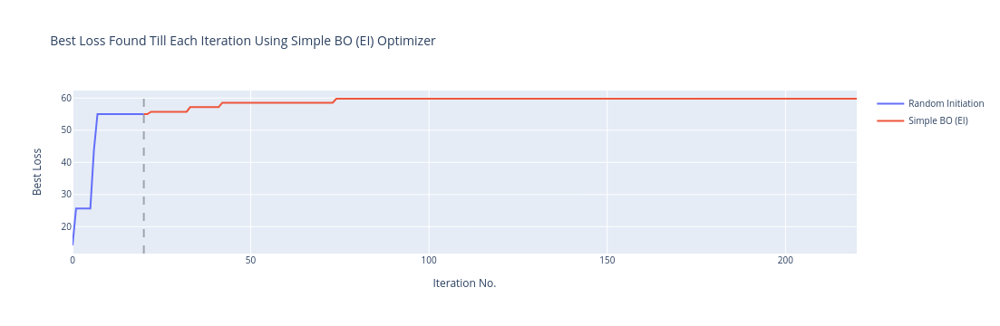

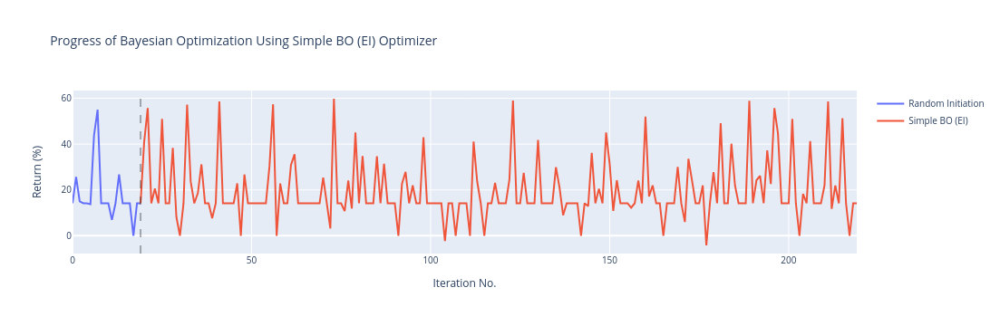

In [8]:
plot_optimization_progress(optimizer, init_set)

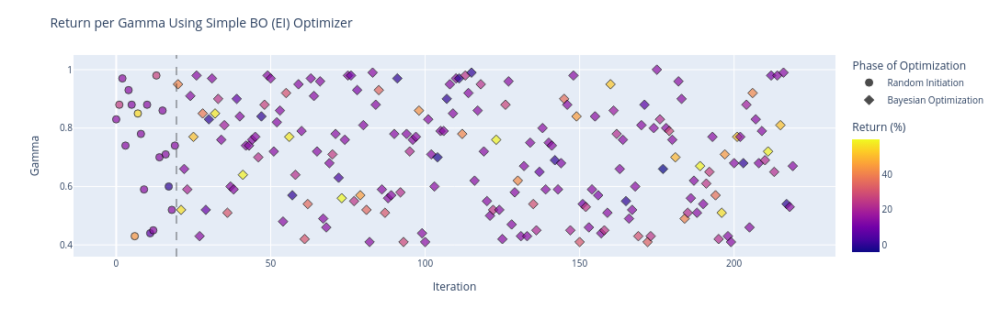

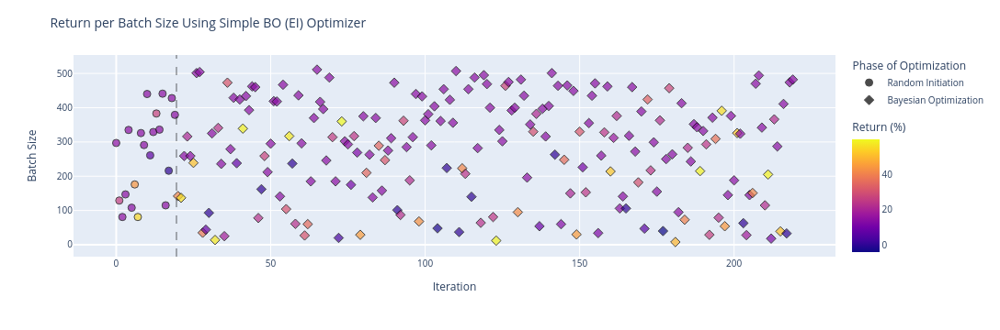

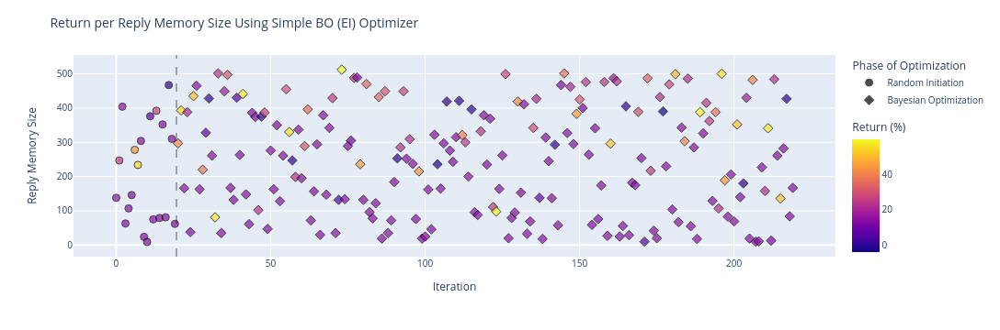

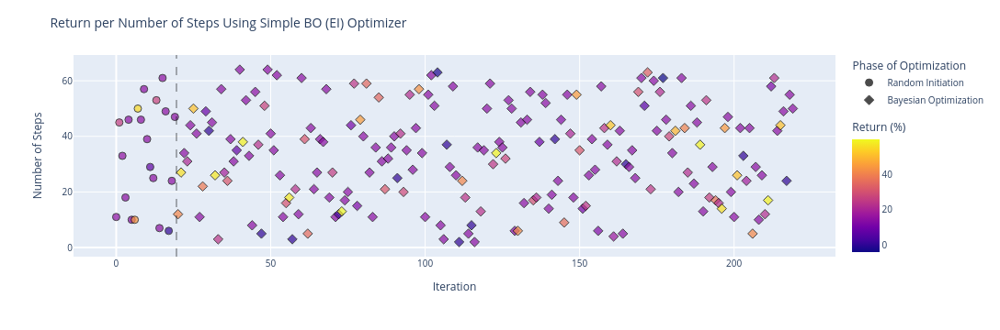

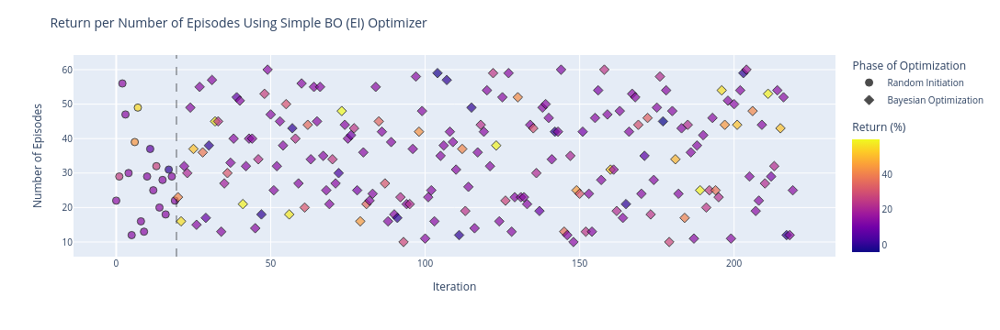

In [9]:
plot_hyperparams(params, optimizer, init_set)

In [10]:
# Imports Optimizer
from Optimizer.SimpleBayesianOptimizer import SimpleBayesianOptimizer
set_random_seed(42)

In [11]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='Simple BO (PI)',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    # optimizer = load_pkl('run/Simple BO/DQN-pattern/optimizer.pkl')

    optimizer = SimpleBayesianOptimizer(objective_func, bounds, types, name='Simple BO (PI)')
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set, acquisition_func='PI')

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.71it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:16<00:00,  4.70s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:04<00:00,  4.36s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.75it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.73it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:55<00:00,  4.59s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:22<00:00,  5.18s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:31<00:00,  4.31s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.93it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.75it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.73it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:34<00:00,  5.80s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.76it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:22<00:00,  6.34s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.80it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.82it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.83it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:49<00:00,  5.47s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.40it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.47it/s]


Complete


0it [00:00, ?it/s]

tensor([  0.7426, 402.9780, 103.8524,   4.5736,  57.6335])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:26<00:00,  2.20it/s]


Complete


1it [00:27, 27.34s/it]

tensor([  0.7683, 146.9046, 313.7815,  59.7214,  20.4939])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:38<00:00,  4.91s/it]


Complete


2it [02:06, 69.55s/it]

tensor([  0.6289, 279.2982,  33.6418,  28.8128,  12.7261])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.64it/s]


Complete


3it [02:12, 40.44s/it]

tensor([  0.6233, 157.8675, 276.1742,   7.6095,  43.5486])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:47<00:00,  5.18s/it]


Complete


4it [06:00, 114.76s/it]

tensor([  0.6831, 241.6994, 354.1592,  42.4411,  12.8744])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:12<00:00,  5.57s/it]


Complete


5it [07:14, 99.80s/it] 

tensor([  0.9767,  51.0881, 249.5106,  56.4876,  30.6926])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:07<00:00,  4.12s/it]


Complete


6it [09:22, 109.60s/it]

tensor([  0.4230, 139.4786, 144.5378,   3.5185,  59.7280])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [05:02<00:00,  5.04s/it]


Complete


7it [14:25, 172.80s/it]

tensor([  0.9291, 241.4552,  15.4867,  18.1260,  44.1842])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:16<00:00,  2.65it/s]


Complete


8it [14:43, 123.32s/it]

tensor([  0.5864, 422.2430,  27.1016,   4.0637,  24.2342])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:09<00:00,  2.44it/s]


Complete


9it [14:53, 88.08s/it] 

tensor([  0.8243,  72.2951, 132.7361,  21.4846,  27.3404])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:00<00:00,  4.45s/it]


Complete


10it [16:54, 98.25s/it]

tensor([  0.7324, 342.5618, 255.7111,  31.8044,  40.3992])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.71it/s]


Complete


11it [17:10, 72.93s/it]

tensor([  0.8456, 190.0859, 380.9922,  38.5864,  35.9977])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:10<00:00,  5.29s/it]


Complete


12it [20:21, 108.89s/it]

tensor([  0.9496,  30.5539, 480.5221,   3.4115,  45.6556])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [03:19<00:00,  4.34s/it]


Complete


13it [23:41, 136.56s/it]

tensor([  0.6947, 182.3770, 167.8187,  32.1914,  16.6022])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.60it/s]


Complete


14it [23:48, 97.53s/it] 

tensor([  0.7841, 182.5830, 468.6508,  14.1904,  48.7601])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:21<00:00,  5.33s/it]


Complete


15it [28:10, 147.10s/it]

tensor([  0.8845, 346.8567, 324.9120,  24.9218,  47.0773])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.70it/s]


Complete


16it [28:29, 108.35s/it]

tensor([  0.4560, 253.7242, 159.5125,  28.6339,  17.0102])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:05<00:00,  2.91it/s]


Complete


17it [28:35, 77.75s/it] 

tensor([  0.6565, 361.3073,  34.8048,   4.8822,  40.2585])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:16<00:00,  2.40it/s]


Complete


18it [28:53, 59.63s/it]

tensor([  0.7526, 510.2836,  87.6400,  50.0667,  10.8725])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:03<00:00,  2.89it/s]


Complete


19it [28:57, 43.10s/it]

tensor([ 0.4646, 47.6205, 84.2903, 26.5881, 29.8614])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:12<00:00,  4.41s/it]


Complete


20it [31:11, 70.11s/it]

tensor([  0.5539, 306.5410,  47.4783,  15.8849,  18.1933])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:08<00:00,  2.22it/s]


Complete


21it [31:19, 51.71s/it]

tensor([  0.9858, 502.5916, 507.2487,  16.0030,  37.3176])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [04:40<00:00,  7.57s/it]


Complete


22it [36:00, 120.56s/it]

tensor([  0.8155, 360.6511, 434.3324,  26.5139,  49.6767])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [05:27<00:00,  6.55s/it]


Complete


23it [41:29, 182.91s/it]

tensor([  0.9910, 387.6736, 458.2711,  35.9863,  46.0066])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [06:21<00:00,  8.29s/it]


Complete


24it [47:51, 242.70s/it]

tensor([  0.6907,  81.8670, 286.2180,  53.4226,  47.4465])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:27<00:00,  4.41s/it]


Complete


25it [51:19, 232.31s/it]

tensor([  0.8955, 337.8706, 177.6959,  43.7748,  28.2447])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.72it/s]


Complete


26it [51:30, 165.92s/it]

tensor([  0.5248, 345.5303, 370.6532,  23.1553,  53.9062])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [05:50<00:00,  6.49s/it]


Complete


27it [57:21, 221.53s/it]

tensor([  0.7697, 280.8427, 233.7930,  33.1045,  10.9155])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.45it/s]


Complete


28it [57:27, 156.67s/it]

tensor([  0.9074, 310.6577, 396.3254,  58.7052,  53.1727])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [05:17<00:00,  5.98s/it]


Complete


29it [1:02:45, 205.08s/it]

tensor([  0.6788, 256.2057, 108.3528,  55.1018,  27.2092])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:09<00:00,  2.81it/s]


Complete


30it [1:02:55, 146.68s/it]

tensor([  0.6317, 232.5518, 444.8796,   4.4248,  53.8512])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [05:09<00:00,  5.74s/it]


Complete


31it [1:08:06, 195.84s/it]

tensor([  0.5202, 348.1023,  89.6105,  18.2516,  11.2976])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.52it/s]


Complete


32it [1:08:11, 138.63s/it]

tensor([4.5249e-01, 4.3613e+02, 4.9598e+02, 5.2109e+01, 2.4308e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:42<00:00,  6.78s/it]


Complete


33it [1:10:54, 146.14s/it]

tensor([  0.7791, 242.2630,  53.5032,   8.3198,  28.3189])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.71it/s]


Complete


34it [1:11:06, 105.64s/it]

tensor([  0.5192,  86.8452, 486.1714,  42.0344,  56.1044])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [04:08<00:00,  4.44s/it]


Complete


35it [1:15:15, 148.75s/it]

tensor([  0.9046, 207.5783, 387.3545,  33.7252,  54.2095])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:55<00:00,  5.47s/it]


Complete


36it [1:20:11, 192.96s/it]

tensor([  0.6064, 237.7794, 142.9151,  46.9733,  20.1689])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.63it/s]


Complete


37it [1:20:19, 137.60s/it]

tensor([  0.7153, 507.0766, 332.4427,  32.1946,  16.8486])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.45it/s]


Complete


38it [1:20:27, 98.62s/it] 

tensor([  0.4250,  14.2320, 417.3582,  41.5267,  22.1842])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:26<00:00,  3.94s/it]


Complete


39it [1:21:55, 95.30s/it]

tensor([5.0010e-01, 4.3451e+02, 5.0677e+02, 4.4885e+00, 4.5655e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [05:31<00:00,  7.20s/it]


Complete


40it [1:27:27, 166.31s/it]

tensor([  0.6335, 341.5809, 165.1974,  50.2394,  36.5229])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:14<00:00,  2.62it/s]


Complete


41it [1:27:42, 120.90s/it]

tensor([  0.4896, 259.0753, 309.5666,  31.4920,  41.9734])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [04:03<00:00,  5.80s/it]


Complete


42it [1:31:46, 158.04s/it]

tensor([4.2623e-01, 1.1618e+02, 4.3415e+02, 6.2738e+01, 2.6315e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [01:59<00:00,  4.58s/it]


Complete


43it [1:33:46, 146.64s/it]

tensor([  0.8679, 313.6082, 238.1153,  32.4540,  55.9702])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:22<00:00,  2.50it/s]


Complete


44it [1:34:10, 109.58s/it]

tensor([  0.9445, 239.5710, 376.8215,   4.3520,  29.3235])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:49<00:00,  5.85s/it]


Complete


45it [1:37:00, 127.88s/it]

tensor([4.8048e-01, 4.8292e+02, 1.1799e+02, 5.0195e+01, 4.4408e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:18<00:00,  2.41it/s]


Complete


46it [1:37:19, 95.22s/it] 

tensor([  0.4619, 140.6105, 443.7771,  22.4780,  26.4517])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:10<00:00,  5.00s/it]


Complete


47it [1:39:30, 105.92s/it]

tensor([  0.9376, 158.1436, 173.3133,  30.8317,  21.3471])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:46<00:00,  5.05s/it]


Complete


48it [1:41:17, 106.22s/it]

tensor([  0.7170, 223.9493, 431.6553,  27.7913,  20.7292])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:55<00:00,  5.48s/it]


Complete


49it [1:43:13, 109.10s/it]

tensor([  0.8072, 316.9274, 511.0156,  49.1602,  44.9497])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:35<00:00,  6.12s/it]


Complete


50it [1:47:49, 159.26s/it]

tensor([  0.6082, 430.0821, 226.0172,  55.6077,  58.4651])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:19<00:00,  2.93it/s]


Complete


51it [1:48:10, 117.66s/it]

tensor([  0.8445,  25.4501, 137.3072,  60.8881,  22.4762])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:26<00:00,  3.92s/it]


Complete


52it [1:49:37, 108.51s/it]

tensor([  0.5664, 158.5951, 253.7061,  25.2331,  18.3970])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:31<00:00,  5.08s/it]


Complete


53it [1:51:09, 103.65s/it]

tensor([  0.9645, 479.6030,  28.7837,  27.4458,  29.2644])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.79it/s]


Complete


54it [1:51:20, 75.92s/it] 

tensor([  0.4373, 219.0039, 153.7912,  34.1398,  46.4829])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:16<00:00,  2.76it/s]


Complete


55it [1:51:38, 58.38s/it]

tensor([  0.5433, 125.6406, 241.8938,   3.6901,  41.3907])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:25<00:00,  5.00s/it]


Complete


56it [1:55:04, 102.66s/it]

tensor([  0.7333, 135.5693,  56.7426,  22.7518,  48.9802])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.52it/s]


Complete


57it [1:55:24, 77.96s/it] 

tensor([  0.7819, 126.6321, 353.5676,  47.5671,  16.1104])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:17<00:00,  4.86s/it]


Complete


58it [1:56:43, 78.14s/it]

tensor([  0.9971, 144.6411, 449.7018,  25.1337,  41.9465])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:35<00:00,  5.12s/it]


Complete


59it [2:00:19, 119.52s/it]

tensor([  0.4376,  29.7841, 179.0876,  45.7476,  50.9249])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [03:24<00:00,  4.01s/it]


Complete


60it [2:03:44, 145.31s/it]

tensor([  0.5917, 299.3593, 455.8057,  24.5177,  53.9062])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [05:28<00:00,  6.08s/it]


Complete


61it [2:09:13, 200.45s/it]

tensor([4.1199e-01, 4.6061e+02, 1.9789e+02, 5.8721e+01, 3.8595e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.79it/s]


Complete


62it [2:09:28, 144.76s/it]

tensor([  0.6431, 194.5137, 282.2514,  54.0001,  49.5400])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [04:23<00:00,  5.27s/it]


Complete


63it [2:13:53, 180.67s/it]

tensor([  0.7148, 486.9691,  77.6692,  35.8432,  49.8685])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:19<00:00,  2.63it/s]


Complete


64it [2:14:12, 132.42s/it]

tensor([  0.8181, 308.8779, 452.2815,  29.0254,  12.9015])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:22<00:00,  6.31s/it]


Complete


65it [2:15:35, 117.55s/it]

tensor([  0.6839, 409.9304, 205.7457,  60.7927,  58.0615])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:25<00:00,  2.23it/s]


Complete


66it [2:16:02, 90.31s/it] 

tensor([  0.7022, 510.8424, 449.8502,  35.6262,  54.3575])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:20<00:00,  2.69it/s]


Complete


67it [2:16:23, 69.49s/it]

tensor([  0.8342, 275.2744, 357.1705,  30.0298,  31.8611])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:13<00:00,  6.03s/it]


Complete


68it [2:19:37, 106.81s/it]

tensor([  0.5029,  42.3059, 270.7762,  31.9281,  49.9520])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [03:27<00:00,  4.14s/it]


Complete


69it [2:23:05, 137.16s/it]

tensor([  0.8611, 142.6767, 149.2446,  52.4723,  28.3298])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:15<00:00,  4.84s/it]


Complete


70it [2:25:21, 136.95s/it]

tensor([  0.8099, 131.6124, 504.4206,  28.9295,  43.8058])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:34<00:00,  4.88s/it]


Complete


71it [2:28:57, 160.64s/it]

tensor([  0.8923, 101.0876, 474.7972,  60.8565,  54.0399])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:08<00:00,  4.60s/it]


Complete


72it [2:33:07, 187.30s/it]

tensor([  0.9585, 208.3006, 477.4986,  61.9179,  53.2544])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [04:42<00:00,  5.32s/it]


Complete


73it [2:37:50, 215.97s/it]

tensor([  0.8944, 476.1082, 157.1355,  38.4904,  35.3848])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.89it/s]


Complete


74it [2:38:02, 155.07s/it]

tensor([  0.7118, 211.8870,  59.5681,  41.2283,  48.6226])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.54it/s]


Complete


75it [2:38:23, 114.60s/it]

tensor([  0.5092, 163.0674, 249.8162,   7.2020,  11.0692])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [01:00<00:00,  5.48s/it]


Complete


76it [2:39:24, 98.59s/it] 

tensor([  0.6762, 455.9333,  14.8203,  37.8307,  37.4189])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.43it/s]


Complete


77it [2:39:40, 73.82s/it]

tensor([  0.9109, 436.6784, 176.2911,  22.8534,  19.4554])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.64it/s]


Complete


78it [2:39:48, 54.07s/it]

tensor([  0.5669, 153.7041, 451.8455,  31.4693,  28.8845])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:27<00:00,  5.07s/it]


Complete


79it [2:42:16, 82.22s/it]

tensor([  0.6828, 459.6678, 248.2392,  49.9914,  58.4754])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:25<00:00,  2.27it/s]


Complete


80it [2:42:42, 65.49s/it]

tensor([  0.5241, 267.9211, 168.0929,  14.7329,  48.0822])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:22<00:00,  2.14it/s]


Complete


81it [2:43:06, 52.84s/it]

tensor([  0.5969, 300.9970, 262.0894,  31.2090,  17.1454])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.73it/s]


Complete


82it [2:43:13, 39.12s/it]

tensor([  0.9833, 164.6682,  18.5998,  32.5401,  25.6263])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:09<00:00,  2.64it/s]


Complete


83it [2:43:23, 30.59s/it]

tensor([  0.9646, 181.1647, 421.1466,  28.7391,  53.5041])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [05:48<00:00,  6.45s/it]


Complete


84it [2:49:13, 126.28s/it]

tensor([  0.4949,   9.5715, 182.3973,  33.9736,  34.7399])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [02:16<00:00,  3.90s/it]


Complete


85it [2:51:30, 129.60s/it]

tensor([  0.6272, 434.2533, 437.5435,  61.9748,  52.9132])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [05:59<00:00,  6.79s/it]


Complete


86it [2:57:31, 198.91s/it]

tensor([  0.7687, 339.0801,  73.1370,  35.3018,  20.7753])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:09<00:00,  2.33it/s]


Complete


87it [2:57:41, 142.21s/it]

tensor([  0.8003, 341.4835, 231.3458,   9.6749,  12.0932])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.90it/s]


Complete


88it [2:57:46, 101.05s/it]

tensor([  0.5306,  26.7298, 136.9257,   9.7329,  52.1636])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [03:36<00:00,  4.16s/it]


Complete


89it [3:01:23, 135.96s/it]

tensor([  0.6349, 484.8819, 478.6075,  56.5855,  58.2303])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:20<00:00,  2.77it/s]


Complete


90it [3:01:45, 101.70s/it]

tensor([4.2445e-01, 5.0673e+02, 1.0141e+02, 5.1392e+01, 5.1311e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:21<00:00,  2.34it/s]


Complete


91it [3:02:08, 78.04s/it] 

tensor([  0.5374, 313.8655, 352.5612,  24.2243,  38.4375])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:58<00:00,  6.28s/it]


Complete


92it [3:06:07, 126.49s/it]

tensor([  0.8234, 510.0090, 182.1068,  10.3289,  18.9774])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.40it/s]


Complete


93it [3:06:16, 91.19s/it] 

tensor([  0.9724, 320.4247, 245.6284,  11.7428,  51.5313])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:21<00:00,  2.38it/s]


Complete


94it [3:06:39, 70.64s/it]

tensor([  0.4363, 214.3195, 171.3384,  22.4569,  28.3839])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.85it/s]


Complete


95it [3:06:50, 52.66s/it]

tensor([  0.9674, 300.6791, 480.6473,  48.2936,  25.1521])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:30<00:00,  6.04s/it]


Complete


96it [3:09:21, 82.34s/it]

tensor([  0.6399, 507.3358, 292.5179,  10.5228,  13.4367])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:05<00:00,  2.39it/s]


Complete


97it [3:09:27, 59.51s/it]

tensor([  0.7789, 189.1027, 122.7394,  46.0024,  44.3936])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.49it/s]


Complete


98it [3:09:46, 47.21s/it]

tensor([  0.4578, 370.9615, 363.7819,  30.1693,  39.5967])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:16<00:00,  2.47it/s]


Complete


99it [3:10:03, 38.15s/it]

tensor([  0.5312,  51.2620, 127.2583,  21.7315,  42.7280])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:04<00:00,  4.29s/it]


Complete


100it [3:13:09, 82.38s/it]

tensor([  0.7354, 503.1954, 400.4545,  35.9835,  27.6913])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.88it/s]


Complete


101it [3:13:19, 60.83s/it]

tensor([  0.8443, 370.2667, 209.5469,  13.4640,  46.6799])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:20<00:00,  2.29it/s]


Complete


102it [3:13:41, 49.02s/it]

tensor([  0.9896,  81.5480, 121.0645,  18.6203,  19.0467])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:27<00:00,  4.61s/it]


Complete


103it [3:15:09, 60.85s/it]

tensor([  0.9285, 500.2339, 102.3946,  44.0554,  35.4287])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.72it/s]


Complete


104it [3:15:23, 46.72s/it]

tensor([  0.6114, 208.2548, 270.7661,  34.5181,  35.7382])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:16<00:00,  5.45s/it]


Complete


105it [3:18:40, 91.86s/it]

tensor([  0.5550, 347.7814, 131.6019,  35.1620,  42.7938])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:17<00:00,  2.43it/s]


Complete


106it [3:18:59, 69.88s/it]

tensor([  0.7125, 294.5534, 486.8561,   8.0335,  59.6652])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [07:20<00:00,  7.35s/it]


Complete


107it [3:26:20, 181.43s/it]

tensor([  0.5782, 163.5794, 301.3704,   7.8534,  43.3063])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:45<00:00,  5.25s/it]


Complete


108it [3:30:07, 195.04s/it]

tensor([  0.9730,  33.1740, 315.4961,  47.1571,  59.0460])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [04:01<00:00,  4.09s/it]


Complete


109it [3:34:09, 209.20s/it]

tensor([  0.7780, 509.1336, 410.4076,  56.7089,  52.0781])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:18<00:00,  2.80it/s]


Complete


110it [3:34:29, 152.32s/it]

tensor([  0.4168, 224.2512,  25.2310,  24.1442,  23.9882])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:10<00:00,  2.36it/s]


Complete


111it [3:34:40, 109.93s/it]

tensor([ 0.4478, 34.6883, 37.4258, 62.5404, 40.4594])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [02:43<00:00,  4.08s/it]


Complete


112it [3:37:24, 126.30s/it]

tensor([  0.8702, 161.1005, 436.8306,  44.3240,  20.5040])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:44<00:00,  4.99s/it]


Complete


113it [3:39:10, 120.11s/it]

tensor([  0.4049,  33.8754, 224.5885,  26.1750,  16.6814])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:10<00:00,  4.12s/it]


Complete


114it [3:40:21, 105.40s/it]

tensor([  0.9970, 120.4562, 292.3155,  60.3267,  37.9709])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:07<00:00,  4.93s/it]


Complete


115it [3:43:29, 130.25s/it]

tensor([  0.5831, 102.8215, 337.6145,   9.5979,  11.5791])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:57<00:00,  4.80s/it]


Complete


116it [3:44:28, 108.74s/it]

tensor([  0.5963, 192.4044,  91.2499,  29.8918,  52.1679])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:18<00:00,  2.81it/s]


Complete


117it [3:44:47, 81.93s/it] 

tensor([  0.4658, 275.7338, 401.8109,  22.7803,  20.8516])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [02:06<00:00,  6.01s/it]


Complete


118it [3:46:55, 95.52s/it]

tensor([  0.7605, 469.7867, 127.1881,  39.8906,  44.1673])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.47it/s]


Complete


119it [3:47:13, 72.49s/it]

tensor([  0.5314, 200.7479, 272.1506,  55.7550,  46.5145])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [04:11<00:00,  5.34s/it]


Complete


120it [3:51:25, 126.33s/it]

tensor([  0.8418, 482.0697, 414.0838,  12.5205,  33.7869])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:14<00:00,  2.29it/s]


Complete


121it [3:51:41, 93.17s/it] 

tensor([  0.6882, 412.9564, 109.2366,  21.1892,  32.6015])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:15<00:00,  2.11it/s]


Complete


122it [3:51:58, 70.17s/it]

tensor([  0.8449, 311.3484, 187.1955,   4.2527,  19.4680])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.68it/s]


Complete


123it [3:52:06, 51.53s/it]

tensor([  0.7413, 340.2716, 324.6773,  52.2077,  30.6348])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:13<00:00,  2.31it/s]


Complete


124it [3:52:20, 40.38s/it]

tensor([  0.9093, 299.2682, 121.9039,  38.9472,  32.8801])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:15<00:00,  2.13it/s]


Complete


125it [3:52:36, 33.17s/it]

tensor([  0.9237, 294.7456, 422.0327,  40.8075,  26.2451])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:37<00:00,  6.07s/it]


Complete


126it [3:55:15, 70.92s/it]

tensor([  0.8114, 467.9000, 115.0511,  25.8499,  55.8598])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:28<00:00,  1.98it/s]


Complete


127it [3:55:44, 58.38s/it]

tensor([  0.6824, 259.0075, 140.3721,  27.6630,  39.1426])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:15<00:00,  2.45it/s]


Complete


128it [3:56:01, 45.93s/it]

tensor([  0.5190, 176.1108, 272.9175,  52.3504,  30.3619])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:39<00:00,  5.32s/it]


Complete


129it [3:58:42, 80.32s/it]

tensor([  0.8651, 190.1292, 179.8415,   6.1152,  53.4226])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:24<00:00,  2.17it/s]


Complete


130it [3:59:07, 63.87s/it]

tensor([  0.6894, 224.3273, 268.6655,  11.4813,  24.0798])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:19<00:00,  5.81s/it]


Complete


131it [4:01:28, 86.86s/it]

tensor([  0.7371, 367.7829, 482.6259,   6.4681,  35.8384])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [04:00<00:00,  6.68s/it]


Complete


132it [4:05:30, 133.30s/it]

tensor([  0.9625,  33.0968, 104.4722,  28.5469,  38.0008])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [02:36<00:00,  4.11s/it]


Complete


133it [4:08:07, 140.49s/it]

tensor([  0.8286, 324.1450, 433.4562,  63.5396,  28.8173])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:53<00:00,  5.97s/it]


Complete


134it [4:11:01, 150.56s/it]

tensor([4.2355e-01, 5.1054e+02, 3.3257e+02, 2.1811e+01, 5.9847e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:22<00:00,  2.69it/s]


Complete


135it [4:11:24, 112.39s/it]

tensor([  0.7564, 336.3857, 160.2392,  51.3293,  32.0150])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:10<00:00,  2.97it/s]


Complete


136it [4:11:36, 82.21s/it] 

tensor([  0.9902, 214.2351, 238.2814,   8.9216,  30.6743])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:40<00:00,  7.10s/it]


Complete


137it [4:15:17, 123.82s/it]

tensor([  0.7806,  78.7498, 126.2842,  52.4625,  49.2296])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [03:34<00:00,  4.38s/it]


Complete


138it [4:18:53, 151.37s/it]

tensor([  0.4622, 358.5240, 187.7769,  49.6756,  52.0804])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:19<00:00,  2.69it/s]


Complete


139it [4:19:13, 112.08s/it]

tensor([  0.4659, 347.5847, 377.7725,  47.3459,  34.8822])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:45<00:00,  6.46s/it]


Complete


140it [4:23:00, 146.59s/it]

tensor([  0.8294, 193.7231, 329.0264,  46.4434,  15.6832])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:24<00:00,  5.27s/it]


Complete


141it [4:24:25, 128.22s/it]

tensor([  0.6177, 450.7183, 165.3110,  60.8858,  39.1296])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.81it/s]


Complete


142it [4:24:40, 94.20s/it] 

tensor([  0.7121, 278.8221, 142.9193,  24.3693,  54.3130])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:21<00:00,  2.48it/s]


Complete


143it [4:25:03, 72.80s/it]

tensor([  0.7268, 332.7582, 258.6733,  63.2818,  21.3412])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:07<00:00,  2.76it/s]


Complete


144it [4:25:12, 53.54s/it]

tensor([4.2844e-01, 2.3966e+02, 4.3026e+02, 1.0370e+01, 3.4926e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:26<00:00,  5.91s/it]


Complete


145it [4:28:40, 99.84s/it]

tensor([ 0.6703, 89.6999, 47.5255, 46.5226, 17.0304])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:07<00:00,  2.42it/s]


Complete


146it [4:28:48, 72.30s/it]

tensor([  0.8528, 484.7481, 288.6394,  57.9614,  55.6033])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:21<00:00,  2.63it/s]


Complete


147it [4:29:10, 57.30s/it]

tensor([  0.8550, 163.6191,  70.0596,  26.9247,  44.7035])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:18<00:00,  2.49it/s]


Complete


148it [4:29:29, 45.85s/it]

tensor([  0.6522, 103.2617, 219.1570,  36.4246,  32.0472])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:29<00:00,  4.68s/it]


Complete


149it [4:32:00, 77.32s/it]

tensor([  0.5760,  16.7094, 207.3581,  52.1813,  41.1601])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [02:38<00:00,  3.86s/it]


Complete


150it [4:34:39, 101.94s/it]

tensor([  0.9591, 198.0187, 449.2499,  55.7130,  53.0519])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [05:21<00:00,  6.06s/it]


Complete


151it [4:40:01, 167.98s/it]

tensor([  0.9373, 408.3826, 444.9327,   9.0172,  56.8831])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [08:03<00:00,  8.49s/it]


Complete


152it [4:48:06, 263.02s/it]

tensor([  0.6705, 317.5140, 134.2150,  43.6956,  10.5757])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.52it/s]


Complete


153it [4:48:11, 185.74s/it]

tensor([  0.9322,  17.1985, 105.6006,  20.5339,  30.0865])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:00<00:00,  4.02s/it]


Complete


154it [4:50:13, 166.57s/it]

tensor([  0.5300, 490.4214, 396.9380,  23.8877,  12.8045])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:05<00:00,  2.34it/s]


Complete


155it [4:50:20, 118.57s/it]

tensor([  0.9885, 459.4039, 180.1751,  50.7987,  49.8624])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:21<00:00,  2.30it/s]


Complete


156it [4:50:43, 89.84s/it] 

tensor([  0.7078, 223.4855, 456.2960,  11.5083,  18.7808])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:49<00:00,  5.77s/it]


Complete


157it [4:52:33, 96.08s/it]

tensor([  0.5066, 411.9528, 190.0559,  12.9075,  18.0438])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.87it/s]


Complete


158it [4:52:41, 69.45s/it]

tensor([  0.6439,  57.4272, 208.3180,  46.4260,  25.2317])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [01:46<00:00,  4.25s/it]


Complete


159it [4:54:28, 80.86s/it]

tensor([  0.5769, 358.8518,  46.2302,  39.3173,  52.1703])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:24<00:00,  2.16it/s]


Complete


160it [4:54:53, 64.15s/it]

tensor([  0.4597, 203.7016, 316.8130,  29.1973,  49.9387])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [04:32<00:00,  5.46s/it]


Complete


161it [4:59:27, 127.11s/it]

tensor([  0.9640, 438.6818,  85.2020,  56.5284,  49.1871])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:17<00:00,  2.75it/s]


Complete


162it [4:59:46, 94.62s/it] 

tensor([  0.8577,  60.4947, 328.6447,  15.3486,  30.6641])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:16<00:00,  4.41s/it]


Complete


163it [5:02:04, 107.55s/it]

tensor([  0.5348, 136.0196, 221.2212,  57.2625,  25.2302])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [01:58<00:00,  4.76s/it]


Complete


164it [5:04:04, 111.29s/it]

tensor([  0.8061, 473.4003, 157.0634,  10.4155,  47.4430])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:18<00:00,  2.54it/s]


Complete


165it [5:04:23, 83.77s/it] 

tensor([  0.8770, 351.2987, 217.9110,  36.0680,  51.5970])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:17<00:00,  2.92it/s]


Complete


166it [5:04:42, 64.29s/it]

tensor([  0.9519,  41.3524, 232.0540,  39.2340,  36.8964])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [02:34<00:00,  4.17s/it]


Complete


167it [5:07:18, 91.68s/it]

tensor([  0.7776, 429.1012, 111.5403,   9.5963,  20.5994])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:09<00:00,  2.15it/s]


Complete


168it [5:07:29, 67.42s/it]

tensor([  0.4928, 255.5343, 355.7056,   3.1919,  12.9983])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:15<00:00,  5.82s/it]


Complete


169it [5:08:45, 70.26s/it]

tensor([  0.4176, 320.1176, 169.4597,  29.8642,  54.2961])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:21<00:00,  2.56it/s]


Complete


170it [5:09:08, 55.83s/it]

tensor([  0.5311, 128.1151,  11.1407,   7.6552,  58.4646])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:21<00:00,  2.66it/s]


Complete


171it [5:09:31, 45.95s/it]

tensor([  0.8151, 123.4758, 216.4735,  27.5232,  49.3903])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:02<00:00,  4.96s/it]


Complete


172it [5:13:35, 105.37s/it]

tensor([  0.9091, 123.8542, 103.6776,  33.1761,  12.4194])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.27it/s]


Complete


173it [5:13:41, 75.67s/it] 

tensor([  0.9348, 223.1528, 391.0088,  29.5591,  12.0448])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:05<00:00,  5.47s/it]


Complete


174it [5:14:48, 72.96s/it]

tensor([  0.7266, 454.1797, 407.1642,  47.5139,  42.7304])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:17<00:00,  2.43it/s]


Complete


175it [5:15:06, 56.70s/it]

tensor([  0.6209, 197.6010,  95.9758,  63.5488,  56.2017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:22<00:00,  2.52it/s]


Complete


176it [5:15:30, 46.67s/it]

tensor([  0.5303, 499.5714, 181.6647,  22.5335,  34.0264])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:14<00:00,  2.33it/s]


Complete


177it [5:15:45, 37.39s/it]

tensor([  0.6869,  21.0185, 293.0404,  48.1990,  38.5796])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:35<00:00,  3.99s/it]


Complete


178it [5:18:22, 73.25s/it]

tensor([  0.6776, 127.0120, 488.6878,  58.4635,  57.5876])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:29<00:00,  4.64s/it]


Complete


179it [5:22:53, 132.41s/it]

tensor([  0.6153, 191.4820, 306.6671,  63.3516,  27.9217])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:26<00:00,  5.24s/it]


Complete


180it [5:25:21, 137.06s/it]

tensor([  0.8304, 419.6901, 442.5255,  52.9308,  51.1350])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [05:46<00:00,  6.79s/it]


Complete


181it [5:31:08, 200.19s/it]

tensor([  0.4971, 220.1590,  27.6244,  39.0090,  59.9537])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:22<00:00,  2.61it/s]


Complete


182it [5:31:32, 147.34s/it]

tensor([  0.4846, 389.1863, 420.0903,  55.3760,  53.3237])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [05:49<00:00,  6.59s/it]


Complete


183it [5:37:22, 208.21s/it]

tensor([  0.5309, 434.9988,   9.8906,  33.1888,  14.2687])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.45it/s]


Complete


184it [5:37:29, 147.79s/it]

tensor([  0.6396, 222.7215,  81.0396,  51.1767,  13.1246])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  3.02it/s]


Complete


185it [5:37:35, 105.05s/it]

tensor([  0.9490,  78.5917, 468.9553,  21.8372,  12.5087])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:00<00:00,  4.62s/it]


Complete


186it [5:38:36, 91.99s/it] 

tensor([  0.6084, 131.9318, 152.2256,  36.5490,  23.5812])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [01:55<00:00,  4.80s/it]


Complete


187it [5:40:33, 99.36s/it]

tensor([  0.6482, 473.4748, 458.7277,  22.0111,  59.6976])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:23<00:00,  2.52it/s]


Complete


188it [5:40:58, 77.08s/it]

tensor([  0.9475, 395.9722,  78.9112,  44.3547,  41.2226])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:16<00:00,  2.48it/s]


Complete


189it [5:41:15, 59.24s/it]

tensor([  0.4312, 139.2101, 192.9869,  28.9812,  16.8310])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:24<00:00,  5.00s/it]


Complete


190it [5:42:41, 67.30s/it]

tensor([  0.8087, 313.6620, 378.8838,   7.5924,  39.4829])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [04:08<00:00,  6.36s/it]


Complete


191it [5:46:51, 121.94s/it]

tensor([  0.6278, 248.1916, 202.8359,  12.8964,  28.7322])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.54it/s]


Complete


192it [5:47:03, 89.10s/it] 

tensor([  0.7741, 221.2984, 478.8697,  18.5839,  32.1365])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:58<00:00,  5.58s/it]


Complete


193it [5:50:03, 116.34s/it]

tensor([  0.5736, 402.0288, 215.9676,   8.9027,  18.9111])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.48it/s]


Complete


194it [5:50:12, 84.06s/it] 

tensor([  0.6900, 445.7659, 300.6416,  31.6184,  36.4759])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:13<00:00,  2.73it/s]


Complete


195it [5:50:26, 63.14s/it]

tensor([  0.8550,   9.9390, 231.8853,  42.6884,  38.7602])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:33<00:00,  3.94s/it]


Complete


196it [5:53:01, 90.71s/it]

tensor([  0.6322, 120.5468, 110.9199,   9.9872,  21.6798])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:10<00:00,  2.11it/s]


Complete


197it [5:53:13, 66.97s/it]

tensor([  0.9596,  40.2149, 148.7109,   4.7364,  51.7934])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:01<00:00,  4.64s/it]


Complete


198it [5:57:15, 119.54s/it]

tensor([  0.9999, 124.6895, 362.2682,  54.9455,  29.1526])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:15<00:00,  4.68s/it]


Complete


199it [5:59:32, 124.75s/it]

tensor([  0.4106, 109.3500, 337.5172,  61.8153,  25.9683])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:00<00:00,  4.65s/it]


Complete


200it [6:01:34, 108.47s/it]


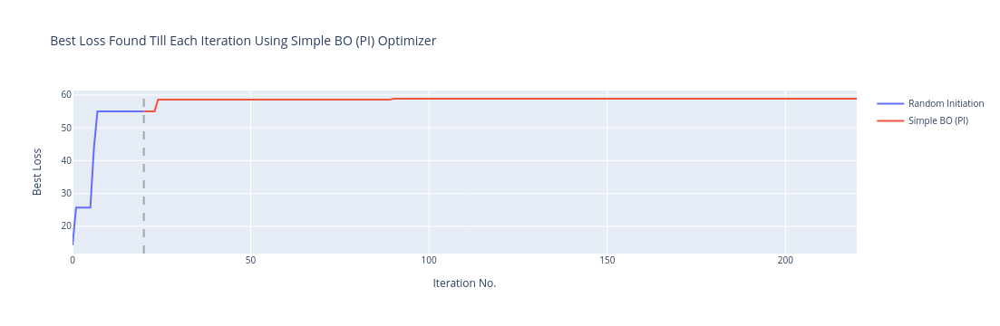

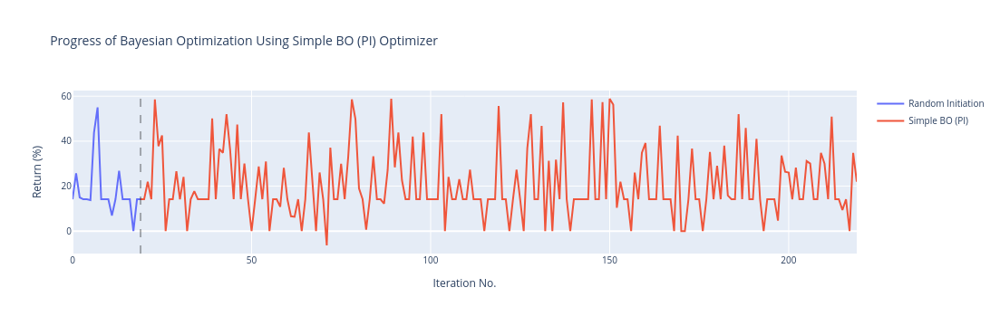

In [12]:
plot_optimization_progress(optimizer, init_set)

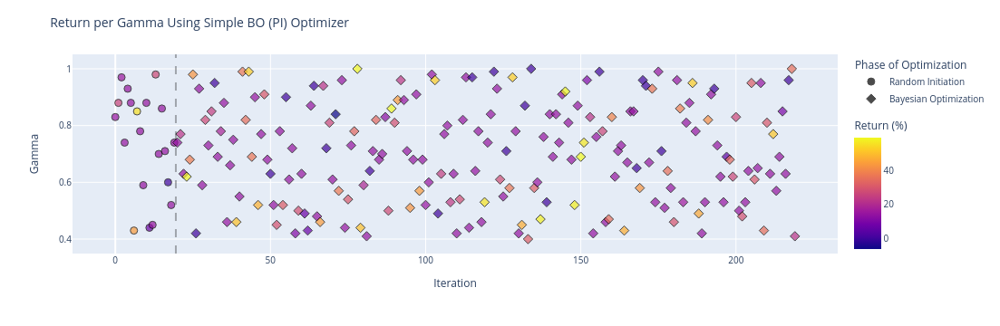

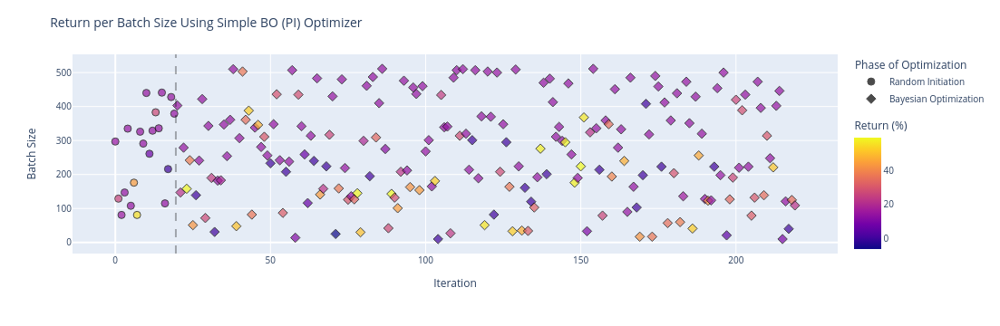

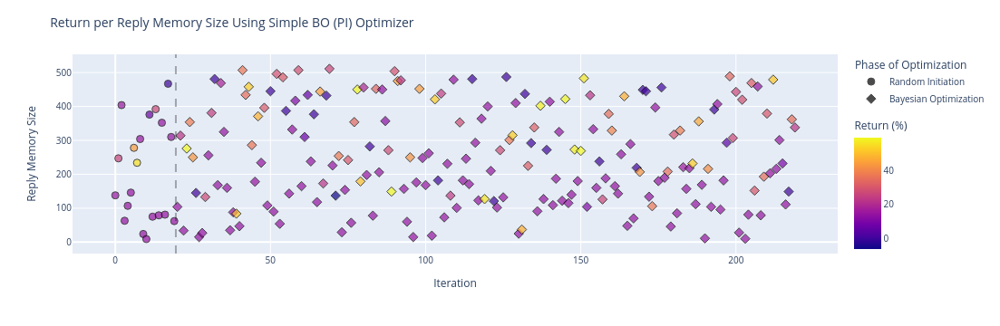

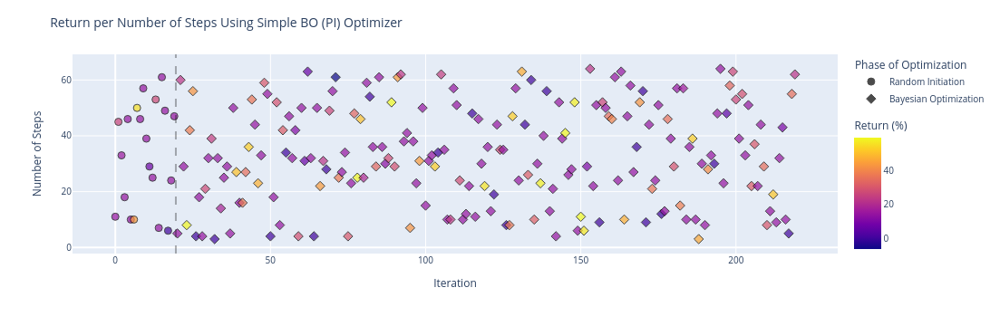

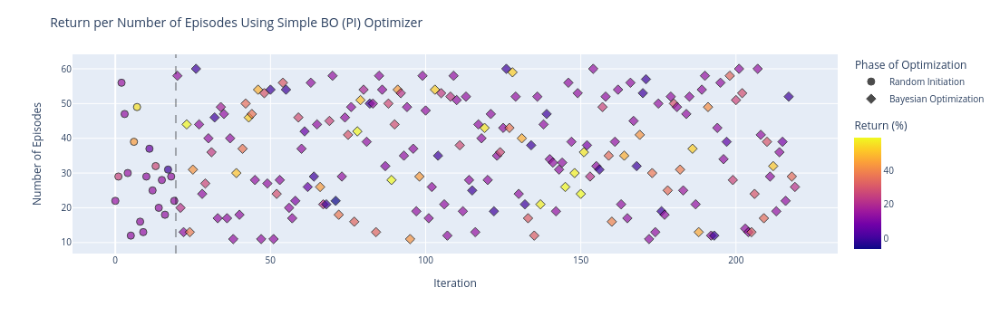

In [13]:
plot_hyperparams(params, optimizer, init_set)

In [14]:
# Imports Optimizer
from Optimizer.RandomSampling import RandomSearch
set_random_seed(42)

In [15]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='Random Search',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    optimizer = RandomSearch(objective_func, bounds, types, name='Random Search')
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.50it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:15<00:00,  4.66s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:06<00:00,  4.41s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.65it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.80it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:54<00:00,  4.57s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:24<00:00,  5.25s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:31<00:00,  4.32s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.80it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.69it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.77it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:35<00:00,  5.82s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.57it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:23<00:00,  6.36s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.78it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.73it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.85it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:50<00:00,  5.50s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.78it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.82it/s]


Complete


  0%|                                                   | 0/200 [00:00<?, ?it/s]

tensor([  0.6227, 470.0000, 378.0000,  30.0000,  24.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:11<00:00,  2.16it/s]


Complete


  0%|▏                                          | 1/200 [00:11<38:49, 11.71s/it]

tensor([  0.9807, 354.0000, 384.0000,  14.0000,  42.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [05:00<00:00,  7.15s/it]


Complete


  2%|▌                                       | 3/200 [05:12<6:16:06, 114.55s/it]

tensor([  0.5739, 308.0000, 213.0000,  49.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:13<00:00,  2.08it/s]


Complete


  2%|█                                        | 5/200 [05:26<3:12:37, 59.27s/it]

tensor([  0.7637, 146.0000, 462.0000,  22.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:36<00:00,  5.04s/it]


Complete


  3%|█▏                                       | 6/200 [08:03<4:36:37, 85.55s/it]

tensor([  0.8159,  54.0000, 304.0000,  41.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:26<00:00,  4.30s/it]


Complete


  4%|█▋                                       | 8/200 [09:30<3:35:11, 67.25s/it]

tensor([  0.9431, 429.0000, 112.0000,  30.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:08<00:00,  2.19it/s]


Complete


  4%|█▊                                       | 9/200 [09:39<2:50:08, 53.45s/it]

tensor([4.0065e-01, 2.8900e+02, 4.8600e+02, 1.0000e+01, 2.2000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [02:13<00:00,  6.08s/it]


Complete


  5%|██                                      | 10/200 [11:54<3:54:08, 73.94s/it]

tensor([  0.9463, 465.0000, 192.0000,  16.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:21<00:00,  2.16it/s]


Complete


  6%|██▍                                     | 12/200 [12:16<2:29:17, 47.64s/it]

tensor([  0.6398,  69.0000, 443.0000,   2.0000,  59.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [04:25<00:00,  4.50s/it]


Complete


  6%|██▌                                     | 13/200 [16:43<5:06:00, 98.18s/it]

tensor([  0.5539, 490.0000,  41.0000,  13.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.35it/s]


Complete


  7%|██▊                                     | 14/200 [16:51<3:55:22, 75.93s/it]

tensor([  0.6559, 392.0000,  48.0000,  61.0000,  33.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:11<00:00,  2.85it/s]


Complete


  8%|███                                     | 15/200 [17:04<3:02:45, 59.27s/it]

tensor([  0.4343, 429.0000, 140.0000,  24.0000,  34.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:12<00:00,  2.63it/s]


Complete


  8%|███▍                                    | 17/200 [17:17<1:52:19, 36.83s/it]

tensor([4.4590e-01, 2.9800e+02, 5.0300e+02, 4.5000e+01, 1.2000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:12<00:00,  6.01s/it]


Complete


  9%|███▌                                    | 18/200 [18:30<2:17:14, 45.24s/it]

tensor([  0.4444, 164.0000, 427.0000,  31.0000,  23.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:01<00:00,  5.29s/it]


Complete


 10%|███▊                                    | 19/200 [20:32<3:14:46, 64.57s/it]

tensor([  0.7844,   8.0000, 148.0000,  24.0000,  34.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:14<00:00,  3.95s/it]


Complete


 10%|████                                    | 20/200 [22:48<4:09:37, 83.21s/it]

tensor([ 0.7913, 72.0000, 95.0000, 16.0000, 15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:07<00:00,  4.49s/it]


Complete


 10%|████▏                                   | 21/200 [23:56<3:55:54, 79.08s/it]

tensor([  0.5054, 375.0000, 479.0000,  11.0000,  35.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:55<00:00,  6.72s/it]


Complete


 12%|████▌                                   | 23/200 [27:52<4:43:35, 96.13s/it]

tensor([  0.6994, 323.0000,  32.0000,  30.0000,  40.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.52it/s]


Complete


 12%|████▊                                   | 24/200 [28:08<3:46:19, 77.15s/it]

tensor([  0.5894, 378.0000, 385.0000,  58.0000,  36.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:53<00:00,  6.47s/it]


Complete


 12%|████▉                                  | 25/200 [32:02<5:41:07, 116.96s/it]

tensor([  0.7087, 505.0000, 327.0000,  50.0000,  59.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:20<00:00,  2.85it/s]


Complete


 13%|█████▏                                  | 26/200 [32:24<4:25:26, 91.53s/it]

tensor([  0.6412, 392.0000, 267.0000,  53.0000,  15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:04<00:00,  3.05it/s]


Complete


 14%|█████▍                                  | 27/200 [32:29<3:15:37, 67.85s/it]

tensor([  0.6186, 322.0000, 424.0000,  44.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [04:13<00:00,  6.17s/it]


Complete


 14%|█████▍                                 | 28/200 [36:43<5:45:02, 120.36s/it]

tensor([  0.6806, 385.0000, 435.0000,  40.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:23<00:00,  6.46s/it]


Complete


 15%|██████                                  | 30/200 [38:07<4:02:09, 85.47s/it]

tensor([ 0.8739, 36.0000, 65.0000,  9.0000, 17.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [01:11<00:00,  4.22s/it]


Complete


 16%|██████▏                                 | 31/200 [39:20<3:51:55, 82.34s/it]

tensor([  0.8278, 453.0000, 386.0000,  17.0000,  38.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:16<00:00,  2.37it/s]


Complete


 16%|██████▍                                 | 32/200 [39:37<3:03:30, 65.54s/it]

tensor([  0.9880, 419.0000,  48.0000,  20.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:07<00:00,  2.90it/s]


Complete


 16%|██████▌                                 | 33/200 [39:45<2:19:19, 50.06s/it]

tensor([  0.5689, 423.0000, 413.0000,  27.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:22<00:00,  2.54it/s]


Complete


 17%|██████▊                                 | 34/200 [40:07<1:57:34, 42.50s/it]

tensor([  0.8193, 328.0000, 321.0000,  54.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.36it/s]


Complete


 18%|███████                                 | 35/200 [40:24<1:36:28, 35.08s/it]

tensor([  0.8693,  33.0000, 267.0000,  18.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [03:26<00:00,  4.21s/it]


Complete


 18%|███████▏                                | 36/200 [43:51<3:51:30, 84.70s/it]

tensor([  0.5670, 267.0000, 364.0000,  16.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [04:50<00:00,  6.06s/it]


Complete


 19%|███████▍                               | 38/200 [48:43<5:03:20, 112.35s/it]

tensor([  0.9314, 172.0000, 309.0000,  18.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:42<00:00,  5.25s/it]


Complete


 20%|███████▌                               | 39/200 [51:27<5:35:08, 124.90s/it]

tensor([  0.6085, 323.0000, 508.0000,  35.0000,  40.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [04:10<00:00,  6.25s/it]


Complete


 20%|███████▊                               | 40/200 [55:37<6:59:50, 157.44s/it]

tensor([  0.9636, 499.0000, 350.0000,  40.0000,  53.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:23<00:00,  2.28it/s]


Complete


 20%|███████▉                               | 41/200 [56:01<5:21:53, 121.47s/it]

tensor([  0.4491, 269.0000, 106.0000,   6.0000,  36.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:13<00:00,  2.62it/s]


Complete


 21%|████████▍                               | 42/200 [56:16<4:01:32, 91.73s/it]

tensor([  0.5224, 146.0000,  14.0000,  62.0000,  19.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:08<00:00,  2.20it/s]


Complete


 22%|████████▌                               | 43/200 [56:25<2:58:40, 68.28s/it]

tensor([  0.6012, 168.0000,  49.0000,  38.0000,  35.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:13<00:00,  2.59it/s]


Complete


 22%|████████▊                               | 44/200 [56:40<2:17:06, 52.74s/it]

tensor([  0.5354, 189.0000, 262.0000,  36.0000,  43.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:56<00:00,  5.50s/it]


Complete


 22%|████████▎                            | 45/200 [1:00:37<4:35:28, 106.63s/it]

tensor([4.5838e-01, 2.7800e+02, 4.6800e+02, 3.5000e+01, 1.4000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:21<00:00,  5.85s/it]


Complete


 24%|████████▉                             | 47/200 [1:01:59<3:16:03, 76.89s/it]

tensor([  0.9592, 366.0000,  75.0000,  45.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:14<00:00,  2.91it/s]


Complete


 24%|█████████                             | 48/200 [1:02:14<2:36:15, 61.68s/it]

tensor([  0.4975, 173.0000, 372.0000,  23.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:49<00:00,  5.20s/it]


Complete


 24%|█████████▎                            | 49/200 [1:04:05<3:06:54, 74.27s/it]

tensor([  0.8351,  15.0000, 339.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [03:13<00:00,  3.94s/it]


Complete


 25%|█████████▎                           | 50/200 [1:07:18<4:26:29, 106.59s/it]

tensor([  0.7140, 217.0000, 310.0000,  49.0000,  51.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [04:34<00:00,  5.38s/it]


Complete


 26%|█████████▍                           | 51/200 [1:11:53<6:21:07, 153.48s/it]

tensor([  0.8893, 198.0000,  62.0000,  11.0000,  55.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:21<00:00,  2.61it/s]


Complete


 26%|█████████▌                           | 52/200 [1:12:15<4:46:01, 115.96s/it]

tensor([  0.6256,  72.0000, 332.0000,  38.0000,  35.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [02:35<00:00,  4.43s/it]


Complete


 26%|█████████▊                           | 53/200 [1:14:51<5:12:18, 127.47s/it]

tensor([  0.6355, 349.0000,  34.0000,  11.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:20<00:00,  2.36it/s]


Complete


 27%|██████████▎                           | 54/200 [1:15:12<3:54:29, 96.37s/it]

tensor([  0.6529, 237.0000, 112.0000,  38.0000,  26.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:10<00:00,  2.52it/s]


Complete


 28%|██████████▍                           | 55/200 [1:15:23<2:52:08, 71.23s/it]

tensor([  0.4384, 133.0000,  49.0000,   3.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:24<00:00,  2.28it/s]


Complete


 28%|██████████▊                           | 57/200 [1:15:48<1:45:58, 44.46s/it]

tensor([  0.9561,   8.0000, 103.0000,   7.0000,  33.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [02:15<00:00,  4.10s/it]


Complete


 29%|███████████                           | 58/200 [1:18:04<2:38:38, 67.03s/it]

tensor([  0.6513, 187.0000, 401.0000,   7.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:57<00:00,  5.55s/it]


Complete


 30%|███████████▏                          | 59/200 [1:21:03<3:45:33, 95.98s/it]

tensor([  0.9338,  86.0000, 414.0000,  63.0000,  53.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [03:53<00:00,  4.41s/it]


Complete


 30%|███████████                          | 60/200 [1:24:57<5:11:29, 133.50s/it]

tensor([  0.5075,  67.0000, 480.0000,  56.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:45<00:00,  4.25s/it]


Complete


 30%|███████████▎                         | 61/200 [1:27:44<5:30:39, 142.73s/it]

tensor([  0.9939, 394.0000, 327.0000,   5.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.34it/s]


Complete


 31%|███████████▍                         | 62/200 [1:27:57<4:03:14, 105.76s/it]

tensor([  0.8870, 295.0000, 280.0000,  27.0000,  46.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:18<00:00,  2.54it/s]


Complete


 32%|███████████▉                          | 63/200 [1:28:15<3:04:04, 80.62s/it]

tensor([  0.7629, 186.0000,  12.0000,  53.0000,  53.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:18<00:00,  2.82it/s]


Complete


 32%|████████████▏                         | 64/200 [1:28:35<2:22:10, 62.72s/it]

tensor([  0.7173,  66.0000, 114.0000,  39.0000,  34.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:33<00:00,  4.53s/it]


Complete


 32%|████████████▎                         | 65/200 [1:31:10<3:22:03, 89.81s/it]

tensor([  0.5947, 411.0000, 100.0000,   6.0000,  46.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:19<00:00,  2.39it/s]


Complete


 33%|████████████▌                         | 66/200 [1:31:30<2:34:28, 69.17s/it]

tensor([  0.7553, 177.0000, 493.0000,  31.0000,  54.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:43<00:00,  5.25s/it]


Complete


 34%|████████████▌                        | 68/200 [1:36:14<3:45:46, 102.62s/it]

tensor([  0.9872, 387.0000, 193.0000,  32.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:12<00:00,  2.38it/s]


Complete


 34%|█████████████                         | 69/200 [1:36:27<2:55:54, 80.57s/it]

tensor([  0.6467, 159.0000, 485.0000,  62.0000,  27.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:14<00:00,  4.99s/it]


Complete


 35%|█████████████▎                        | 70/200 [1:38:43<3:25:30, 94.85s/it]

tensor([  0.6327, 291.0000, 389.0000,  28.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:58<00:00,  6.10s/it]


Complete


 36%|█████████████▏                       | 71/200 [1:43:42<5:23:11, 150.32s/it]

tensor([  0.9724, 367.0000, 176.0000,  12.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:09<00:00,  2.32it/s]


Complete


 36%|█████████████▎                       | 72/200 [1:43:52<3:56:53, 111.04s/it]

tensor([  0.7328, 499.0000, 309.0000,  61.0000,  26.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:10<00:00,  2.57it/s]


Complete


 36%|█████████████▊                        | 73/200 [1:44:02<2:54:31, 82.45s/it]

tensor([  0.7739, 431.0000, 360.0000,  20.0000,  46.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:16<00:00,  2.73it/s]


Complete


 37%|██████████████                        | 74/200 [1:44:20<2:13:41, 63.67s/it]

tensor([  0.5671, 409.0000,  88.0000,  30.0000,  17.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:05<00:00,  2.83it/s]


Complete


 38%|██████████████▎                       | 75/200 [1:44:27<1:37:50, 46.97s/it]

tensor([  0.4734, 175.0000, 221.0000,  19.0000,  43.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:51<00:00,  5.39s/it]


Complete


 38%|██████████████                       | 76/200 [1:48:19<3:30:00, 101.61s/it]

tensor([  0.9745, 495.0000, 428.0000,   9.0000,  42.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:16<00:00,  2.61it/s]


Complete


 38%|██████████████▋                       | 77/200 [1:48:36<2:36:46, 76.48s/it]

tensor([  0.7860, 347.0000,  59.0000,  34.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:07<00:00,  2.82it/s]


Complete


 39%|██████████████▊                       | 78/200 [1:48:44<1:54:11, 56.16s/it]

tensor([  0.5713, 432.0000, 305.0000,  32.0000,  15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.63it/s]


Complete


 40%|███████████████▏                      | 80/200 [1:48:50<1:03:37, 31.81s/it]

tensor([4.2519e-01, 2.4100e+02, 5.0400e+02, 2.9000e+01, 4.6000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [04:26<00:00,  5.80s/it]


Complete


 40%|███████████████▍                      | 81/200 [1:53:18<2:58:43, 90.12s/it]

tensor([  0.5491, 171.0000, 193.0000,  40.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:46<00:00,  5.06s/it]


Complete


 41%|███████████████▌                      | 82/200 [1:55:05<3:06:06, 94.63s/it]

tensor([  0.6337, 352.0000, 412.0000,   2.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [04:08<00:00,  6.71s/it]


Complete


 42%|███████████████▎                     | 83/200 [1:59:15<4:26:21, 136.60s/it]

tensor([  0.7925, 298.0000, 182.0000,  11.0000,  55.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:25<00:00,  2.15it/s]


Complete


 42%|███████████████▌                     | 84/200 [1:59:41<3:24:34, 105.81s/it]

tensor([  0.9816, 468.0000, 128.0000,  41.0000,  27.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:10<00:00,  2.63it/s]


Complete


 42%|████████████████▏                     | 85/200 [1:59:52<2:30:57, 78.76s/it]

tensor([  0.7202, 161.0000, 341.0000,  41.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:44<00:00,  5.24s/it]


Complete


 43%|████████████████▎                     | 86/200 [2:01:37<2:44:18, 86.48s/it]

tensor([  0.6215, 277.0000, 288.0000,  55.0000,  55.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [05:13<00:00,  5.70s/it]


Complete


 44%|████████████████                     | 87/200 [2:06:52<4:48:23, 153.13s/it]

tensor([  0.6834, 209.0000, 380.0000,  26.0000,  46.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [04:12<00:00,  5.49s/it]


Complete


 44%|████████████████▎                    | 88/200 [2:11:05<5:41:04, 182.72s/it]

tensor([  0.9189,  13.0000, 337.0000,  51.0000,  42.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [02:41<00:00,  3.84s/it]


Complete


 44%|████████████████▍                    | 89/200 [2:13:47<5:26:37, 176.55s/it]

tensor([  0.5499, 494.0000, 266.0000,  13.0000,  26.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:09<00:00,  2.73it/s]


Complete


 45%|████████████████▋                    | 90/200 [2:13:57<3:53:01, 127.11s/it]

tensor([  0.7919, 504.0000, 464.0000,  58.0000,  24.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.80it/s]


Complete


 46%|█████████████████▎                    | 91/200 [2:14:07<2:47:05, 91.98s/it]

tensor([  0.7885,  84.0000, 101.0000,  24.0000,  27.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:03<00:00,  4.57s/it]


Complete


 46%|█████████████████▋                    | 93/200 [2:16:11<2:19:30, 78.23s/it]

tensor([  0.7656, 347.0000, 131.0000,   6.0000,  44.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:16<00:00,  2.67it/s]


Complete


 47%|█████████████████▊                    | 94/200 [2:16:28<1:51:33, 63.14s/it]

tensor([  0.9911,  50.0000, 155.0000,  17.0000,  34.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:26<00:00,  4.32s/it]


Complete


 48%|██████████████████                    | 95/200 [2:18:56<2:29:05, 85.19s/it]

tensor([  0.4714, 330.0000, 163.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.40it/s]


Complete


 48%|██████████████████▏                   | 96/200 [2:19:09<1:53:34, 65.52s/it]

tensor([  0.4809, 438.0000,  52.0000,  32.0000,  40.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.52it/s]


Complete


 48%|██████████████████▍                   | 97/200 [2:19:25<1:28:57, 51.82s/it]

tensor([  0.8659, 352.0000,  71.0000,  38.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:20<00:00,  2.76it/s]


Complete


 49%|██████████████████▌                   | 98/200 [2:19:46<1:13:07, 43.01s/it]

tensor([  0.6856, 412.0000, 168.0000,  24.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.13it/s]


Complete


 50%|███████████████████▊                    | 99/200 [2:19:52<54:34, 32.42s/it]

tensor([  0.7745, 404.0000,  33.0000,  29.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.90it/s]


Complete


 50%|███████████████████▌                   | 100/200 [2:20:01<42:11, 25.32s/it]

tensor([  0.4980,  15.0000, 483.0000,  55.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [03:05<00:00,  3.86s/it]


Complete


 50%|██████████████████▋                  | 101/200 [2:23:07<1:59:57, 72.70s/it]

tensor([ 0.7714, 70.0000, 54.0000, 37.0000, 42.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:16<00:00,  2.51it/s]


Complete


 51%|██████████████████▊                  | 102/200 [2:23:24<1:32:01, 56.34s/it]

tensor([  0.8924, 375.0000,  25.0000,  56.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.66it/s]


Complete


 52%|███████████████████                  | 103/200 [2:23:34<1:08:53, 42.62s/it]

tensor([  0.7502,  99.0000, 232.0000,  60.0000,  19.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:25<00:00,  4.50s/it]


Complete


 52%|███████████████████▏                 | 104/200 [2:25:00<1:28:56, 55.59s/it]

tensor([  0.8587,  40.0000, 332.0000,  56.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:04<00:00,  4.01s/it]


Complete


 52%|███████████████████▍                 | 105/200 [2:26:05<1:32:24, 58.37s/it]

tensor([  0.8137,  74.0000, 262.0000,  13.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:05<00:00,  4.48s/it]


Complete


 54%|███████████████████▊                 | 107/200 [2:28:12<1:33:51, 60.55s/it]

tensor([  0.5354, 299.0000, 316.0000,  11.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:49<00:00,  6.10s/it]


Complete


 54%|███████████████████▉                 | 108/200 [2:30:02<1:51:46, 72.90s/it]

tensor([  0.8349, 369.0000, 149.0000,  44.0000,  58.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:23<00:00,  2.47it/s]


Complete


 55%|████████████████████▏                | 109/200 [2:30:26<1:31:20, 60.23s/it]

tensor([  0.9291, 197.0000, 109.0000,   8.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.48it/s]


Complete


 55%|████████████████████▎                | 110/200 [2:30:35<1:09:22, 46.25s/it]

tensor([  0.6162, 304.0000,  12.0000,  57.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:06<00:00,  2.96it/s]


Complete


 56%|█████████████████████▋                 | 111/200 [2:30:43<52:29, 35.39s/it]

tensor([  0.6542, 386.0000,  95.0000,  61.0000,  58.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:20<00:00,  2.80it/s]


Complete


 56%|█████████████████████▊                 | 112/200 [2:31:04<46:00, 31.37s/it]

tensor([  0.4691, 357.0000, 415.0000,  49.0000,  38.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [04:06<00:00,  6.47s/it]


Complete


 56%|████████████████████▉                | 113/200 [2:35:11<2:15:55, 93.74s/it]

tensor([  0.9688, 321.0000, 299.0000,  18.0000,  52.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:18<00:00,  2.84it/s]


Complete


 57%|█████████████████████                | 114/200 [2:35:30<1:43:00, 71.86s/it]

tensor([  0.8455,  57.0000, 478.0000,  11.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:21<00:00,  4.42s/it]


Complete


 57%|█████████████████████▎               | 115/200 [2:37:52<2:11:10, 92.59s/it]

tensor([  0.9744, 481.0000, 296.0000,  40.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.54it/s]


Complete


 58%|█████████████████████▍               | 116/200 [2:38:04<1:36:13, 68.73s/it]

tensor([  0.9685, 410.0000, 375.0000,  63.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.72it/s]


Complete


 58%|█████████████████████▋               | 117/200 [2:38:09<1:08:52, 49.79s/it]

tensor([  0.9099, 173.0000, 172.0000,  36.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.54it/s]


Complete


 59%|███████████████████████                | 118/200 [2:38:18<51:31, 37.70s/it]

tensor([  0.5372, 476.0000,  26.0000,  53.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:17<00:00,  2.84it/s]


Complete


 60%|███████████████████████▏               | 119/200 [2:38:36<42:57, 31.82s/it]

tensor([  0.8903, 298.0000, 109.0000,  21.0000,  57.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:20<00:00,  2.82it/s]


Complete


 60%|███████████████████████▍               | 120/200 [2:38:57<38:05, 28.57s/it]

tensor([  0.8805, 374.0000,  88.0000,  24.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.79it/s]


Complete


 61%|███████████████████████▊               | 122/200 [2:39:05<22:21, 17.20s/it]

tensor([  0.7248, 385.0000, 482.0000,  58.0000,  44.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [04:53<00:00,  6.67s/it]


Complete


 62%|██████████████████████▊              | 123/200 [2:43:59<1:50:05, 85.79s/it]

tensor([4.5573e-01, 2.7700e+02, 4.7100e+02, 1.3000e+01, 1.0000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:58<00:00,  5.90s/it]


Complete


 62%|██████████████████████▉              | 124/200 [2:44:59<1:40:00, 78.95s/it]

tensor([  0.6179, 126.0000, 114.0000,  36.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:11<00:00,  2.66it/s]


Complete


 62%|███████████████████████▏             | 125/200 [2:45:11<1:16:03, 60.84s/it]

tensor([4.3176e-01, 4.7400e+02, 3.7000e+02, 3.0000e+00, 4.1000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:14<00:00,  2.82it/s]


Complete


 63%|████████████████████████▌              | 126/200 [2:45:26<59:17, 48.08s/it]

tensor([  0.6801, 412.0000,  46.0000,  42.0000,  34.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:14<00:00,  2.35it/s]


Complete


 64%|████████████████████████▊              | 127/200 [2:45:41<47:01, 38.66s/it]

tensor([  0.5673, 178.0000,  45.0000,  46.0000,  10.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:04<00:00,  2.32it/s]


Complete


 64%|████████████████████████▉              | 128/200 [2:45:46<34:41, 28.91s/it]

tensor([  0.7524, 172.0000, 360.0000,   6.0000,  33.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [03:04<00:00,  5.60s/it]


Complete


 64%|███████████████████████▊             | 129/200 [2:48:52<1:28:26, 74.74s/it]

tensor([  0.6547, 168.0000, 491.0000,  45.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:07<00:00,  5.08s/it]


Complete


 65%|████████████████████████             | 130/200 [2:51:00<1:45:28, 90.41s/it]

tensor([  0.8217,  80.0000, 474.0000,  18.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:10<00:00,  4.52s/it]


Complete


 66%|███████████████████████▌            | 131/200 [2:53:11<1:58:03, 102.66s/it]

tensor([  0.9545, 123.0000,  17.0000,  36.0000,  42.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:15<00:00,  2.66it/s]


Complete


 66%|████████████████████████▍            | 132/200 [2:53:28<1:27:23, 77.11s/it]

tensor([  0.5941, 310.0000, 477.0000,  10.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [02:06<00:00,  6.31s/it]


Complete


 66%|████████████████████████▌            | 133/200 [2:55:35<1:42:40, 91.94s/it]

tensor([  0.8227, 430.0000, 451.0000,  14.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [02:27<00:00,  7.04s/it]


Complete


 67%|████████████████████████            | 134/200 [2:58:04<1:59:47, 108.90s/it]

tensor([  0.8575,  53.0000, 169.0000,  42.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:44<00:00,  4.23s/it]


Complete


 68%|████████████████████████▎           | 135/200 [3:00:49<2:16:16, 125.79s/it]

tensor([  0.8934, 184.0000, 288.0000,  34.0000,  23.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:00<00:00,  5.24s/it]


Complete


 68%|████████████████████████▍           | 136/200 [3:02:51<2:12:46, 124.48s/it]

tensor([  0.4333, 329.0000, 242.0000,  56.0000,  55.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:18<00:00,  2.92it/s]


Complete


 69%|█████████████████████████▌           | 138/200 [3:03:10<1:13:58, 71.59s/it]

tensor([  0.6164, 365.0000, 366.0000,  48.0000,  43.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:37<00:00,  6.44s/it]


Complete


 70%|█████████████████████████           | 139/200 [3:07:48<2:04:43, 122.67s/it]

tensor([  0.4588, 377.0000, 412.0000,  22.0000,  23.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:35<00:00,  6.74s/it]


Complete


 70%|█████████████████████████▏          | 140/200 [3:10:24<2:11:23, 131.39s/it]

tensor([  0.4716, 411.0000,  97.0000,  11.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:18<00:00,  2.26it/s]


Complete


 70%|█████████████████████████▍          | 141/200 [3:10:43<1:39:05, 100.78s/it]

tensor([  0.6953, 483.0000,  57.0000,  17.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.53it/s]


Complete


 71%|██████████████████████████▎          | 142/200 [3:11:03<1:15:36, 78.21s/it]

tensor([  0.9874, 449.0000,  91.0000,  38.0000,  40.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.55it/s]


Complete


 72%|███████████████████████████▉           | 143/200 [3:11:19<57:31, 60.55s/it]

tensor([  0.9005, 494.0000, 209.0000,  22.0000,  19.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:08<00:00,  2.24it/s]


Complete


 72%|████████████████████████████           | 144/200 [3:11:28<42:38, 45.68s/it]

tensor([  0.7063, 151.0000, 415.0000,   6.0000,  59.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [05:09<00:00,  5.25s/it]


Complete


 72%|██████████████████████████          | 145/200 [3:16:39<1:53:00, 123.28s/it]

tensor([  0.6627, 104.0000, 410.0000,   7.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:51<00:00,  4.92s/it]


Complete


 73%|██████████████████████████▎         | 146/200 [3:20:31<2:19:48, 155.35s/it]

tensor([  0.9950, 292.0000, 124.0000,  45.0000,  38.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:14<00:00,  2.60it/s]


Complete


 74%|██████████████████████████▍         | 147/200 [3:20:47<1:40:34, 113.86s/it]

tensor([  0.5065, 112.0000, 259.0000,  58.0000,  26.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:02<00:00,  4.72s/it]


Complete


 74%|██████████████████████████▋         | 148/200 [3:22:50<1:41:11, 116.77s/it]

tensor([  0.7913, 398.0000, 328.0000,  15.0000,  57.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:24<00:00,  2.28it/s]


Complete


 74%|███████████████████████████▌         | 149/200 [3:23:16<1:16:08, 89.57s/it]

tensor([  0.5966, 492.0000, 511.0000,  41.0000,  21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [02:34<00:00,  7.36s/it]


Complete


 75%|███████████████████████████         | 150/200 [3:25:51<1:30:58, 109.16s/it]

tensor([  0.5302, 243.0000, 288.0000,  49.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:28<00:00,  5.63s/it]


Complete


 76%|███████████████████████████▏        | 151/200 [3:29:20<1:53:31, 139.01s/it]

tensor([  0.7794, 121.0000, 378.0000,  23.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:45<00:00,  4.80s/it]


Complete


 76%|███████████████████████████▎        | 152/200 [3:31:06<1:43:21, 129.19s/it]

tensor([  0.9963, 148.0000, 266.0000,  60.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [04:35<00:00,  4.92s/it]


Complete


 76%|███████████████████████████▌        | 153/200 [3:35:42<2:15:40, 173.20s/it]

tensor([  0.8454, 278.0000, 374.0000,  46.0000,  45.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:22<00:00,  5.84s/it]


Complete


 78%|███████████████████████████▉        | 155/200 [3:40:06<1:55:35, 154.13s/it]

tensor([  0.4942,  60.0000, 415.0000,   8.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:17<00:00,  4.58s/it]


Complete


 78%|████████████████████████████        | 156/200 [3:42:24<1:50:09, 150.21s/it]

tensor([  0.5881, 484.0000, 232.0000,  53.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:14<00:00,  2.89it/s]


Complete


 78%|████████████████████████████▎       | 157/200 [3:42:39<1:22:17, 114.84s/it]

tensor([  0.6534, 268.0000,  86.0000,  27.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:09<00:00,  2.16it/s]


Complete


 79%|█████████████████████████████▏       | 158/200 [3:42:49<1:00:25, 86.33s/it]

tensor([  0.6190, 411.0000, 137.0000,  11.0000,  17.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:07<00:00,  2.31it/s]


Complete


 80%|███████████████████████████████        | 159/200 [3:42:57<44:00, 64.41s/it]

tensor([  0.7657, 290.0000, 428.0000,  63.0000,  43.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:11<00:00,  5.85s/it]


Complete


 80%|████████████████████████████▊       | 160/200 [3:47:09<1:18:43, 118.09s/it]

tensor([  0.5494, 474.0000, 341.0000,  17.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.71it/s]


Complete


 80%|███████████████████████████████▍       | 161/200 [3:47:15<55:29, 85.38s/it]

tensor([  0.8956, 309.0000, 316.0000,  15.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [06:04<00:00,  7.60s/it]


Complete


 81%|█████████████████████████████▏      | 162/200 [3:53:20<1:45:57, 167.31s/it]

tensor([ 0.9371,  9.0000, 97.0000,  7.0000, 21.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:24<00:00,  4.04s/it]


Complete


 82%|█████████████████████████████▎      | 163/200 [3:54:46<1:28:23, 143.34s/it]

tensor([  0.4491, 362.0000, 264.0000,  59.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.70it/s]


Complete


 82%|█████████████████████████████▌      | 164/200 [3:54:51<1:01:26, 102.40s/it]

tensor([  0.5127, 364.0000, 349.0000,  57.0000,  59.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:20<00:00,  2.88it/s]


Complete


 82%|████████████████████████████████▏      | 165/200 [3:55:12<45:38, 78.23s/it]

tensor([  0.7931, 107.0000, 397.0000,  50.0000,  36.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [02:50<00:00,  4.75s/it]


Complete


 83%|█████████████████████████████▉      | 166/200 [3:58:04<1:00:08, 106.15s/it]

tensor([  0.7199, 281.0000, 261.0000,  21.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:26<00:00,  2.11it/s]


Complete


 84%|████████████████████████████████▌      | 167/200 [3:58:31<45:25, 82.59s/it]

tensor([  0.9304, 128.0000, 195.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:20<00:00,  4.86s/it]


Complete


 84%|███████████████████████████████▉      | 168/200 [4:00:53<53:28, 100.25s/it]

tensor([  0.9377, 385.0000, 257.0000,   2.0000,  59.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:23<00:00,  2.48it/s]


Complete


 84%|████████████████████████████████▉      | 169/200 [4:01:18<40:05, 77.59s/it]

tensor([  0.9765,  20.0000, 123.0000,   3.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:54<00:00,  4.22s/it]


Complete


 85%|█████████████████████████████████▏     | 170/200 [4:02:13<35:32, 71.09s/it]

tensor([  0.8707, 254.0000, 455.0000,  23.0000,  15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:26<00:00,  5.76s/it]


Complete


 86%|█████████████████████████████████▎     | 171/200 [4:03:41<36:40, 75.88s/it]

tensor([4.1079e-01, 4.9400e+02, 3.5700e+02, 4.9000e+01, 2.8000e+01],
       dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.76it/s]


Complete


 86%|█████████████████████████████████▋     | 173/200 [4:03:51<19:30, 43.36s/it]

tensor([  0.9456, 309.0000, 437.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:14<00:00,  6.09s/it]


Complete


 87%|█████████████████████████████████▉     | 174/200 [4:07:07<35:06, 81.04s/it]

tensor([  0.8342, 481.0000, 118.0000,  39.0000,  11.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.63it/s]


Complete


 88%|██████████████████████████████████▏    | 175/200 [4:07:12<25:27, 61.11s/it]

tensor([  0.8694, 114.0000, 462.0000,   8.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:49<00:00,  4.87s/it]


Complete


 88%|█████████████████████████████████▍    | 176/200 [4:11:01<42:46, 106.95s/it]

tensor([  0.9707, 423.0000, 336.0000,   4.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.38it/s]


Complete


 88%|██████████████████████████████████▌    | 177/200 [4:11:09<30:24, 79.32s/it]

tensor([  0.6346, 311.0000, 349.0000,  57.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:06<00:00,  6.00s/it]


Complete


 89%|█████████████████████████████████▊    | 178/200 [4:14:16<40:19, 109.98s/it]

tensor([  0.8631, 256.0000,  32.0000,  62.0000,  45.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:17<00:00,  2.53it/s]


Complete


 90%|██████████████████████████████████▉    | 179/200 [4:14:35<29:13, 83.49s/it]

tensor([  0.6580,  99.0000, 429.0000,  27.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:19<00:00,  4.64s/it]


Complete


 90%|██████████████████████████████████▏   | 180/200 [4:16:55<33:20, 100.04s/it]

tensor([  0.4001, 140.0000,  40.0000,   4.0000,  19.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:09<00:00,  2.05it/s]


Complete


 90%|███████████████████████████████████▎   | 181/200 [4:17:05<23:15, 73.46s/it]

tensor([  0.7928,  60.0000, 428.0000,  35.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:22<00:00,  4.31s/it]


Complete


 91%|██████████████████████████████████▌   | 182/200 [4:20:28<33:33, 111.85s/it]

tensor([  0.6045, 402.0000, 285.0000,  41.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:17<00:00,  2.35it/s]


Complete


 92%|███████████████████████████████████▋   | 183/200 [4:20:46<23:47, 83.98s/it]

tensor([  0.9744, 101.0000, 240.0000,  15.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:31<00:00,  4.72s/it]


Complete


 92%|██████████████████████████████████▉   | 184/200 [4:23:17<27:47, 104.20s/it]

tensor([  0.7942, 362.0000, 326.0000,  50.0000,  44.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:18<00:00,  2.44it/s]


Complete


 92%|████████████████████████████████████   | 185/200 [4:23:36<19:40, 78.69s/it]

tensor([  0.7853, 359.0000, 150.0000,  23.0000,  45.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:22<00:00,  1.97it/s]


Complete


 93%|████████████████████████████████████▎  | 186/200 [4:24:00<14:30, 62.21s/it]

tensor([  0.4816, 433.0000, 240.0000,  36.0000,  52.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:24<00:00,  2.15it/s]


Complete


 94%|████████████████████████████████████▍  | 187/200 [4:24:25<11:03, 51.05s/it]

tensor([  0.8503, 337.0000, 154.0000,   5.0000,  53.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:23<00:00,  2.26it/s]


Complete


 94%|████████████████████████████████████▋  | 188/200 [4:24:49<08:35, 42.97s/it]

tensor([  0.9346,  90.0000, 262.0000,  34.0000,  50.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [03:57<00:00,  4.74s/it]


Complete


 94%|███████████████████████████████████▉  | 189/200 [4:28:47<18:34, 101.30s/it]

tensor([  0.8898, 495.0000,  38.0000,   6.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:20<00:00,  2.69it/s]


Complete


 95%|█████████████████████████████████████  | 190/200 [4:29:08<12:54, 77.40s/it]

tensor([  0.9457, 242.0000, 323.0000,  15.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:52<00:00,  5.94s/it]


Complete


 96%|█████████████████████████████████████▍ | 192/200 [4:32:01<10:52, 81.62s/it]

tensor([  0.9682, 460.0000, 234.0000,  42.0000,  14.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:04<00:00,  3.00it/s]


Complete


 96%|█████████████████████████████████████▋ | 193/200 [4:32:07<07:19, 62.76s/it]

tensor([  0.5886, 452.0000, 323.0000,  59.0000,  53.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:18<00:00,  2.84it/s]


Complete


 97%|█████████████████████████████████████▊ | 194/200 [4:32:26<05:08, 51.43s/it]

tensor([  0.9291, 409.0000, 450.0000,  32.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [02:32<00:00,  6.92s/it]


Complete


 98%|██████████████████████████████████████ | 195/200 [4:34:59<06:35, 79.07s/it]

tensor([  0.5451, 260.0000, 470.0000,   3.0000,  15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:29<00:00,  5.94s/it]


Complete


 98%|██████████████████████████████████████▏| 196/200 [4:36:29<05:28, 82.06s/it]

tensor([  0.6168, 201.0000, 500.0000,  22.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [04:22<00:00,  5.47s/it]


Complete


 98%|█████████████████████████████████████▍| 197/200 [4:40:53<06:41, 133.89s/it]

tensor([  0.6277, 407.0000, 156.0000,  56.0000,  41.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:16<00:00,  2.49it/s]


Complete


 99%|█████████████████████████████████████▌| 198/200 [4:41:10<03:20, 100.09s/it]

tensor([  0.8940, 380.0000,  35.0000,  18.0000,  17.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:08<00:00,  2.11it/s]


Complete


100%|██████████████████████████████████████▊| 199/200 [4:41:19<01:13, 73.41s/it]

tensor([  0.9291, 369.0000, 235.0000,  34.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.74it/s]


Complete


100%|███████████████████████████████████████| 200/200 [4:41:36<00:00, 57.01s/it]

tensor([  0.7819, 174.0000, 290.0000,  40.0000,  14.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:16<00:00,  5.49s/it]


Complete


201it [4:42:54, 63.13s/it]                                                      

tensor([  0.7729, 361.0000, 199.0000,  49.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:10<00:00,  2.95it/s]


Complete


202it [4:43:06, 47.78s/it]

tensor([  0.5481, 148.0000, 118.0000,  52.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:16<00:00,  2.84it/s]


Complete


203it [4:43:23, 38.76s/it]

tensor([  0.9516, 354.0000, 180.0000,  63.0000,  50.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.91it/s]


Complete


204it [4:43:41, 32.52s/it]

tensor([  0.9161, 307.0000, 479.0000,  55.0000,  48.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [04:52<00:00,  6.10s/it]


Complete


205it [4:48:34, 110.54s/it]

tensor([  0.8441,  73.0000, 505.0000,  63.0000,  23.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [01:39<00:00,  4.33s/it]


Complete


206it [4:50:15, 107.51s/it]

tensor([  0.8909, 303.0000, 162.0000,  21.0000,  15.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.86it/s]


Complete


207it [4:50:21, 77.11s/it] 

tensor([  0.8366, 411.0000, 143.0000,  47.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.37it/s]


Complete


208it [4:50:30, 56.74s/it]

tensor([ 0.6575, 17.0000, 55.0000, 14.0000, 43.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [02:55<00:00,  4.09s/it]


Complete


209it [4:53:27, 92.67s/it]

tensor([  0.6783, 216.0000, 364.0000,  37.0000,  26.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:22<00:00,  5.47s/it]


Complete


210it [4:55:49, 107.73s/it]

tensor([  0.8797,  16.0000, 221.0000,  46.0000,  14.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:54<00:00,  3.86s/it]


Complete


212it [4:56:45, 70.71s/it] 

tensor([  0.8219, 295.0000, 340.0000,  36.0000,  58.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [05:49<00:00,  6.03s/it]


Complete


213it [5:02:35, 140.03s/it]

tensor([  0.4705, 280.0000, 282.0000,  11.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:17<00:00,  5.94s/it]


Complete


214it [5:03:53, 123.84s/it]

tensor([  0.8414, 245.0000, 169.0000,  47.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:18<00:00,  2.61it/s]


Complete


215it [5:04:12, 95.26s/it] 

tensor([  0.5756, 298.0000, 195.0000,  44.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:14<00:00,  2.21it/s]


Complete


216it [5:04:27, 72.86s/it]

tensor([  0.6252, 202.0000, 151.0000,  27.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:10<00:00,  2.11it/s]


Complete


217it [5:04:38, 55.22s/it]

tensor([  0.7605, 182.0000, 480.0000,  35.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:06<00:00,  5.54s/it]


Complete


218it [5:05:45, 58.73s/it]

tensor([  0.5442, 316.0000, 151.0000,  54.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.69it/s]


Complete


219it [5:05:54, 44.12s/it]

tensor([  0.9280, 189.0000, 299.0000,  34.0000,  36.0000], dtype=torch.float64)
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:10<00:00,  5.30s/it]


Complete


100%|███████████████████████████████████████| 200/200 [5:09:06<00:00, 92.73s/it]


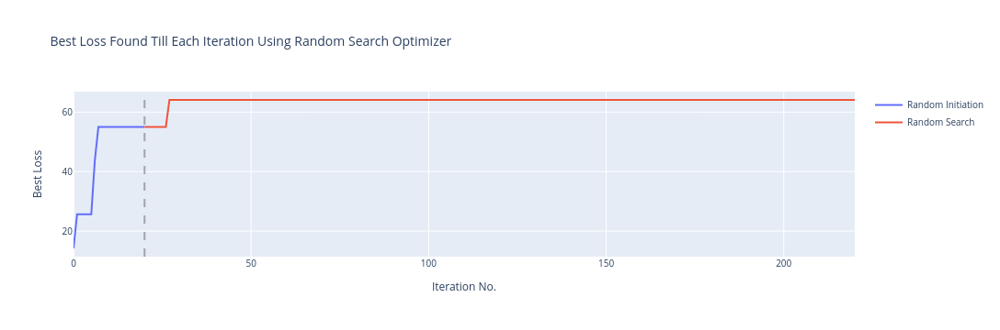

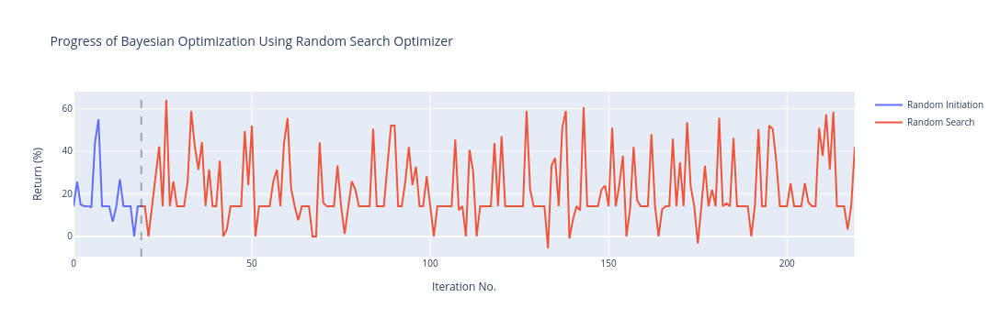

In [16]:
plot_optimization_progress(optimizer, init_set)

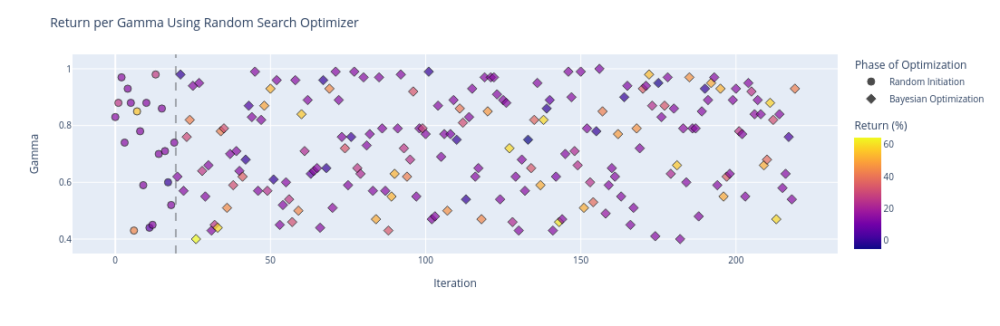

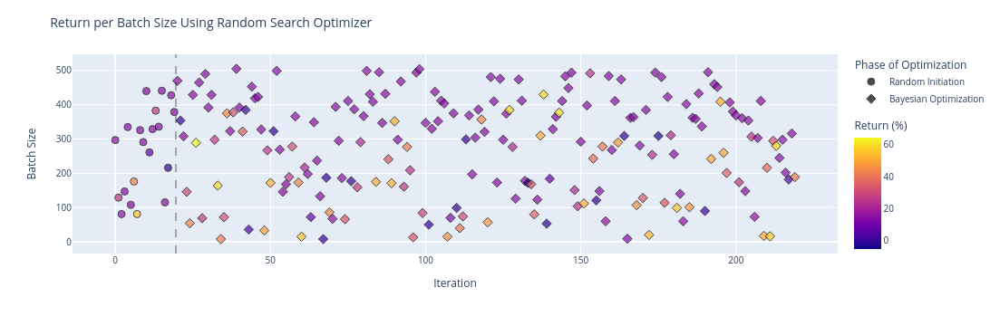

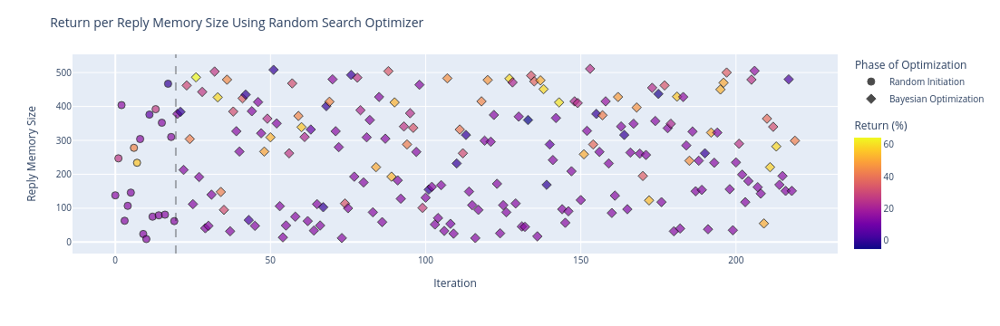

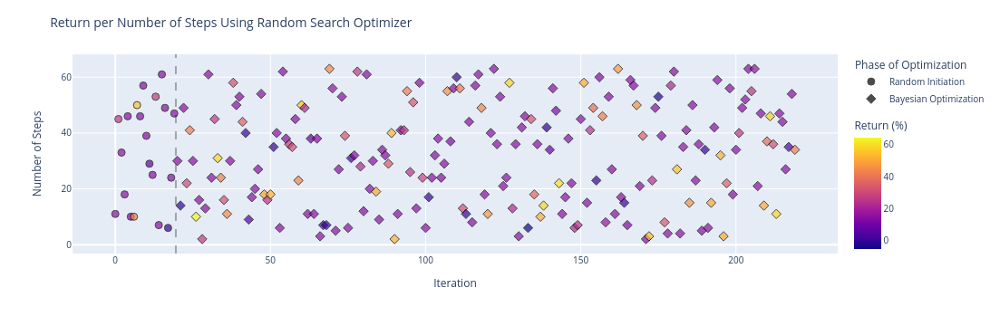

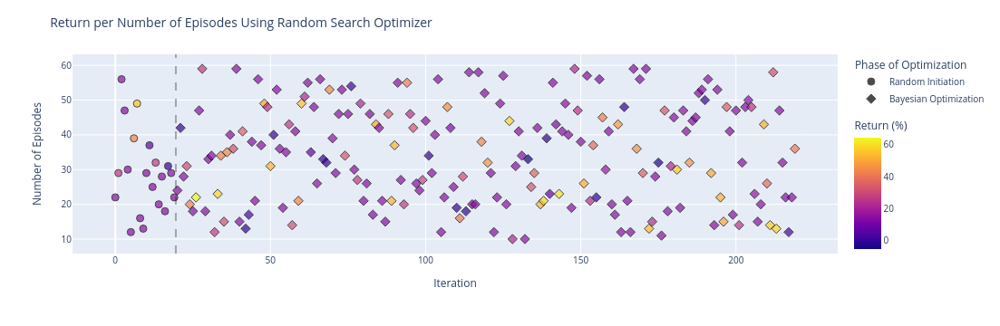

In [17]:
plot_hyperparams(params, optimizer, init_set)

In [8]:
# Imports Optimizer
from Optimizer.GPHedgeOptimizer import GP_HedgeBayesianOptimizer
set_random_seed(42)
eta=0.01

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/DQN-pattern/


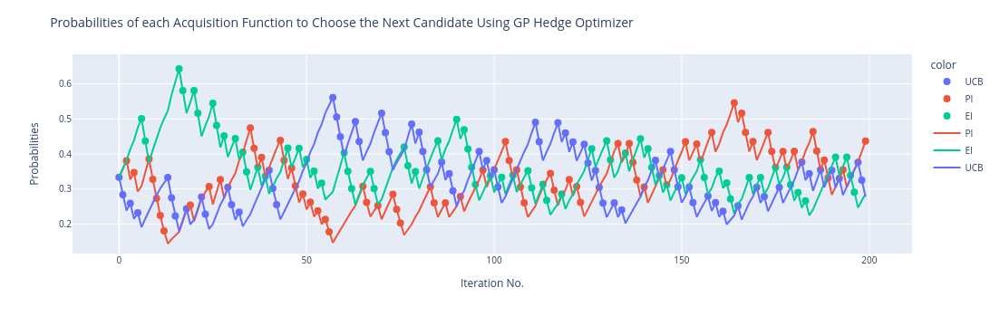

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/DQN-vanilla/


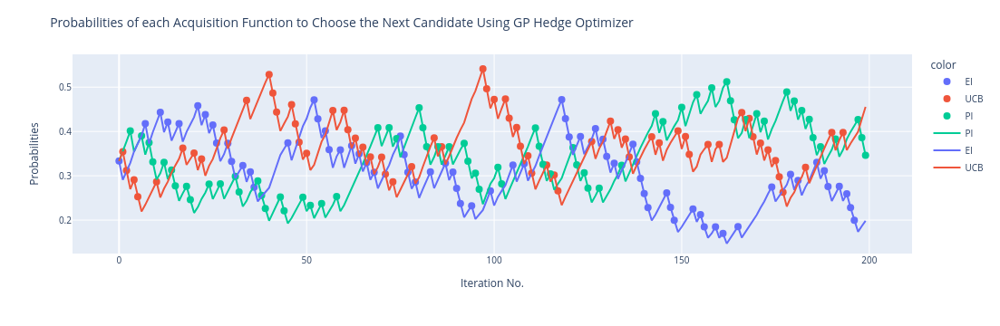

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/DQN-candlerep/


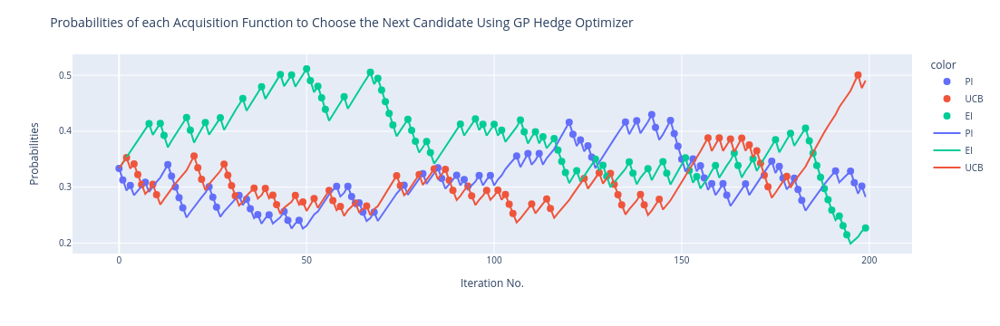

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/DQN-windowed/


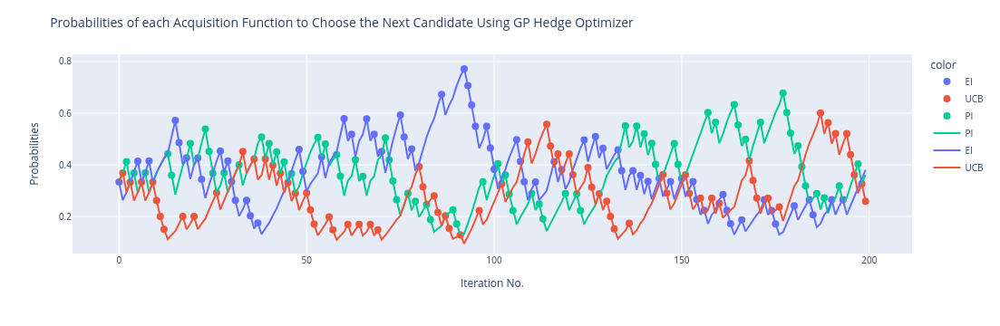

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/MLP-pattern/


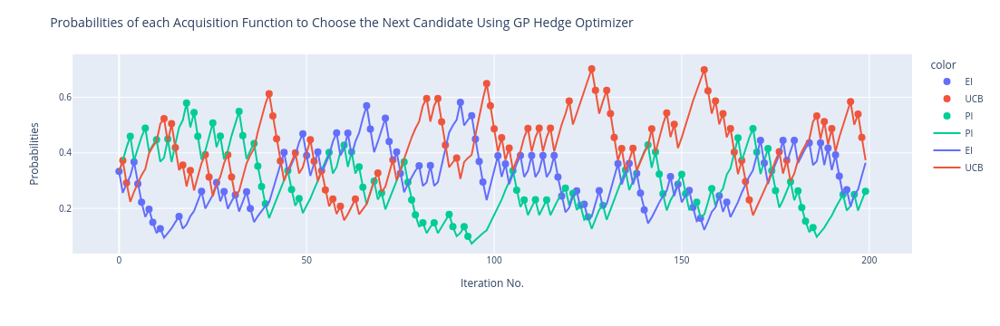

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/MLP-vanilla/


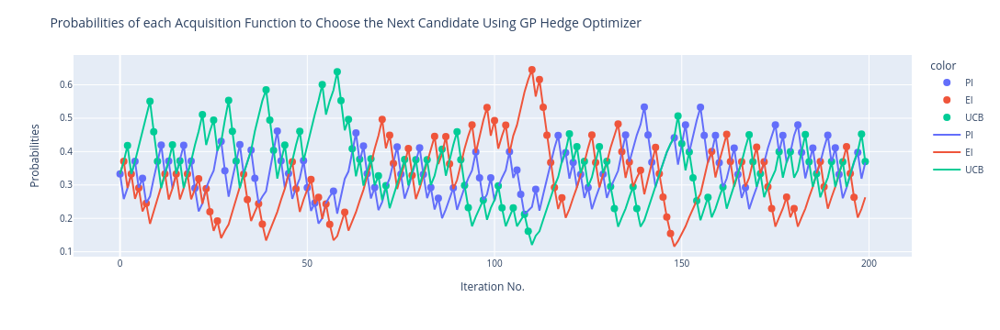

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/MLP-candlerep/


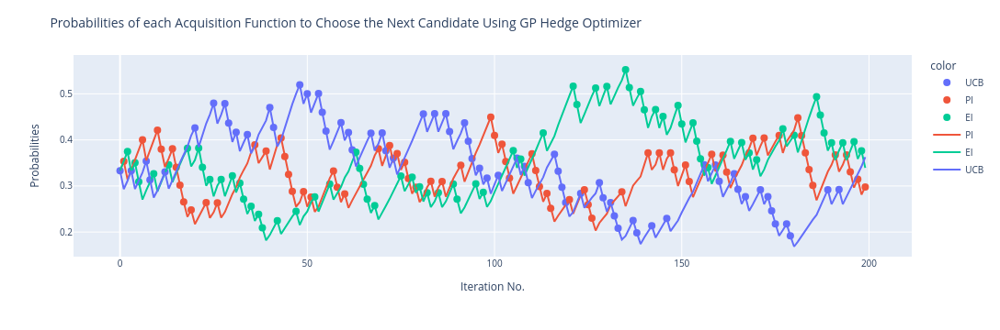

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/MLP-windowed/


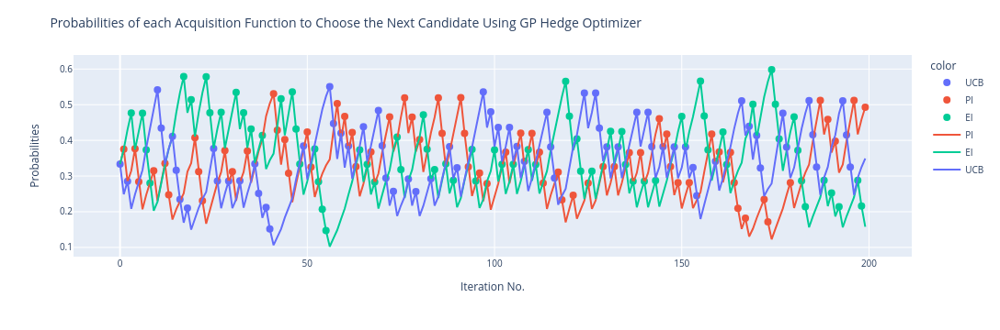

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/CNN1d/


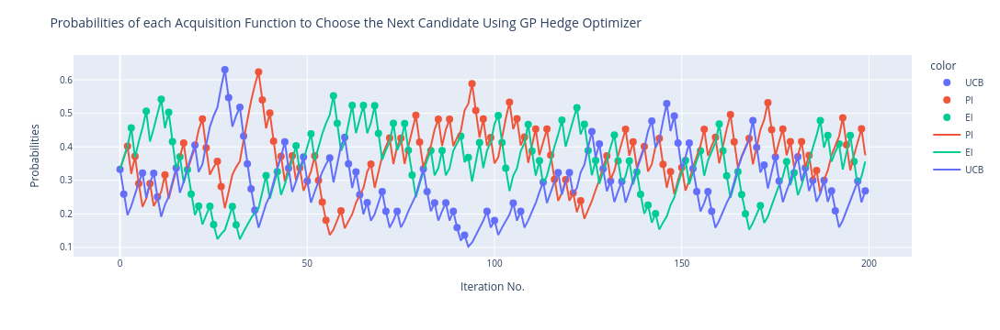

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/CNN2d/


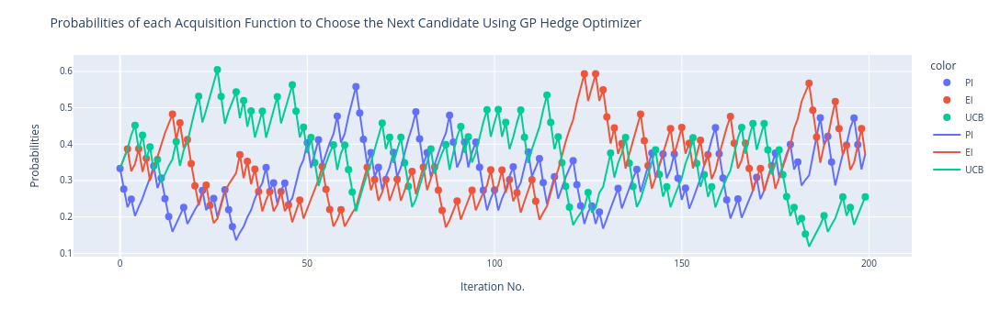

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/GRU/


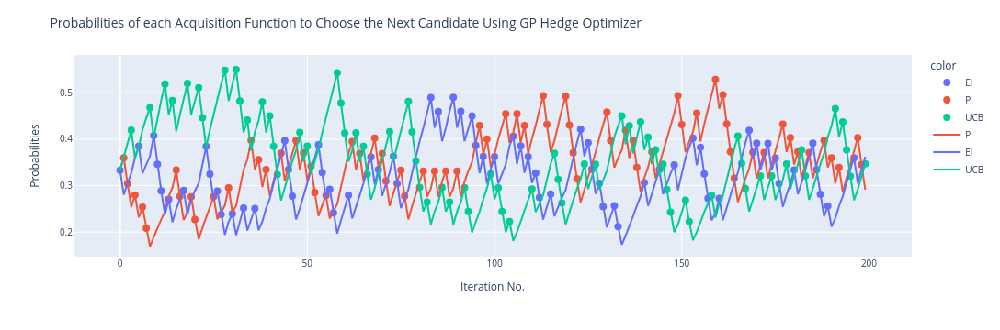

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/Deep-CNN/


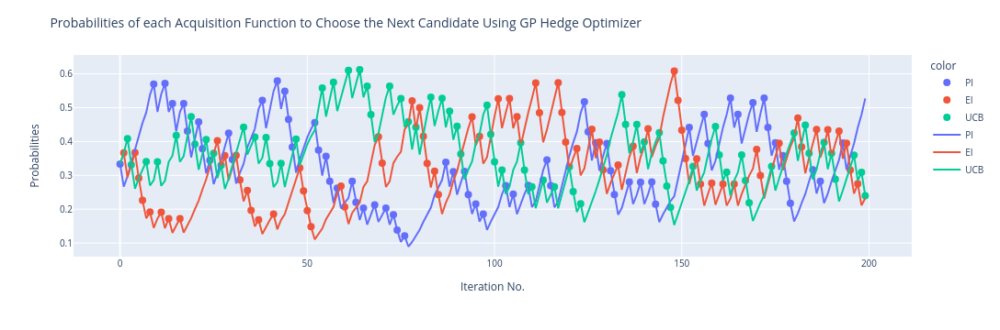

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/CNN-GRU/


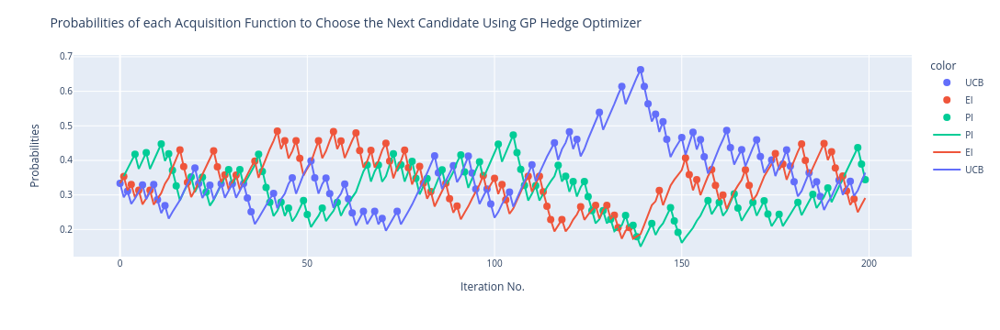

/home/say/Data/Sharif University of Technology/Lab/Thesis/HPOpt-DQN-Trading/run/GP Hedge_eta:0.01/CNN-ATTN/


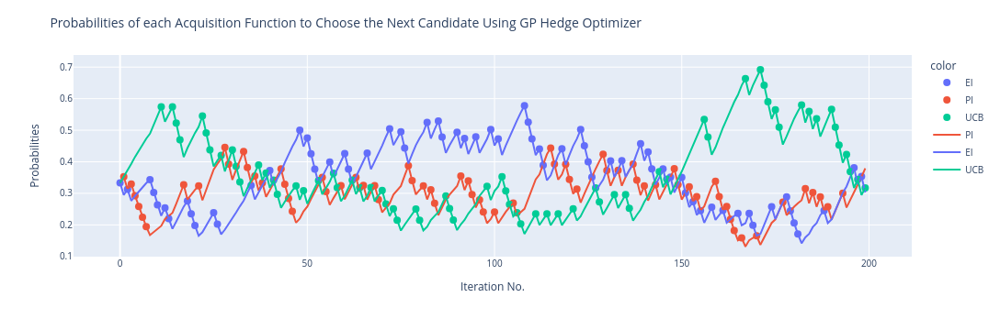

In [2]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='GP Hedge',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    optimizer = GP_HedgeBayesianOptimizer(objective_func, bounds, types, name='GP Hedge', eta=eta)
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

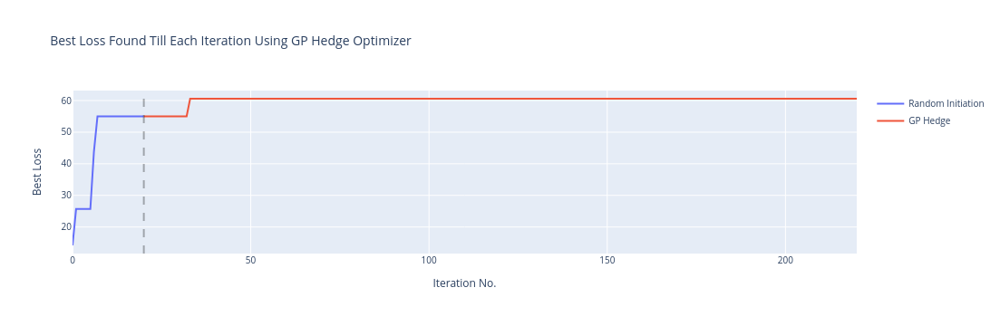

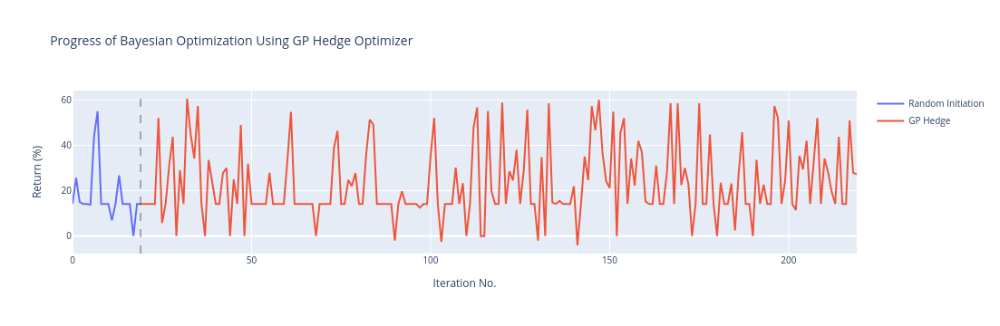

In [20]:
plot_optimization_progress(optimizer, init_set)

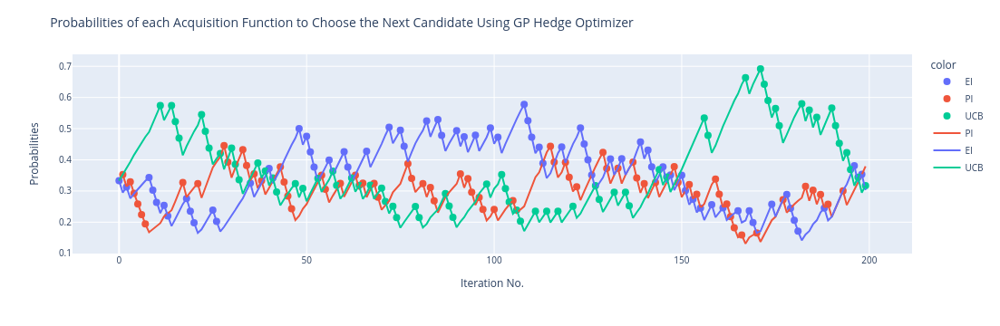

In [21]:
plot_prob_accusition(optimizer)

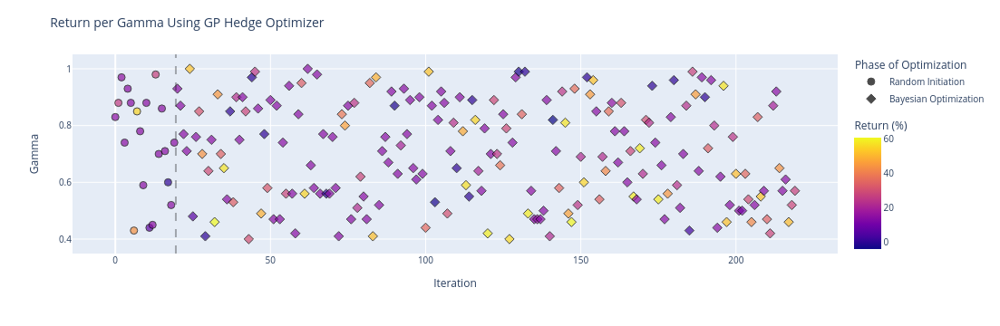

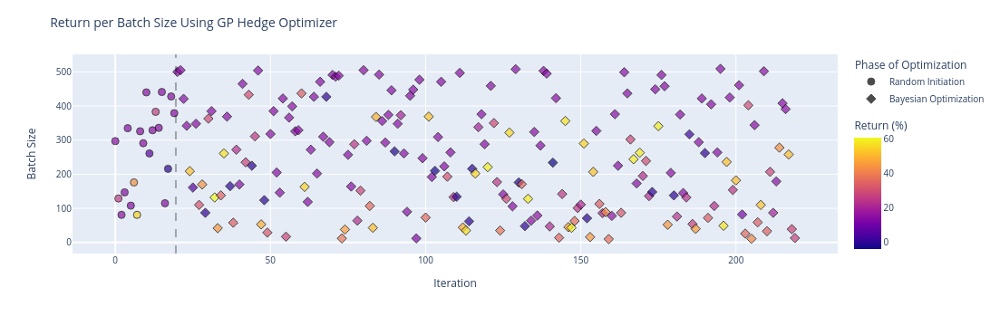

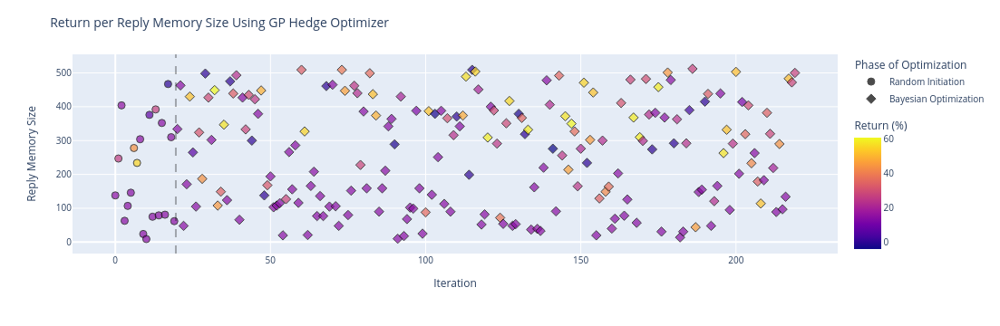

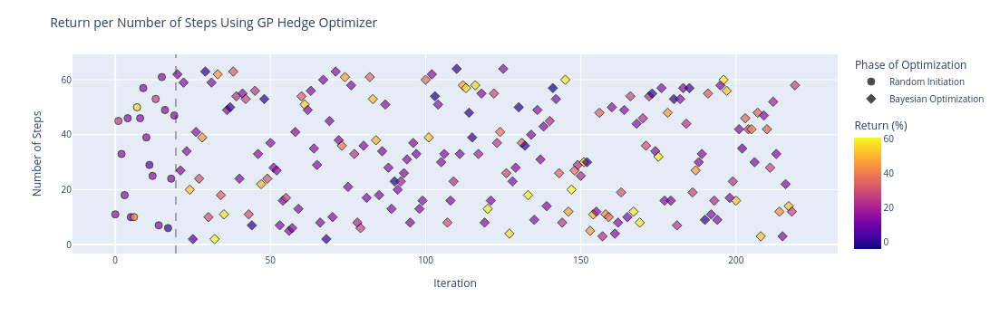

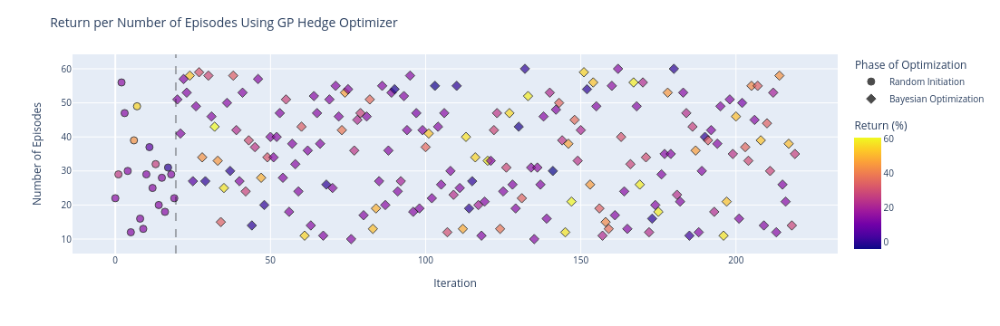

In [22]:
plot_hyperparams(params, optimizer, init_set)

In [23]:
# Imports Optimizer
from Optimizer.NoPastBayesianOptimizer import NoPastBayesianOptimizer
set_random_seed(42)
eta = 0.1
m = 0.8

In [24]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='No-Past-BO',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    optimizer = NoPastBayesianOptimizer(objective_func, bounds, types, name='No-Past-BO', eta=eta, m=m)
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}_m:{m}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}_m:{m}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:09<00:00,  2.40it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:16<00:00,  4.70s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:05<00:00,  4.39s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:18<00:00,  2.50it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.76it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:55<00:00,  4.65s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:24<00:00,  5.26s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:33<00:00,  4.36s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.74it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.79it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.59it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:36<00:00,  5.85s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.57it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:25<00:00,  6.42s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.68it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:11<00:00,  2.53it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.59it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:52<00:00,  5.55s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.69it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.56it/s]


Complete


  0%|                                                   | 0/200 [00:00<?, ?it/s]

tensor([  0.6480, 368.1453, 335.5674,   2.7525,  50.1132])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:24<00:00,  2.07it/s]


Complete


  0%|▏                                        | 1/200 [00:24<1:22:39, 24.92s/it]

tensor([  0.6871, 392.0824, 220.2702,  39.6222,  49.4801])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:21<00:00,  2.30it/s]


Complete


  1%|▍                                        | 2/200 [00:47<1:17:23, 23.45s/it]

tensor([  0.8617, 172.4130, 151.2871,  39.3604,  20.1316])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.85it/s]


Complete


  2%|▋                                          | 3/200 [00:55<53:45, 16.37s/it]

tensor([4.6042e-01, 4.8840e+02, 4.8061e+02, 3.7721e+01, 3.9934e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:14<00:00,  2.72it/s]


Complete


  2%|▊                                          | 4/200 [01:11<53:15, 16.31s/it]

tensor([  0.4486, 279.1722, 209.9136,  11.5159,  29.0275])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.85it/s]


Complete


  2%|█                                          | 5/200 [01:22<46:54, 14.43s/it]

tensor([  0.4674, 452.0252,  16.2826,  51.6885,  14.0677])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.35it/s]


Complete


  3%|█▎                                         | 6/200 [01:29<38:17, 11.84s/it]

tensor([  0.8459, 397.4713, 247.9579,  18.6377,  50.6979])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:20<00:00,  2.53it/s]


Complete


  4%|█▌                                         | 7/200 [01:50<47:37, 14.80s/it]

tensor([  0.5613, 383.6553, 405.5113,  27.6328,  18.0729])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [02:08<00:00,  7.14s/it]


Complete


  4%|█▋                                       | 8/200 [03:59<2:44:08, 51.29s/it]

tensor([  0.6796, 385.5977, 176.3280,   2.4227,  20.4865])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.67it/s]


Complete


  4%|█▊                                       | 9/200 [04:07<2:00:25, 37.83s/it]

tensor([  0.4327, 325.8446,  12.2773,  60.0832,  35.2019])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:11<00:00,  3.01it/s]


Complete


  5%|██                                      | 10/200 [04:20<1:34:59, 30.00s/it]

tensor([  0.6836, 418.2696, 449.3856,  41.7295,  29.6111])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [03:26<00:00,  6.88s/it]


Complete


  6%|██▏                                     | 11/200 [07:47<4:25:30, 84.29s/it]

tensor([  0.4854,  80.0505, 180.0596,  52.7262,  44.9389])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:16<00:00,  4.37s/it]


Complete


  6%|██▎                                    | 12/200 [11:05<6:12:23, 118.85s/it]

tensor([  0.7517, 118.9082, 298.2572,  23.4626,  34.3151])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:43<00:00,  4.80s/it]


Complete


  6%|██▌                                    | 13/200 [13:50<6:53:28, 132.67s/it]

tensor([  0.6139, 188.1867, 393.3687,  12.0959,  37.8558])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:28<00:00,  5.48s/it]


Complete


  7%|██▋                                    | 14/200 [17:19<8:03:03, 155.83s/it]

tensor([  0.9428, 372.9281, 136.1128,  24.1204,  39.9318])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.59it/s]


Complete


  8%|██▉                                    | 15/200 [17:35<5:50:48, 113.78s/it]

tensor([  0.8464, 200.5344, 264.6936,  26.4133,  23.3775])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:07<00:00,  5.53s/it]


Complete


  8%|███                                    | 16/200 [19:44<6:02:16, 118.13s/it]

tensor([  0.8990, 224.2697, 274.2906,  22.5545,  52.7804])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [04:59<00:00,  5.65s/it]


Complete


  8%|███▎                                   | 17/200 [24:44<8:47:17, 172.88s/it]

tensor([  0.5806, 419.8478, 119.5038,  33.6003,  43.1715])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:17<00:00,  2.50it/s]


Complete


  9%|███▌                                   | 18/200 [25:02<6:23:27, 126.41s/it]

tensor([  0.6361, 505.2011, 359.1022,  37.7498,  34.7500])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.70it/s]


Complete


 10%|███▊                                    | 19/200 [25:16<4:39:23, 92.62s/it]

tensor([  0.9986, 425.8168, 501.7027,   3.3568,  23.2678])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:47<00:00,  7.30s/it]


Complete


 10%|███▉                                   | 20/200 [28:05<5:46:34, 115.52s/it]

tensor([  0.6701, 337.0146, 498.5887,  58.8068,  34.1463])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [03:29<00:00,  6.17s/it]


Complete


 10%|████                                   | 21/200 [31:35<7:09:46, 144.06s/it]

tensor([  0.8132, 416.3220, 403.3822,  11.6591,  48.6402])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.57it/s]


Complete


 11%|████▎                                  | 22/200 [31:55<5:16:49, 106.80s/it]

tensor([  0.6247, 313.3954, 217.2635,  57.9654,  54.3053])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:24<00:00,  2.18it/s]


Complete


 12%|████▌                                   | 23/200 [32:21<4:03:19, 82.48s/it]

tensor([  0.8827, 508.3155, 410.0779,  54.0708,  23.0599])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:07<00:00,  2.93it/s]


Complete


 12%|████▊                                   | 24/200 [32:30<2:56:58, 60.33s/it]

tensor([  0.5898,  60.5214, 158.2820,  13.9196,  42.8319])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:14<00:00,  4.52s/it]


Complete


 12%|████▉                                  | 25/200 [35:45<4:53:54, 100.77s/it]

tensor([ 0.5790, 78.1052, 15.3642, 53.9917, 36.3406])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:14<00:00,  2.57it/s]


Complete


 13%|█████▏                                  | 26/200 [36:00<3:37:30, 75.00s/it]

tensor([  0.8934, 410.4552,  44.3965,  30.9928,  28.5029])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.85it/s]


Complete


 14%|█████▍                                  | 27/200 [36:11<2:40:56, 55.82s/it]

tensor([  0.6609,  79.5444, 264.5068,  63.7649,  10.5824])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:50<00:00,  4.55s/it]


Complete


 14%|█████▌                                  | 28/200 [37:02<2:36:00, 54.42s/it]

tensor([4.3390e-01, 4.6743e+02, 7.4413e+01, 3.1569e+01, 1.6912e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.76it/s]


Complete


 14%|█████▊                                  | 29/200 [37:09<1:54:31, 40.18s/it]

tensor([  0.7593, 105.7454, 365.0865,   2.1201,  44.5368])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:37<00:00,  4.84s/it]


Complete


 15%|██████                                  | 30/200 [40:48<4:25:31, 93.71s/it]

tensor([  0.9747, 359.6693, 292.6725,  12.1745,  14.9540])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.80it/s]


Complete


 16%|██████▏                                 | 31/200 [40:54<3:10:01, 67.46s/it]

tensor([  0.6563, 405.9405, 337.7161,  37.9130,  39.5718])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:17<00:00,  2.33it/s]


Complete


 16%|██████▍                                 | 32/200 [41:12<2:27:21, 52.63s/it]

tensor([ 0.4085, 43.8562, 66.1683, 45.8058, 19.1405])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:22<00:00,  4.35s/it]


Complete


 16%|██████▌                                 | 33/200 [42:35<2:52:20, 61.92s/it]

tensor([  0.5543,  64.6317, 506.4971,   8.7554,  16.3330])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:11<00:00,  4.48s/it]


Complete


 17%|██████▊                                 | 34/200 [43:48<3:00:06, 65.10s/it]

tensor([  0.6694, 128.2626,  43.8503,  63.8507,  52.5901])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:21<00:00,  2.49it/s]


Complete


 18%|███████                                 | 35/200 [44:10<2:23:38, 52.23s/it]

tensor([  0.6286, 448.3784, 445.3401,  11.8808,  24.1845])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:09<00:00,  2.57it/s]


Complete


 18%|███████▏                                | 36/200 [44:21<1:49:05, 39.91s/it]

tensor([  0.5435, 434.2990, 469.1441,   4.5226,  39.0702])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [04:49<00:00,  7.42s/it]


Complete


 18%|███████▏                               | 37/200 [49:13<5:13:22, 115.35s/it]

tensor([  0.9898,  54.1516, 438.4621,  21.2879,  22.2617])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:34<00:00,  4.29s/it]


Complete


 19%|███████▍                               | 38/200 [50:49<4:56:04, 109.66s/it]

tensor([  0.7077, 404.1833, 205.5683,  27.4270,  37.7572])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:16<00:00,  2.25it/s]


Complete


 20%|███████▊                                | 39/200 [51:07<3:40:14, 82.08s/it]

tensor([  0.4359, 133.3346,  94.6506,  20.6911,  57.7032])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:23<00:00,  2.43it/s]


Complete


 20%|████████                                | 40/200 [51:32<2:53:14, 64.96s/it]

tensor([  0.7276, 368.8196, 239.5973,  63.5846,  17.7004])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.50it/s]


Complete


 20%|████████▏                               | 41/200 [51:40<2:06:53, 47.88s/it]

tensor([  0.6432, 128.2789,  52.1862,  35.7152,  44.0723])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:18<00:00,  2.44it/s]


Complete


 21%|████████▍                               | 42/200 [51:59<1:43:15, 39.21s/it]

tensor([  0.7118, 310.5121, 367.7396,  30.1138,  19.6551])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [02:09<00:00,  6.46s/it]


Complete


 22%|████████▌                               | 43/200 [54:09<2:53:53, 66.46s/it]

tensor([  0.9361, 222.9442, 310.2123,  47.6531,  39.1653])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [03:32<00:00,  5.45s/it]


Complete


 22%|████████▌                              | 44/200 [57:42<4:47:32, 110.59s/it]

tensor([  0.7922, 175.3828, 307.9308,  53.5772,  49.1310])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:11<00:00,  5.13s/it]


Complete


 22%|████████▎                            | 45/200 [1:01:55<6:35:34, 153.13s/it]

tensor([  0.9322, 247.9337, 124.4669,  31.4564,  17.0695])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.47it/s]


Complete


 23%|████████▌                            | 46/200 [1:02:03<4:41:07, 109.53s/it]

tensor([  0.4893, 248.3471, 455.3932,  33.6462,  28.7921])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:46<00:00,  5.75s/it]


Complete


 24%|████████▋                            | 47/200 [1:04:50<5:23:56, 127.03s/it]

tensor([  0.5962, 493.6598, 389.4845,  16.6954,  55.3476])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:20<00:00,  2.74it/s]


Complete


 24%|█████████                             | 48/200 [1:05:11<4:01:14, 95.22s/it]

tensor([  0.7045, 264.7880, 121.4568,  25.1535,  32.3323])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:11<00:00,  2.89it/s]


Complete


 24%|█████████▎                            | 49/200 [1:05:23<2:56:45, 70.24s/it]

tensor([  0.9838, 269.1457, 209.4548,  38.3994,  49.9476])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:18<00:00,  2.73it/s]


Complete


 25%|█████████▌                            | 50/200 [1:05:43<2:17:19, 54.93s/it]

tensor([  0.4922,  68.6997, 110.8855,  20.3604,  23.9554])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [01:56<00:00,  4.84s/it]


Complete


 26%|█████████▋                            | 51/200 [1:07:40<3:02:38, 73.54s/it]

tensor([  0.5483, 452.7440, 284.1457,  17.1021,  28.5834])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:09<00:00,  2.91it/s]


Complete


 26%|█████████▉                            | 52/200 [1:07:51<2:15:10, 54.80s/it]

tensor([ 0.7345, 97.4094, 57.5505, 61.8279, 42.1361])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:14<00:00,  2.95it/s]


Complete


 26%|██████████                            | 53/200 [1:08:06<1:45:05, 42.90s/it]

tensor([  0.6538, 125.1786, 244.1712,   9.3086,  28.5680])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:24<00:00,  4.98s/it]


Complete


 27%|██████████▎                           | 54/200 [1:10:31<2:59:17, 73.68s/it]

tensor([  0.6068, 107.8788, 334.8835,  41.4503,  22.8930])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [01:48<00:00,  4.71s/it]


Complete


 28%|██████████▍                           | 55/200 [1:12:21<3:23:51, 84.36s/it]

tensor([  0.9741, 499.3123, 138.8445,   3.1521,  11.4787])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.46it/s]


Complete


 28%|██████████▋                           | 56/200 [1:12:26<2:25:37, 60.68s/it]

tensor([  0.4350, 113.3361, 433.3110,  59.4109,  33.2751])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [02:33<00:00,  4.64s/it]


Complete


 28%|██████████▊                           | 57/200 [1:15:00<3:31:23, 88.70s/it]

tensor([  0.8597, 214.8922, 349.7661,   5.7252,  44.1586])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [04:09<00:00,  5.67s/it]


Complete


 29%|██████████▋                          | 58/200 [1:19:11<5:25:20, 137.47s/it]

tensor([  0.5473, 126.3878, 225.2443,  26.1031,  59.7763])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [04:53<00:00,  4.88s/it]


Complete


 30%|██████████▉                          | 59/200 [1:24:05<7:13:31, 184.48s/it]

tensor([  0.5242, 323.4499, 446.9480,  46.8491,  32.6543])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [03:23<00:00,  6.18s/it]


Complete


 30%|███████████                          | 60/200 [1:27:30<7:24:40, 190.57s/it]

tensor([  0.5954, 469.8351, 313.9458,  11.0645,  30.1615])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:12<00:00,  2.46it/s]


Complete


 30%|███████████▎                         | 61/200 [1:27:43<5:18:09, 137.33s/it]

tensor([  0.8012, 274.3491, 290.2285,  34.2202,  16.1397])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:34<00:00,  5.88s/it]


Complete


 31%|███████████▍                         | 62/200 [1:29:18<4:46:36, 124.61s/it]

tensor([  0.4380, 123.9787,  30.3608,  43.3998,  16.4374])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.45it/s]


Complete


 32%|███████████▉                          | 63/200 [1:29:26<3:24:28, 89.55s/it]

tensor([  0.5844, 383.8898,  22.7523,  13.0279,  23.5050])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:10<00:00,  2.28it/s]


Complete


 32%|████████████▏                         | 64/200 [1:29:37<2:29:50, 66.10s/it]

tensor([  0.7597, 314.9293, 141.9691,  58.2360,  30.0015])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.92it/s]


Complete


 32%|████████████▎                         | 65/200 [1:29:49<1:51:51, 49.72s/it]

tensor([  0.7383,  65.8737, 464.6212,  49.1700,  19.9068])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:30<00:00,  4.51s/it]


Complete


 33%|████████████▌                         | 66/200 [1:31:20<2:18:50, 62.17s/it]

tensor([  0.9674, 318.7018, 308.8557,  63.9594,  24.0205])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:09<00:00,  2.42it/s]


Complete


 34%|████████████▋                         | 67/200 [1:31:31<1:43:50, 46.85s/it]

tensor([  0.5108, 216.6430, 258.4822,  21.8522,  46.9262])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [04:22<00:00,  5.60s/it]


Complete


 34%|████████████▌                        | 68/200 [1:35:55<4:06:27, 112.02s/it]

tensor([  0.5470,  93.7636, 301.8705,  33.1156,  24.5927])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [01:56<00:00,  4.67s/it]


Complete


 34%|████████████▊                        | 69/200 [1:37:53<4:08:20, 113.75s/it]

tensor([  0.9497, 125.9571, 396.6349,  40.4383,  26.7381])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:09<00:00,  4.79s/it]


Complete


 35%|████████████▉                        | 70/200 [1:40:04<4:17:19, 118.77s/it]

tensor([  0.9051, 261.0193, 414.6263,  53.5674,  20.2408])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:53<00:00,  5.69s/it]


Complete


 36%|█████████████▏                       | 71/200 [1:41:58<4:12:47, 117.58s/it]

tensor([  0.9557,  36.9819, 368.6542,  10.4747,  18.8046])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:20<00:00,  4.26s/it]


Complete


 36%|█████████████▎                       | 72/200 [1:43:21<3:48:15, 107.00s/it]

tensor([  0.6745, 483.5135, 495.9695,  51.1345,  26.9435])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [03:15<00:00,  7.24s/it]


Complete


 36%|█████████████▌                       | 73/200 [1:46:37<4:43:14, 133.81s/it]

tensor([  0.9845, 151.7712, 373.5676,  41.9842,  52.4522])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:22<00:00,  5.04s/it]


Complete


 37%|█████████████▋                       | 74/200 [1:51:00<6:02:26, 172.59s/it]

tensor([  0.4846,  16.0384, 342.2109,  48.3011,  38.9654])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [02:33<00:00,  3.93s/it]


Complete


 38%|█████████████▉                       | 75/200 [1:53:35<5:48:11, 167.13s/it]

tensor([  0.9495,  70.0558, 111.7214,  14.8879,  56.5017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [04:26<00:00,  4.68s/it]


Complete


 38%|██████████████                       | 76/200 [1:58:02<6:47:54, 197.37s/it]

tensor([  0.7221, 372.7682, 291.1176,  42.0649,  56.2226])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:23<00:00,  2.42it/s]


Complete


 38%|██████████████▏                      | 77/200 [1:58:27<4:58:02, 145.38s/it]

tensor([  0.5692, 466.6744,  33.9913,  48.8408,  42.1572])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:16<00:00,  2.53it/s]


Complete


 39%|██████████████▍                      | 78/200 [1:58:44<3:37:34, 107.00s/it]

tensor([  0.4382, 255.8832, 222.3739,  23.4085,  18.2171])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.34it/s]


Complete


 40%|███████████████                       | 79/200 [1:58:53<2:36:15, 77.48s/it]

tensor([  0.5138, 411.1308, 439.8050,  38.4202,  15.6266])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:56<00:00,  7.30s/it]


Complete


 40%|███████████████▏                      | 80/200 [2:00:50<2:59:13, 89.61s/it]

tensor([  0.9283, 214.4782, 286.2827,  17.3040,  17.7606])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:45<00:00,  5.85s/it]


Complete


 40%|███████████████▍                      | 81/200 [2:02:37<3:07:37, 94.60s/it]

tensor([  0.8910, 251.1014, 477.1640,  54.3519,  34.5241])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:17<00:00,  5.64s/it]


Complete


 41%|███████████████▏                     | 82/200 [2:05:55<4:07:07, 125.66s/it]

tensor([  0.4037, 189.7963, 209.8415,  30.7763,  28.5794])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:35<00:00,  5.35s/it]


Complete


 42%|███████████████▎                     | 83/200 [2:08:31<4:22:51, 134.80s/it]

tensor([  0.4194, 212.6181, 352.8609,  32.4176,  30.4171])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:44<00:00,  5.49s/it]


Complete


 42%|███████████████▌                     | 84/200 [2:11:17<4:38:29, 144.05s/it]

tensor([  0.7136, 361.3337, 170.4846,  55.1770,  59.7948])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:22<00:00,  2.72it/s]


Complete


 42%|███████████████▋                     | 85/200 [2:11:40<3:26:27, 107.72s/it]

tensor([  0.9172, 188.4387, 335.9571,  21.8011,  28.9021])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:38<00:00,  5.45s/it]


Complete


 43%|███████████████▉                     | 86/200 [2:14:19<3:53:55, 123.12s/it]

tensor([  0.7646, 380.1740, 471.2024,   3.1876,  16.1212])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:48<00:00,  6.76s/it]


Complete


 44%|████████████████                     | 87/200 [2:16:08<3:44:10, 119.04s/it]

tensor([  0.9363, 380.7456, 458.8571,  26.5579,  10.7593])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [01:11<00:00,  6.48s/it]


Complete


 44%|████████████████▎                    | 88/200 [2:17:21<3:16:22, 105.20s/it]

tensor([  0.7134, 274.0462, 249.6873,  16.3140,  34.3603])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:12<00:00,  2.82it/s]


Complete


 44%|████████████████▉                     | 89/200 [2:17:34<2:23:23, 77.51s/it]

tensor([  0.7127, 204.1234, 283.9840,  60.6584,  56.6323])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [05:07<00:00,  5.40s/it]


Complete


 45%|████████████████▋                    | 90/200 [2:22:43<4:29:18, 146.90s/it]

tensor([  0.5811, 286.1609, 339.5931,   4.2913,  20.2686])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [02:01<00:00,  6.06s/it]


Complete


 46%|████████████████▊                    | 91/200 [2:24:45<4:13:31, 139.55s/it]

tensor([  0.4832, 444.6389,  81.1553,  27.7459,  43.2922])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:15<00:00,  2.76it/s]


Complete


 46%|█████████████████                    | 92/200 [2:25:02<3:04:47, 102.66s/it]

tensor([  0.8334, 476.5270, 230.9170,  19.9962,  54.5816])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:20<00:00,  2.71it/s]


Complete


 46%|█████████████████▋                    | 93/200 [2:25:23<2:19:28, 78.21s/it]

tensor([  0.7001, 295.0847, 209.7165,  55.1171,  13.1927])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.77it/s]


Complete


 47%|█████████████████▊                    | 94/200 [2:25:29<1:39:42, 56.44s/it]

tensor([  0.8754, 220.0933, 457.9965,  54.4990,  45.7884])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [04:16<00:00,  5.59s/it]


Complete


 48%|█████████████████▌                   | 95/200 [2:29:46<3:24:32, 116.88s/it]

tensor([  0.7441, 194.0617, 218.4147,  17.4667,  35.3800])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [03:10<00:00,  5.45s/it]


Complete


 48%|█████████████████▊                   | 96/200 [2:32:58<4:01:30, 139.33s/it]

tensor([  0.9690, 119.1586, 488.7992,  26.0905,  34.1849])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:44<00:00,  4.84s/it]


Complete


 48%|█████████████████▉                   | 97/200 [2:35:44<4:12:34, 147.13s/it]

tensor([  0.4624,  81.2831, 168.6575,  39.5315,  53.1255])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [03:57<00:00,  4.49s/it]


Complete


 49%|██████████████████▏                  | 98/200 [2:39:42<4:56:51, 174.62s/it]

tensor([  0.9333, 239.7952, 427.3714,  20.3066,  13.0165])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:14<00:00,  5.69s/it]


Complete


 50%|██████████████████▎                  | 99/200 [2:40:57<4:03:41, 144.76s/it]

tensor([  0.7294, 258.5807, 289.0845,   4.5985,  19.8056])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:59<00:00,  5.96s/it]


Complete


 50%|██████████████████                  | 100/200 [2:42:58<3:49:03, 137.44s/it]

tensor([  0.6073, 438.2407, 261.2149,   6.3339,  12.0198])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.35it/s]


Complete


 50%|██████████████████▋                  | 101/200 [2:43:04<2:41:51, 98.09s/it]

tensor([  0.4799, 469.7310, 234.0695,  54.5489,  35.6471])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:13<00:00,  2.62it/s]


Complete


 51%|██████████████████▊                  | 102/200 [2:43:19<1:59:21, 73.07s/it]

tensor([  0.5886, 137.4257, 272.3041,  53.0438,  20.6269])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:44<00:00,  4.98s/it]


Complete


 52%|███████████████████                  | 103/200 [2:45:05<2:14:02, 82.92s/it]

tensor([  0.7012, 116.8347, 137.5238,  50.9469,  29.2739])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:16<00:00,  4.69s/it]


Complete


 52%|███████████████████▏                 | 104/200 [2:47:22<2:38:45, 99.23s/it]

tensor([  0.7586, 119.7826,  91.5779,  57.7416,  56.3173])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:19<00:00,  2.92it/s]


Complete


 52%|███████████████████▍                 | 105/200 [2:47:42<1:59:34, 75.52s/it]

tensor([  0.6122, 483.3675, 347.9460,  47.5940,  41.8556])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:14<00:00,  2.93it/s]


Complete


 53%|███████████████████▌                 | 106/200 [2:47:57<1:29:59, 57.44s/it]

tensor([  0.5414, 250.8092, 369.1189,  52.5937,  31.9631])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:12<00:00,  6.01s/it]


Complete


 54%|███████████████████▊                 | 107/200 [2:51:11<2:32:24, 98.33s/it]

tensor([  0.6788,  64.8462, 353.4486,  56.3992,  55.6767])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [04:01<00:00,  4.32s/it]


Complete


 54%|███████████████████▍                | 108/200 [2:55:14<3:37:11, 141.65s/it]

tensor([  0.4767, 434.5583, 296.3645,  35.3617,  25.4098])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.91it/s]


Complete


 55%|███████████████████▌                | 109/200 [2:55:24<2:34:57, 102.17s/it]

tensor([  0.5058, 112.1759, 278.5376,  33.2425,  44.5704])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:37<00:00,  4.84s/it]


Complete


 55%|███████████████████▊                | 110/200 [2:59:03<3:25:44, 137.16s/it]

tensor([  0.9463, 202.5527, 270.4442,  61.4215,  24.6144])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:12<00:00,  5.30s/it]


Complete


 56%|███████████████████▉                | 111/200 [3:01:16<3:21:52, 136.10s/it]

tensor([  0.5355, 358.5827, 475.8189,  53.8965,  49.3033])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [05:15<00:00,  6.44s/it]


Complete


 56%|████████████████████▏               | 112/200 [3:06:33<4:39:07, 190.31s/it]

tensor([  0.6536, 449.6789, 477.8664,  20.9026,  36.3982])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [04:24<00:00,  7.34s/it]


Complete


 56%|████████████████████▎               | 113/200 [3:10:59<5:08:38, 212.85s/it]

tensor([  0.6562, 362.4413, 122.8502,  28.0742,  55.4716])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:23<00:00,  2.37it/s]


Complete


 57%|████████████████████▌               | 114/200 [3:11:23<3:43:57, 156.25s/it]

tensor([  0.9874, 347.5797, 221.4307,  56.8288,  13.9346])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.64it/s]


Complete


 57%|████████████████████▋               | 115/200 [3:11:29<2:37:35, 111.24s/it]

tensor([  0.4802, 169.0155, 328.4584,  53.0582,  23.8905])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:04<00:00,  5.19s/it]


Complete


 58%|████████████████████▉               | 116/200 [3:13:34<2:41:39, 115.48s/it]

tensor([  0.5280, 216.7941, 106.0061,  14.8292,  32.8421])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:14<00:00,  2.21it/s]


Complete


 58%|█████████████████████▋               | 117/200 [3:13:50<1:58:24, 85.59s/it]

tensor([  0.7272,  23.2430, 452.9867,  37.1736,  32.5380])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [02:11<00:00,  4.00s/it]


Complete


 59%|█████████████████████▊               | 118/200 [3:16:04<2:16:33, 99.93s/it]

tensor([  0.5633, 379.4646,  37.1182,  24.5467,  36.8755])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:14<00:00,  2.50it/s]


Complete


 60%|██████████████████████               | 119/200 [3:16:19<1:40:51, 74.70s/it]

tensor([  0.4661, 281.5629, 436.3869,  57.1916,  30.1575])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:56<00:00,  5.89s/it]


Complete


 60%|█████████████████████▌              | 120/200 [3:19:17<2:20:49, 105.62s/it]

tensor([  0.9419, 219.9872, 422.7304,  23.2341,  14.0095])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:19<00:00,  5.69s/it]


Complete


 60%|██████████████████████▍              | 121/200 [3:20:38<2:09:13, 98.15s/it]

tensor([  0.6670, 163.5987, 204.7002,  16.2701,  53.6636])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:45<00:00,  5.28s/it]


Complete


 61%|█████████████████████▉              | 122/200 [3:25:24<3:20:52, 154.52s/it]

tensor([  0.5144, 184.0458, 109.4621,  16.8095,  40.3672])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.51it/s]


Complete


 62%|██████████████████████▏             | 123/200 [3:25:41<2:25:19, 113.24s/it]

tensor([  0.8210, 466.8566, 217.4714,  38.8079,  50.5626])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:21<00:00,  2.39it/s]


Complete


 62%|██████████████████████▉              | 124/200 [3:26:03<1:48:50, 85.93s/it]

tensor([  0.4962, 194.0195, 427.8987,  55.6370,  21.4749])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:57<00:00,  5.62s/it]


Complete


 62%|███████████████████████▏             | 125/200 [3:28:02<1:59:50, 95.87s/it]

tensor([  0.8720,  97.0821, 377.9337,  28.6442,  37.3712])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [02:52<00:00,  4.66s/it]


Complete


 63%|██████████████████████▋             | 126/200 [3:30:56<2:26:59, 119.19s/it]

tensor([  0.4112, 240.9537, 228.5525,  30.2817,  13.4663])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.94it/s]


Complete


 64%|███████████████████████▍             | 127/200 [3:31:01<1:43:29, 85.06s/it]

tensor([  0.9210, 346.4519,  51.6319,   6.5497,  29.2152])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:13<00:00,  2.18it/s]


Complete


 64%|███████████████████████▋             | 128/200 [3:31:15<1:16:36, 63.84s/it]

tensor([  0.5762, 401.2311, 488.3703,  40.9686,  14.8725])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:43<00:00,  6.90s/it]


Complete


 64%|███████████████████████▊             | 129/200 [3:33:00<1:29:57, 76.03s/it]

tensor([  0.5355, 453.1598, 289.7711,  35.1709,  11.9609])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.19it/s]


Complete


 65%|████████████████████████             | 130/200 [3:33:06<1:04:20, 55.15s/it]

tensor([  0.9632, 189.2388, 337.7702,  54.6498,  25.0350])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:11<00:00,  5.27s/it]


Complete


 66%|████████████████████████▏            | 131/200 [3:35:19<1:30:11, 78.43s/it]

tensor([  0.6778, 308.8357, 240.5590,  19.9308,  20.1157])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.25it/s]


Complete


 66%|████████████████████████▍            | 132/200 [3:35:29<1:05:32, 57.84s/it]

tensor([  0.6262, 128.3247, 467.7524,  49.1035,  47.7098])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [03:49<00:00,  4.79s/it]


Complete


 66%|███████████████████████▉            | 133/200 [3:39:20<2:02:31, 109.73s/it]

tensor([  0.5091, 273.2983, 403.2375,  24.7104,  30.5830])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:05<00:00,  5.98s/it]


Complete


 67%|████████████████████████            | 134/200 [3:42:26<2:25:56, 132.67s/it]

tensor([  0.8607, 465.0271, 420.6513,  37.7832,  29.5968])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:11<00:00,  2.62it/s]


Complete


 68%|████████████████████████▉            | 135/200 [3:42:38<1:44:37, 96.58s/it]

tensor([  0.8553, 158.7189,  60.6933,  33.2904,  33.4622])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:11<00:00,  2.84it/s]


Complete


 68%|█████████████████████████▏           | 136/200 [3:42:51<1:16:07, 71.37s/it]

tensor([  0.8178, 399.2386, 487.6378,  37.9737,  14.8471])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:45<00:00,  7.05s/it]


Complete


 68%|█████████████████████████▎           | 137/200 [3:44:37<1:26:03, 81.96s/it]

tensor([  0.6899, 244.5533, 317.7182,  20.3564,  18.5717])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:50<00:00,  5.82s/it]


Complete


 69%|█████████████████████████▌           | 138/200 [3:46:29<1:33:55, 90.89s/it]

tensor([  0.8199,  73.6840, 132.9377,  42.2745,  31.9204])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:21<00:00,  4.43s/it]


Complete


 70%|█████████████████████████           | 139/200 [3:48:52<1:48:11, 106.43s/it]

tensor([  0.9047, 269.1107, 367.8477,  57.0236,  57.6314])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [05:31<00:00,  5.71s/it]


Complete


 70%|█████████████████████████▏          | 140/200 [3:54:24<2:54:11, 174.19s/it]

tensor([  0.7342, 311.4713,  52.1512,  50.1381,  17.7456])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.62it/s]


Complete


 70%|█████████████████████████▍          | 141/200 [3:54:32<2:02:13, 124.29s/it]

tensor([  0.4058, 334.5331, 303.7352,  56.4731,  54.1676])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:20<00:00,  2.66it/s]


Complete


 71%|██████████████████████████▎          | 142/200 [3:54:53<1:30:16, 93.39s/it]

tensor([  0.6108, 340.1095,  19.0921,   6.5645,  43.8282])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.54it/s]


Complete


 72%|██████████████████████████▍          | 143/200 [3:55:12<1:07:20, 70.88s/it]

tensor([  0.9825,  18.2585, 292.0067,  49.0553,  20.2003])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:20<00:00,  4.04s/it]


Complete


 72%|██████████████████████████▋          | 144/200 [3:56:34<1:09:14, 74.18s/it]

tensor([  0.7800, 485.0727, 124.8644,  13.6434,  19.2121])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:08<00:00,  2.13it/s]


Complete


 72%|████████████████████████████▎          | 145/200 [3:56:43<50:19, 54.90s/it]

tensor([  0.7859, 166.3538, 110.1655,  14.6157,  46.6872])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:16<00:00,  2.79it/s]


Complete


 73%|████████████████████████████▍          | 146/200 [3:57:01<39:24, 43.78s/it]

tensor([  0.7224, 293.5359, 461.1886,   2.4877,  42.6764])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:37<00:00,  6.45s/it]


Complete


 74%|██████████████████████████▍         | 147/200 [4:01:40<1:40:51, 114.18s/it]

tensor([  0.4116, 175.2618, 383.4479,  30.9551,  20.2385])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:44<00:00,  5.24s/it]


Complete


 74%|██████████████████████████▋         | 148/200 [4:03:26<1:36:47, 111.69s/it]

tensor([  0.9813,  27.2958, 257.7890,  38.5996,  51.4419])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [03:27<00:00,  4.07s/it]


Complete


 74%|██████████████████████████▊         | 149/200 [4:06:54<1:59:41, 140.81s/it]

tensor([ 0.7910, 92.8137, 19.8050, 59.2426, 38.7298])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:16<00:00,  2.41it/s]


Complete


 75%|███████████████████████████         | 150/200 [4:07:12<1:26:27, 103.75s/it]

tensor([ 0.8835, 92.2405, 88.8732, 11.1200, 51.7863])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:18<00:00,  2.76it/s]


Complete


 76%|███████████████████████████▉         | 151/200 [4:07:32<1:04:10, 78.59s/it]

tensor([  0.7360, 500.9347,  51.9127,  20.7995,  40.7301])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:18<00:00,  2.21it/s]


Complete


 76%|█████████████████████████████▋         | 152/200 [4:07:51<48:42, 60.89s/it]

tensor([  0.6562, 175.5826, 434.8612,  12.2221,  41.5485])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:50<00:00,  5.50s/it]


Complete


 76%|███████████████████████████▌        | 153/200 [4:11:43<1:27:55, 112.24s/it]

tensor([  0.5134, 202.7990, 327.3851,  20.7116,  18.2051])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:38<00:00,  5.49s/it]


Complete


 77%|███████████████████████████▋        | 154/200 [4:13:23<1:23:15, 108.59s/it]

tensor([  0.6705, 252.6793, 499.9681,  11.0209,  55.1585])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [05:27<00:00,  5.95s/it]


Complete


 78%|███████████████████████████▉        | 155/200 [4:18:52<2:10:52, 174.50s/it]

tensor([  0.5032, 363.4900, 236.6147,  58.2217,  31.0478])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:11<00:00,  2.72it/s]


Complete


 78%|████████████████████████████        | 156/200 [4:19:04<1:32:19, 125.89s/it]

tensor([  0.8889, 163.4800, 492.8156,  35.0788,  29.9912])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:35<00:00,  5.17s/it]


Complete


 78%|████████████████████████████▎       | 157/200 [4:21:40<1:36:44, 134.98s/it]

tensor([  0.6064,  63.3312, 464.2897,  35.0418,  40.5489])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:00<00:00,  4.41s/it]


Complete


 79%|████████████████████████████▍       | 158/200 [4:24:42<1:44:22, 149.11s/it]

tensor([  0.9181, 236.2037, 125.9957,  37.4070,  24.5231])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.72it/s]


Complete


 80%|████████████████████████████▌       | 159/200 [4:24:52<1:13:25, 107.44s/it]

tensor([  0.6361, 381.2764, 475.5600,  54.9361,  50.6101])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [05:37<00:00,  6.62s/it]


Complete


 80%|████████████████████████████▊       | 160/200 [4:30:31<1:57:54, 176.85s/it]

tensor([  0.4617, 139.1712, 400.4949,  20.2838,  55.0190])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [04:43<00:00,  5.15s/it]


Complete


 80%|████████████████████████████▉       | 161/200 [4:35:15<2:15:52, 209.03s/it]

tensor([  0.7801, 137.8654, 213.2138,  29.9504,  58.2826])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:49<00:00,  5.00s/it]


Complete


 81%|█████████████████████████████▏      | 162/200 [4:40:06<2:27:57, 233.61s/it]

tensor([  0.9559, 347.8655, 247.6713,  13.3952,  29.0303])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.66it/s]


Complete


 82%|█████████████████████████████▎      | 163/200 [4:40:18<1:43:03, 167.12s/it]

tensor([  0.4896, 377.8623, 353.7903,  17.0178,  43.7129])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:16<00:00,  2.66it/s]


Complete


 82%|█████████████████████████████▌      | 164/200 [4:40:36<1:13:20, 122.24s/it]

tensor([  0.7034, 149.9991, 377.6342,  52.1675,  12.3815])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:02<00:00,  5.23s/it]


Complete


 82%|█████████████████████████████▋      | 165/200 [4:41:40<1:01:04, 104.71s/it]

tensor([  0.7202, 249.5877,  10.6654,  28.0300,  32.6864])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:11<00:00,  2.89it/s]


Complete


 83%|████████████████████████████████▎      | 166/200 [4:41:52<43:39, 77.03s/it]

tensor([  0.7435, 253.7936, 238.5519,  13.6670,  23.5301])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.67it/s]


Complete


 84%|████████████████████████████████▌      | 167/200 [4:42:02<31:19, 56.95s/it]

tensor([  0.8859, 366.6845, 315.6129,  43.0298,  52.8374])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:18<00:00,  2.90it/s]


Complete


 84%|████████████████████████████████▊      | 168/200 [4:42:22<24:21, 45.67s/it]

tensor([  0.9329, 120.3375, 300.3993,  53.1381,  36.8192])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [02:59<00:00,  4.86s/it]


Complete


 84%|████████████████████████████████▉      | 169/200 [4:45:22<44:33, 86.24s/it]

tensor([  0.9299,  45.2180, 194.3125,  61.0848,  46.7260])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:14<00:00,  4.13s/it]


Complete


 85%|████████████████████████████████▎     | 170/200 [4:48:38<59:27, 118.91s/it]

tensor([  0.7876,  97.0235, 194.4879,  46.7095,  46.8954])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:34<00:00,  4.56s/it]


Complete


 86%|██████████████████████████████▊     | 171/200 [4:52:13<1:11:26, 147.82s/it]

tensor([  0.5498, 142.8834, 251.1241,  63.0882,  29.0395])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [02:23<00:00,  4.95s/it]


Complete


 86%|██████████████████████████████▉     | 172/200 [4:54:38<1:08:33, 146.90s/it]

tensor([  0.6303, 497.0092, 380.5052,   6.5328,  34.0255])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:14<00:00,  2.28it/s]


Complete


 86%|████████████████████████████████▊     | 173/200 [4:54:54<48:26, 107.66s/it]

tensor([  0.7944, 155.1834, 235.0754,  39.4273,  30.8125])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:37<00:00,  5.08s/it]


Complete


 87%|█████████████████████████████████     | 174/200 [4:57:32<53:16, 122.96s/it]

tensor([  0.4283, 228.2859, 223.5686,   3.7365,  20.3659])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.80it/s]


Complete


 88%|██████████████████████████████████▏    | 175/200 [4:57:41<36:53, 88.55s/it]

tensor([  0.8615, 264.0950, 191.7458,  41.9904,  15.6070])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.52it/s]


Complete


 88%|██████████████████████████████████▎    | 176/200 [4:57:48<25:42, 64.25s/it]

tensor([  0.5955, 205.5929, 137.5655,  45.7805,  10.2122])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:03<00:00,  3.04it/s]


Complete


 88%|██████████████████████████████████▌    | 177/200 [4:57:53<17:45, 46.32s/it]

tensor([  0.8165,  32.6730, 134.9555,  43.7230,  45.7777])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [03:12<00:00,  4.19s/it]


Complete


 89%|██████████████████████████████████▋    | 178/200 [5:01:06<33:11, 90.54s/it]

tensor([4.2163e-01, 4.7936e+02, 4.3325e+02, 5.5199e+01, 2.4291e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.86it/s]


Complete


 90%|██████████████████████████████████▉    | 179/200 [5:01:16<23:11, 66.24s/it]

tensor([  0.4448, 207.8506,  26.3665,  42.4074,  48.2103])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:17<00:00,  2.75it/s]


Complete


 90%|███████████████████████████████████    | 180/200 [5:01:35<17:19, 51.96s/it]

tensor([  0.8171, 212.5902, 260.1057,  45.5463,  41.9875])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:50<00:00,  5.48s/it]


Complete


 90%|██████████████████████████████████▍   | 181/200 [5:05:26<33:30, 105.79s/it]

tensor([  0.9290, 440.2409, 339.2877,  16.6443,  52.9911])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:20<00:00,  2.57it/s]


Complete


 91%|███████████████████████████████████▍   | 182/200 [5:05:48<24:11, 80.63s/it]

tensor([  0.6621, 192.0381, 142.0101,  18.8914,  49.3453])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:19<00:00,  2.51it/s]


Complete


 92%|███████████████████████████████████▋   | 183/200 [5:06:09<17:44, 62.64s/it]

tensor([  0.7293,  94.1752, 242.3667,  15.0374,  31.1525])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:31<00:00,  4.90s/it]


Complete


 92%|███████████████████████████████████▉   | 184/200 [5:08:42<23:56, 89.80s/it]

tensor([  0.5746, 391.1031, 190.7339,   9.6169,  44.2533])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.50it/s]


Complete


 92%|████████████████████████████████████   | 185/200 [5:09:00<17:06, 68.46s/it]

tensor([  0.6101, 119.4836,  45.3062,  37.7645,  11.4358])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:03<00:00,  2.99it/s]


Complete


 93%|████████████████████████████████████▎  | 186/200 [5:09:05<11:31, 49.37s/it]

tensor([  0.5995, 236.8069, 226.7214,  63.4503,  19.1465])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:06<00:00,  2.87it/s]


Complete


 94%|████████████████████████████████████▍  | 187/200 [5:09:13<07:59, 36.90s/it]

tensor([  0.5440,  94.2936, 480.9495,  39.4154,  31.8809])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:28<00:00,  4.63s/it]


Complete


 94%|████████████████████████████████████▋  | 188/200 [5:11:43<14:08, 70.68s/it]

tensor([  0.9746, 457.4209, 232.2536,  61.2312,  50.4243])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.78it/s]


Complete


 94%|████████████████████████████████████▊  | 189/200 [5:12:02<10:07, 55.20s/it]

tensor([  0.8142, 258.8237, 232.2529,  21.3889,  47.9279])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:19<00:00,  2.52it/s]


Complete


 95%|█████████████████████████████████████  | 190/200 [5:12:22<07:26, 44.70s/it]

tensor([  0.5304, 161.3124, 499.0530,  11.2661,  37.5907])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [03:22<00:00,  5.34s/it]


Complete


 96%|█████████████████████████████████████▏ | 191/200 [5:15:46<13:52, 92.53s/it]

tensor([  0.6041,  83.0027, 343.6632,  61.7497,  41.6842])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:05<00:00,  4.43s/it]


Complete


 96%|████████████████████████████████████▍ | 192/200 [5:18:53<16:07, 120.93s/it]

tensor([  0.5218, 233.8012, 445.2437,  22.3739,  21.0216])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:59<00:00,  5.71s/it]


Complete


 96%|████████████████████████████████████▋ | 193/200 [5:20:55<14:07, 121.08s/it]

tensor([  0.8393, 314.8828, 139.7286,  50.6588,  45.1130])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:16<00:00,  2.72it/s]


Complete


 97%|█████████████████████████████████████▊ | 194/200 [5:21:12<09:00, 90.07s/it]

tensor([  0.4196, 138.5951, 146.5777,  30.9290,  43.4112])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:33<00:00,  4.96s/it]


Complete


 98%|█████████████████████████████████████ | 195/200 [5:24:47<10:37, 127.40s/it]

tensor([  0.5700, 114.1731, 115.4603,  13.7085,  43.5017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:32<00:00,  4.83s/it]


Complete


 98%|█████████████████████████████████████▏| 196/200 [5:28:20<10:13, 153.27s/it]

tensor([  0.9965, 247.6504, 472.1275,  53.6224,  23.0605])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:10<00:00,  5.65s/it]


Complete


 98%|█████████████████████████████████████▍| 197/200 [5:30:32<07:20, 146.70s/it]

tensor([  0.7647, 340.0847, 199.0313,  58.4536,  36.9382])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.46it/s]


Complete


 99%|█████████████████████████████████████▌| 198/200 [5:30:48<03:35, 107.58s/it]

tensor([  0.6408, 480.3185, 481.5388,  39.4250,  34.4470])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [04:11<00:00,  7.39s/it]


Complete


100%|█████████████████████████████████████▊| 199/200 [5:35:00<02:30, 150.99s/it]

tensor([  0.6832, 193.9594,  82.5114,  56.4615,  44.2096])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:15<00:00,  2.79it/s]


Complete


100%|██████████████████████████████████████| 200/200 [5:35:17<00:00, 100.59s/it]


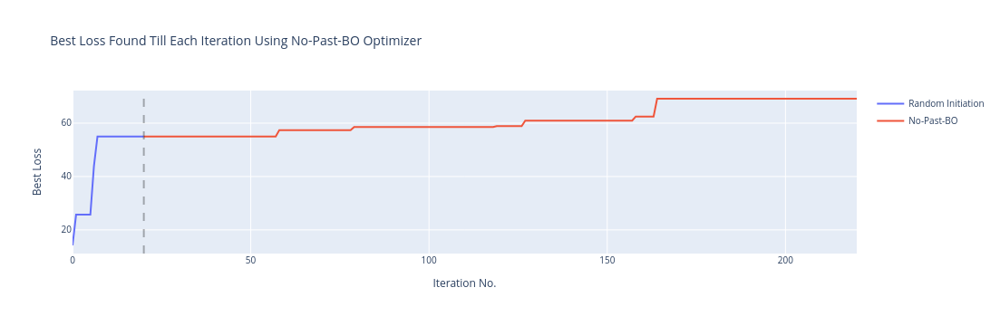

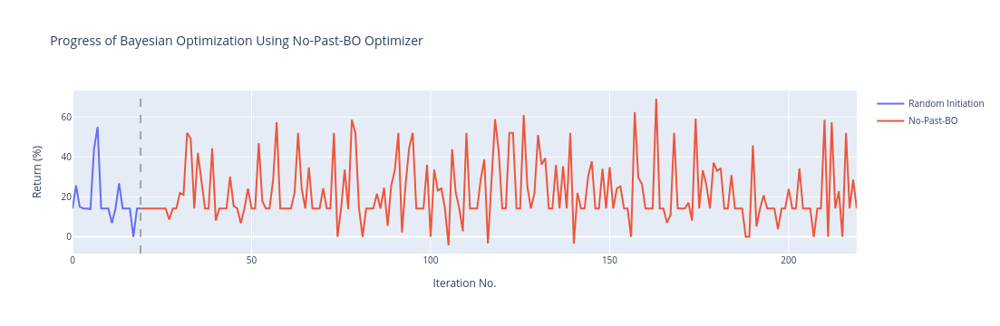

In [25]:
plot_optimization_progress(optimizer, init_set)

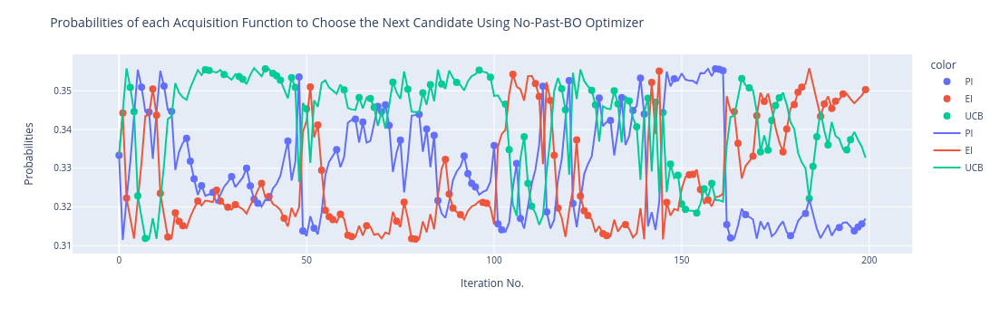

In [26]:
plot_prob_accusition(optimizer)

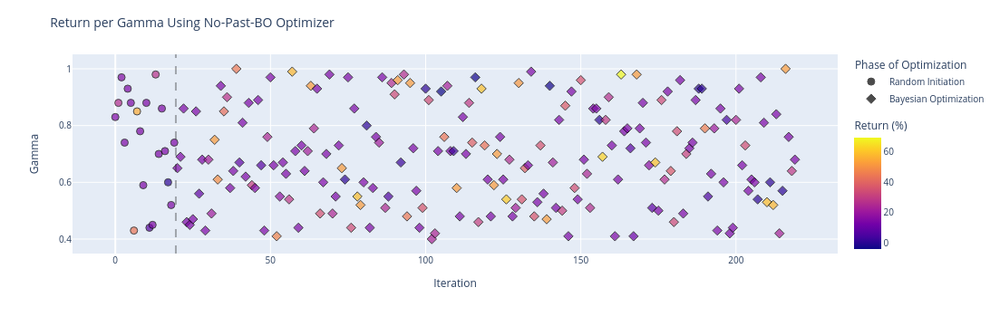

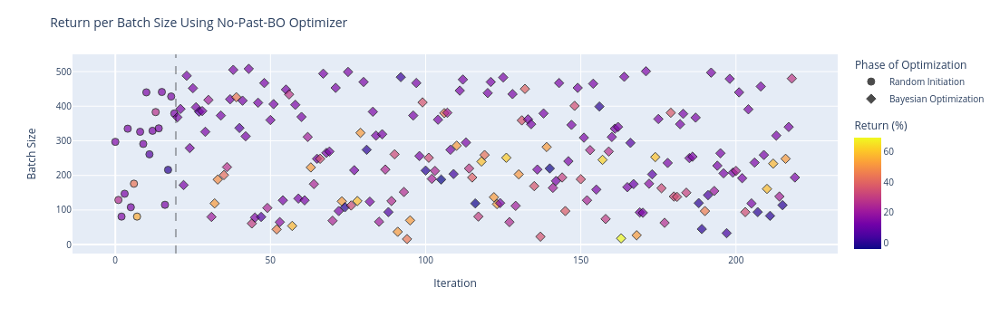

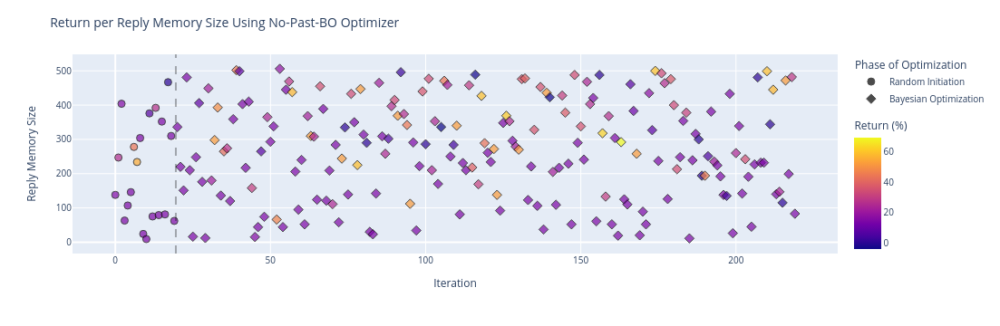

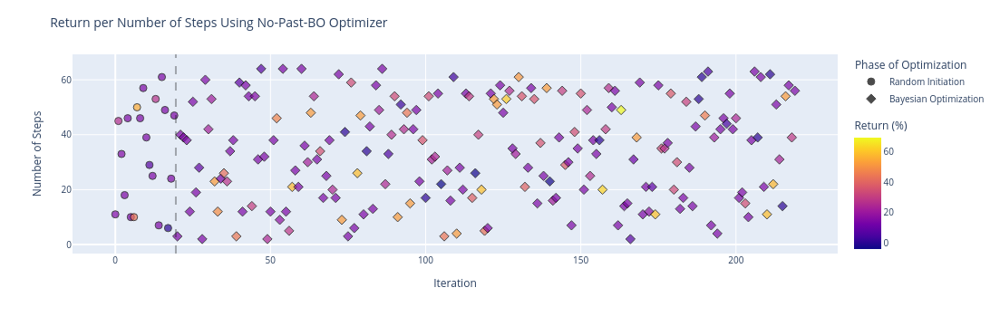

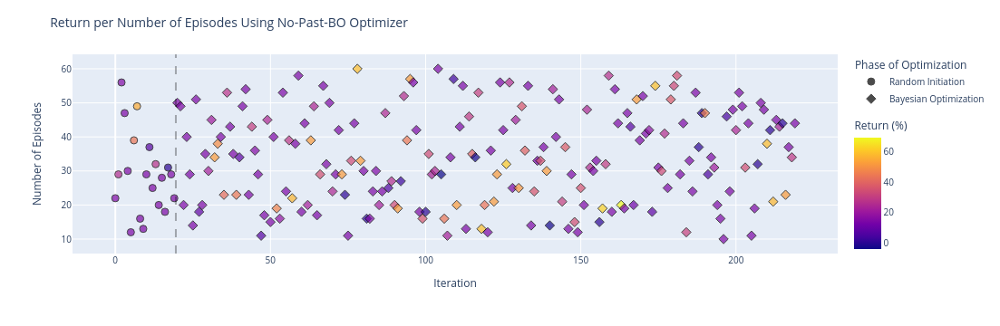

In [27]:
plot_hyperparams(params, optimizer, init_set)

In [28]:
# Imports Optimizer
from Optimizer.NoPastBayesianOptimizerVarM import NoPastBoVarM
set_random_seed(42)
eta = 1.0
m_start = 0.1
m_end = 1.0

In [29]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='No-Past-BO-VarM',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    optimizer = NoPastBoVarM(objective_func, bounds, types, name='No-Past-BO-VarM', eta=eta, m_start=m_start, m_end=m_end)
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}_m:{m_start}-{m_end}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}_eta:{eta}_m:{m_start}-{m_end}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.71it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:18<00:00,  4.76s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:13<00:00,  4.53s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:17<00:00,  2.62it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.92it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:55<00:00,  4.66s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:29<00:00,  5.37s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:34<00:00,  4.37s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.81it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:05<00:00,  2.40it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.71it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:35<00:00,  5.82s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.83it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:25<00:00,  6.41s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.59it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:10<00:00,  2.68it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:06<00:00,  2.90it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:53<00:00,  5.58s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.78it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.74it/s]


Complete


  0%|                                                   | 0/200 [00:00<?, ?it/s]

tensor([4.3125e-01, 6.6291e+01, 4.4337e+02, 1.8567e+01, 1.7983e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:19<00:00,  4.44s/it]


Complete


  0%|▏                                        | 1/200 [01:20<4:28:04, 80.83s/it]

tensor([  0.8524, 244.9858, 335.9661,  10.0328,  14.0337])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:21<00:00,  5.83s/it]


Complete


  1%|▍                                        | 2/200 [02:43<4:29:34, 81.69s/it]

tensor([  0.6825, 159.1396, 323.7487,   3.8092,  57.7090])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [05:08<00:00,  5.32s/it]


Complete


  2%|▌                                      | 3/200 [07:52<10:09:54, 185.76s/it]

tensor([ 0.4564, 68.5649, 65.3867, 15.5257, 12.2022])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.03it/s]


Complete


  2%|▊                                       | 4/200 [07:59<6:15:55, 115.08s/it]

tensor([  0.5944, 327.5704, 433.6518,  22.6591,  27.1466])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:50<00:00,  6.33s/it]


Complete


  2%|█                                       | 5/200 [10:51<7:20:30, 135.54s/it]

tensor([  0.9220, 140.2123, 332.8398,  47.1453,  54.0335])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:28<00:00,  4.97s/it]


Complete


  3%|█▏                                      | 6/200 [15:20<9:44:46, 180.86s/it]

tensor([  0.4843, 292.0243,  81.6332,  55.3184,  59.5047])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:23<00:00,  2.60it/s]


Complete


  4%|█▍                                      | 7/200 [15:43<6:56:37, 129.52s/it]

tensor([4.0266e-01, 3.0802e+02, 4.4609e+02, 3.2087e+00, 4.4526e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:47<00:00,  6.38s/it]


Complete


  4%|█▌                                      | 8/200 [20:31<9:35:56, 179.98s/it]

tensor([  0.5138, 274.1250, 230.8985,  10.5636,  44.7644])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:19<00:00,  2.37it/s]


Complete


  4%|█▊                                      | 9/200 [20:51<6:53:35, 129.93s/it]

tensor([  0.4464, 445.8368, 254.4728,  24.0385,  45.3773])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:16<00:00,  2.79it/s]


Complete


  5%|██                                      | 10/200 [21:08<5:00:55, 95.03s/it]

tensor([  0.7788, 308.5216, 370.6009,  10.5889,  38.9926])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [04:13<00:00,  6.49s/it]


Complete


  6%|██▏                                    | 11/200 [25:22<7:32:30, 143.66s/it]

tensor([  0.9744, 423.1883, 380.7811,  56.2827,  38.3550])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:12<00:00,  2.98it/s]


Complete


  6%|██▎                                    | 12/200 [25:36<5:26:10, 104.10s/it]

tensor([  0.8427, 453.4589, 292.0691,  62.3816,  56.6948])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:25<00:00,  2.22it/s]


Complete


  6%|██▌                                     | 13/200 [26:02<4:11:01, 80.54s/it]

tensor([  0.5887, 200.2645,  66.8140,  39.5385,  21.3020])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:07<00:00,  2.66it/s]


Complete


  7%|██▊                                     | 14/200 [26:11<3:02:23, 58.84s/it]

tensor([  0.5659, 182.0810, 308.1566,  29.0035,  32.7703])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [03:04<00:00,  5.59s/it]


Complete


  8%|███                                     | 15/200 [29:16<4:58:51, 96.93s/it]

tensor([  0.6084, 163.6949, 235.7940,  19.9030,  56.6321])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [05:00<00:00,  5.27s/it]


Complete


  8%|███                                    | 16/200 [34:17<8:05:50, 158.43s/it]

tensor([  0.5558, 331.7402, 432.6031,  21.2339,  26.9540])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [02:52<00:00,  6.40s/it]


Complete


  8%|███▎                                   | 17/200 [37:11<8:17:07, 162.99s/it]

tensor([4.0105e-01, 4.8716e+02, 1.0050e+02, 1.6404e+01, 4.8064e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:21<00:00,  2.27it/s]


Complete


  9%|███▌                                   | 18/200 [37:33<6:05:52, 120.62s/it]

tensor([  0.6285, 166.7053, 278.6587,  35.0146,  51.6704])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:28<00:00,  5.16s/it]


Complete


 10%|███▋                                   | 19/200 [42:02<8:18:35, 165.28s/it]

tensor([  0.9851, 329.1530, 312.3763,  49.6664,  48.5429])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:16<00:00,  2.92it/s]


Complete


 10%|███▉                                   | 20/200 [42:20<6:02:47, 120.93s/it]

tensor([  0.5425,  30.8032, 227.8500,  50.8092,  40.3050])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [02:45<00:00,  4.13s/it]


Complete


 10%|████                                   | 21/200 [45:06<6:41:14, 134.49s/it]

tensor([  0.9559, 301.9469, 257.5264,  60.7904,  16.6823])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:06<00:00,  2.54it/s]


Complete


 11%|████▍                                   | 22/200 [45:13<4:45:56, 96.39s/it]

tensor([  0.7867, 509.9973, 166.5035,   5.2525,  10.7237])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:04<00:00,  2.32it/s]


Complete


 12%|████▌                                   | 23/200 [45:19<3:23:58, 69.14s/it]

tensor([  0.4689, 371.4357, 236.9297,  11.3288,  36.9361])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:13<00:00,  2.83it/s]


Complete


 12%|████▊                                   | 24/200 [45:33<2:34:08, 52.55s/it]

tensor([  0.7166, 464.6545, 140.8484,  62.6280,  31.6654])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:13<00:00,  2.41it/s]


Complete


 12%|█████                                   | 25/200 [45:47<1:59:36, 41.01s/it]

tensor([  0.7117,  98.8031, 208.4249,  54.0976,  19.1412])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:30<00:00,  4.79s/it]


Complete


 13%|█████▏                                  | 26/200 [47:19<2:43:04, 56.24s/it]

tensor([  0.4965, 399.6259, 483.4193,  46.5403,  52.4525])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [05:47<00:00,  6.69s/it]


Complete


 14%|█████▎                                 | 27/200 [53:07<6:54:56, 143.91s/it]

tensor([  0.4028, 259.2526, 361.0590,  33.1511,  25.9333])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:30<00:00,  5.79s/it]


Complete


 14%|█████▍                                 | 28/200 [55:39<6:59:02, 146.18s/it]

tensor([  0.8301, 187.8207, 263.3193,  22.8324,  40.6609])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:40<00:00,  5.38s/it]


Complete


 14%|█████▋                                 | 29/200 [59:20<8:00:53, 168.73s/it]

tensor([  0.9009, 249.4087, 323.4019,  48.9879,  22.5228])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:08<00:00,  5.60s/it]


Complete


 15%|█████▌                               | 30/200 [1:01:30<7:25:01, 157.07s/it]

tensor([  0.9918,  80.8590, 124.5946,  29.3416,  10.0155])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:46<00:00,  4.62s/it]


Complete


 16%|█████▋                               | 31/200 [1:02:17<5:49:29, 124.08s/it]

tensor([  0.7695, 252.3904, 215.1884,  20.4766,  26.0837])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:11<00:00,  2.26it/s]


Complete


 16%|██████                                | 32/200 [1:02:29<4:13:34, 90.56s/it]

tensor([  0.9963, 161.5698, 415.0955,  21.8652,  21.5821])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:57<00:00,  5.33s/it]


Complete


 16%|██████▎                               | 33/200 [1:04:27<4:35:02, 98.82s/it]

tensor([  0.4217, 140.0467, 400.7191,  48.5228,  59.8734])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [04:57<00:00,  4.96s/it]


Complete


 17%|██████▎                              | 34/200 [1:09:26<7:19:04, 158.70s/it]

tensor([  0.7244, 287.9652, 165.6142,  22.0516,  47.4374])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:20<00:00,  2.24it/s]


Complete


 18%|██████▍                              | 35/200 [1:09:48<5:23:35, 117.67s/it]

tensor([  0.7505, 176.0903, 294.3633,  20.4466,  15.6881])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [01:27<00:00,  5.46s/it]


Complete


 18%|██████▋                              | 36/200 [1:11:16<4:57:33, 108.86s/it]

tensor([  0.7323,  49.9966, 199.2505,  34.7407,  47.5405])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [03:25<00:00,  4.28s/it]


Complete


 18%|██████▊                              | 37/200 [1:14:42<6:15:02, 138.05s/it]

tensor([  0.4354, 344.9962, 316.7704,  27.5572,  40.4754])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:17<00:00,  2.32it/s]


Complete


 19%|███████                              | 38/200 [1:15:00<4:35:35, 102.07s/it]

tensor([  0.7738, 194.1150, 161.2630,  59.8698,  56.9047])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:20<00:00,  2.75it/s]


Complete


 20%|███████▍                              | 39/200 [1:15:22<3:29:06, 77.93s/it]

tensor([  0.4494, 412.7406, 226.6031,  35.4565,  15.9080])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.87it/s]


Complete


 20%|███████▌                              | 40/200 [1:15:28<2:30:34, 56.46s/it]

tensor([  0.9145, 107.0443, 482.3302,  35.8611,  40.8969])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:22<00:00,  4.93s/it]


Complete


 20%|███████▌                             | 41/200 [1:18:51<4:26:12, 100.45s/it]

tensor([  0.9763, 137.8699, 459.4242,  17.5743,  51.3674])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [04:21<00:00,  5.12s/it]


Complete


 21%|███████▊                             | 42/200 [1:23:13<6:32:12, 148.94s/it]

tensor([  0.8671, 498.4836, 147.2580,  23.3970,  32.1951])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:13<00:00,  2.45it/s]


Complete


 22%|███████▉                             | 43/200 [1:23:27<4:43:46, 108.45s/it]

tensor([  0.5772, 252.6054, 152.4812,  58.2414,  37.3027])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.37it/s]


Complete


 22%|████████▎                             | 44/200 [1:23:44<3:30:11, 80.84s/it]

tensor([  0.9574, 105.6665, 466.0983,  56.0416,  47.3924])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:37<00:00,  4.63s/it]


Complete


 22%|████████▎                            | 45/200 [1:27:22<5:15:27, 122.11s/it]

tensor([  0.6320, 478.4520, 493.0451,   6.3363,  49.2097])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [06:10<00:00,  7.56s/it]


Complete


 23%|████████▌                            | 46/200 [1:33:33<8:25:14, 196.84s/it]

tensor([  0.4976, 304.7743, 431.1269,  44.0229,  58.1679])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [05:55<00:00,  6.12s/it]


Complete


 24%|████████▍                           | 47/200 [1:39:29<10:23:34, 244.54s/it]

tensor([  0.7142, 254.8243, 372.4669,   8.5464,  36.4134])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:35<00:00,  5.98s/it]


Complete


 24%|████████▉                            | 48/200 [1:43:05<9:57:57, 236.04s/it]

tensor([  0.7756, 420.1967, 456.6539,   2.0937,  16.1285])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [02:15<00:00,  8.44s/it]


Complete


 24%|█████████                            | 49/200 [1:45:22<8:38:37, 206.08s/it]

tensor([  0.5554, 382.4319,  62.4096,  12.3338,  28.7530])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.84it/s]


Complete


 25%|█████████▎                           | 50/200 [1:45:33<6:08:53, 147.55s/it]

tensor([  0.5453, 229.9930, 400.4661,  50.2648,  53.7834])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:59<00:00,  5.54s/it]


Complete


 26%|█████████▍                           | 51/200 [1:50:33<8:00:11, 193.37s/it]

tensor([  0.6587, 318.6101, 216.7055,  46.3565,  13.8245])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.40it/s]


Complete


 26%|█████████▌                           | 52/200 [1:50:40<5:38:48, 137.36s/it]

tensor([  0.7660, 279.2271,  44.8261,  16.7893,  39.4302])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:14<00:00,  2.76it/s]


Complete


 26%|█████████▊                           | 53/200 [1:50:55<4:06:40, 100.69s/it]

tensor([  0.8850, 434.4073,  91.4837,  48.5392,  25.0001])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.96it/s]


Complete


 27%|██████████▎                           | 54/200 [1:51:04<2:58:18, 73.28s/it]

tensor([4.9004e-01, 5.0373e+02, 5.1258e+01, 4.9881e+01, 2.7167e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:09<00:00,  2.89it/s]


Complete


 28%|██████████▍                           | 55/200 [1:51:14<2:11:24, 54.38s/it]

tensor([  0.7580, 143.6058, 144.5280,  27.7666,  58.6913])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [05:06<00:00,  5.19s/it]


Complete


 28%|██████████▎                          | 56/200 [1:56:21<5:12:33, 130.23s/it]

tensor([  0.6043, 370.0358, 164.9110,  63.2483,  19.0940])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [00:07<00:00,  2.49it/s]


Complete


 28%|██████████▊                           | 57/200 [1:56:30<3:43:21, 93.72s/it]

tensor([  0.4401, 164.7020,  62.5042,  34.5601,  43.6537])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:17<00:00,  2.50it/s]


Complete


 29%|███████████                           | 58/200 [1:56:48<2:48:22, 71.14s/it]

tensor([  0.9466, 216.2469, 319.5131,  44.5659,  30.2746])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [03:08<00:00,  6.27s/it]


Complete


 30%|██████████▉                          | 59/200 [1:59:57<4:10:15, 106.50s/it]

tensor([  0.7991, 128.8828, 162.9572,  51.9641,  24.0422])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [01:54<00:00,  4.79s/it]


Complete


 30%|███████████                          | 60/200 [2:01:53<4:14:57, 109.27s/it]

tensor([ 0.6599, 80.5078, 75.6871, 62.2935, 37.4452])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.44it/s]


Complete


 30%|███████████▌                          | 61/200 [2:02:09<3:08:23, 81.32s/it]

tensor([  0.9447,  42.9020, 269.8402,   3.9907,  10.9077])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:50<00:00,  4.60s/it]


Complete


 31%|███████████▊                          | 62/200 [2:03:01<2:46:19, 72.31s/it]

tensor([  0.9087, 162.5221, 489.3581,  18.8770,  35.9550])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [03:07<00:00,  5.22s/it]


Complete


 32%|███████████▋                         | 63/200 [2:06:09<4:04:45, 107.20s/it]

tensor([  0.8092, 172.1186, 133.9785,  24.0404,  57.3284])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:21<00:00,  2.62it/s]


Complete


 32%|████████████▏                         | 64/200 [2:06:32<3:05:27, 81.82s/it]

tensor([  0.6716, 127.9740, 168.9409,  34.1383,  58.1524])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:45<00:00,  4.92s/it]


Complete


 32%|████████████                         | 65/200 [2:11:18<5:22:02, 143.13s/it]

tensor([  0.9669, 396.6747, 253.2211,  35.9349,  55.4748])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:20<00:00,  2.70it/s]


Complete


 33%|████████████▏                        | 66/200 [2:11:39<3:57:57, 106.55s/it]

tensor([  0.5315, 318.0008, 145.9116,  33.0518,  35.3873])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.76it/s]


Complete


 34%|████████████▋                         | 67/200 [2:11:53<2:54:20, 78.65s/it]

tensor([4.0329e-01, 1.4366e+02, 4.5234e+02, 2.6729e+01, 2.6124e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [02:13<00:00,  5.13s/it]


Complete


 34%|████████████▉                         | 68/200 [2:14:07<3:29:48, 95.37s/it]

tensor([  0.5329, 206.7699,  28.7941,  11.6693,  59.6039])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:23<00:00,  2.58it/s]


Complete


 34%|█████████████                         | 69/200 [2:14:31<2:41:31, 73.98s/it]

tensor([  0.6784, 393.8628, 139.8163,  57.8795,  29.1054])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.48it/s]


Complete


 35%|█████████████▎                        | 70/200 [2:14:44<2:00:23, 55.56s/it]

tensor([  0.4432, 259.0897, 224.1813,  46.4513,  51.3558])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:22<00:00,  2.23it/s]


Complete


 36%|█████████████▍                        | 71/200 [2:15:08<1:38:56, 46.02s/it]

tensor([  0.8531, 349.7283, 114.5127,   2.7622,  13.6008])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:06<00:00,  2.30it/s]


Complete


 36%|█████████████▋                        | 72/200 [2:15:14<1:13:09, 34.29s/it]

tensor([  0.9561, 500.1945, 466.3464,  26.4044,  20.4155])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [00:07<00:00,  2.51it/s]


Complete


 36%|██████████████▌                         | 73/200 [2:15:23<56:23, 26.64s/it]

tensor([  0.5876,  96.4570, 317.8768,  58.9299,  39.4384])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [03:02<00:00,  4.69s/it]


Complete


 37%|██████████████                        | 74/200 [2:18:27<2:35:01, 73.82s/it]

tensor([  0.7394, 303.8046, 505.1321,  61.1842,  10.7727])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [01:03<00:00,  5.81s/it]


Complete


 38%|██████████████▎                       | 75/200 [2:19:32<2:28:09, 71.12s/it]

tensor([  0.8145, 202.7784, 225.0945,  43.0427,  24.0045])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:09<00:00,  5.38s/it]


Complete


 38%|██████████████▍                       | 76/200 [2:21:42<3:03:34, 88.83s/it]

tensor([  0.4356, 385.7061, 373.1121,  29.3224,  14.8079])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.93it/s]


Complete


 38%|██████████████▋                       | 77/200 [2:21:48<2:11:08, 63.97s/it]

tensor([  0.5016, 222.6586, 237.5291,  44.9869,  12.3363])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:05<00:00,  5.47s/it]


Complete


 39%|██████████████▊                       | 78/200 [2:22:55<2:11:37, 64.74s/it]

tensor([  0.5929, 410.1036, 337.6162,   2.1318,  11.3239])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:05<00:00,  2.04it/s]


Complete


 40%|███████████████                       | 79/200 [2:23:01<1:35:09, 47.18s/it]

tensor([  0.7525, 123.0956, 360.9974,  22.8417,  49.5959])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [04:09<00:00,  4.98s/it]


Complete


 40%|██████████████▊                      | 80/200 [2:27:11<3:36:01, 108.01s/it]

tensor([  0.5245,  19.6805, 140.1509,   3.6885,  45.9070])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [03:09<00:00,  4.13s/it]


Complete


 40%|██████████████▉                      | 81/200 [2:30:22<4:23:29, 132.86s/it]

tensor([  0.7892, 271.6392, 479.0201,   4.0006,  59.0410])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [05:56<00:00,  6.05s/it]


Complete


 41%|███████████████▏                     | 82/200 [2:36:19<6:33:59, 200.33s/it]

tensor([  0.5502, 383.6676, 175.7194,  38.9945,  48.9853])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:16<00:00,  2.90it/s]


Complete


 42%|███████████████▎                     | 83/200 [2:36:37<4:43:52, 145.58s/it]

tensor([  0.5638, 164.6549, 472.3467,  39.1541,  43.2001])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:44<00:00,  5.23s/it]


Complete


 42%|███████████████▌                     | 84/200 [2:40:23<5:27:49, 169.56s/it]

tensor([  0.8004, 323.2820, 179.4698,  21.4479,  45.8587])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:16<00:00,  2.85it/s]


Complete


 42%|███████████████▋                     | 85/200 [2:40:40<3:57:15, 123.79s/it]

tensor([  0.7933, 114.5533, 286.1811,  16.5591,  14.7845])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:14<00:00,  4.99s/it]


Complete


 43%|███████████████▉                     | 86/200 [2:41:56<3:27:54, 109.42s/it]

tensor([  0.6395, 377.9168, 291.3602,  17.7024,  39.1773])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:14<00:00,  2.69it/s]


Complete


 44%|████████████████▌                     | 87/200 [2:42:11<2:32:57, 81.22s/it]

tensor([  0.7265, 434.6197, 504.7578,  61.8644,  13.9132])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:36<00:00,  6.91s/it]


Complete


 44%|████████████████▋                     | 88/200 [2:43:49<2:40:47, 86.14s/it]

tensor([  0.7593,  73.6305, 210.3321,  63.0336,  27.6962])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:01<00:00,  4.34s/it]


Complete


 44%|████████████████▉                     | 89/200 [2:45:51<2:59:32, 97.05s/it]

tensor([  0.6899, 440.4771, 345.3125,  48.8975,  45.3238])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:17<00:00,  2.55it/s]


Complete


 45%|█████████████████                     | 90/200 [2:46:10<2:14:43, 73.49s/it]

tensor([  0.9798, 443.2104, 426.7016,  58.8876,  10.1870])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 10/10 [00:04<00:00,  2.35it/s]


Complete


 46%|█████████████████▎                    | 91/200 [2:46:15<1:36:14, 52.98s/it]

tensor([  0.7920, 163.2668, 156.0472,   7.9093,  30.2696])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:12<00:00,  2.31it/s]


Complete


 46%|█████████████████▍                    | 92/200 [2:46:29<1:14:14, 41.25s/it]

tensor([  0.9213, 335.2491, 424.6422,   4.8242,  29.4028])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [03:15<00:00,  6.76s/it]


Complete


 46%|█████████████████▋                    | 93/200 [2:49:45<2:36:47, 87.92s/it]

tensor([4.0169e-01, 4.6454e+02, 4.1896e+02, 5.9768e+01, 5.3349e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:20<00:00,  2.63it/s]


Complete


 47%|█████████████████▊                    | 94/200 [2:50:07<1:59:52, 67.86s/it]

tensor([  0.9342, 484.5038, 150.6030,  39.9975,  23.5745])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:08<00:00,  2.69it/s]


Complete


 48%|██████████████████                    | 95/200 [2:50:16<1:28:15, 50.43s/it]

tensor([  0.8240,  66.5899, 488.3273,  53.2122,  19.8055])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:30<00:00,  4.51s/it]


Complete


 48%|██████████████████▏                   | 96/200 [2:51:47<1:48:33, 62.63s/it]

tensor([  0.5133, 405.0624, 168.9760,  14.3394,  25.6512])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:10<00:00,  2.52it/s]


Complete


 48%|██████████████████▍                   | 97/200 [2:51:59<1:21:03, 47.21s/it]

tensor([  0.6302, 219.1217, 467.5245,  59.2228,  46.6998])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [04:17<00:00,  5.48s/it]


Complete


 49%|██████████████████▏                  | 98/200 [2:56:17<3:07:57, 110.57s/it]

tensor([  0.5795, 228.9367,  93.9392,  51.3294,  44.0372])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:19<00:00,  2.28it/s]


Complete


 50%|██████████████████▊                   | 99/200 [2:56:37<2:20:28, 83.45s/it]

tensor([4.1755e-01, 3.7437e+02, 4.9068e+02, 2.3491e+01, 1.2281e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:20<00:00,  6.72s/it]


Complete


 50%|██████████████████▌                  | 100/200 [2:57:59<2:18:09, 82.89s/it]

tensor([  0.5654, 148.1770, 418.8751,  46.9950,  13.6413])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:09<00:00,  4.96s/it]


Complete


 50%|██████████████████▋                  | 101/200 [2:59:09<2:10:39, 79.19s/it]

tensor([  0.7270, 457.7669, 487.0916,  19.7080,  19.6231])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [02:23<00:00,  7.20s/it]


Complete


 51%|██████████████████▊                  | 102/200 [3:01:34<2:41:32, 98.91s/it]

tensor([  0.6018, 129.6819, 365.1271,  54.2717,  11.8670])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:59<00:00,  4.95s/it]


Complete


 52%|███████████████████                  | 103/200 [3:02:34<2:21:08, 87.31s/it]

tensor([  0.7750, 319.8434, 334.3825,  11.9395,  11.2586])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [01:08<00:00,  6.20s/it]


Complete


 52%|███████████████████▏                 | 104/200 [3:03:44<2:11:02, 81.90s/it]

tensor([  0.9767, 354.3779, 337.0105,   2.1916,  50.9508])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:22<00:00,  2.22it/s]


Complete


 52%|███████████████████▍                 | 105/200 [3:04:08<1:42:06, 64.49s/it]

tensor([  0.4267, 257.2736, 107.2510,  24.1091,  37.8085])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:18<00:00,  2.09it/s]


Complete


 53%|███████████████████▌                 | 106/200 [3:04:27<1:19:42, 50.88s/it]

tensor([  0.8300, 179.4204, 257.9200,  17.3217,  48.5253])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:32<00:00,  5.57s/it]


Complete


 54%|███████████████████▎                | 107/200 [3:09:01<3:02:33, 117.78s/it]

tensor([  0.4981, 457.5117,  70.1147,  35.3448,  39.7048])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:17<00:00,  2.26it/s]


Complete


 54%|███████████████████▉                 | 108/200 [3:09:19<2:14:57, 88.02s/it]

tensor([  0.5457, 345.3895, 213.6367,  33.5382,  39.8660])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:16<00:00,  2.39it/s]


Complete


 55%|████████████████████▏                | 109/200 [3:09:37<1:41:27, 66.90s/it]

tensor([  0.4849, 221.4613, 192.9634,  26.5154,  15.3120])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:06<00:00,  2.45it/s]


Complete


 55%|████████████████████▎                | 110/200 [3:09:44<1:13:26, 48.96s/it]

tensor([  0.7571, 267.7726,  36.9160,  45.5806,  46.4179])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:18<00:00,  2.49it/s]


Complete


 56%|█████████████████████▋                 | 111/200 [3:10:04<59:33, 40.15s/it]

tensor([  0.7408, 387.9256, 300.8162,  12.1165,  22.8076])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [00:07<00:00,  2.88it/s]


Complete


 56%|█████████████████████▊                 | 112/200 [3:10:12<45:07, 30.77s/it]

tensor([  0.8706, 138.4221, 448.5219,  18.6253,  33.3585])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [02:54<00:00,  5.30s/it]


Complete


 56%|████████████████████▉                | 113/200 [3:13:08<1:47:44, 74.31s/it]

tensor([  0.4432, 415.7730, 227.3030,  54.1100,  23.7610])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:10<00:00,  2.23it/s]


Complete


 57%|█████████████████████                | 114/200 [3:13:20<1:19:35, 55.52s/it]

tensor([  0.7440, 439.5396, 456.7928,  52.3101,  22.0152])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [02:33<00:00,  6.97s/it]


Complete


 57%|█████████████████████▎               | 115/200 [3:15:54<2:00:40, 85.18s/it]

tensor([  0.6089,  29.7887, 201.6981,  35.3165,  52.9578])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [03:35<00:00,  4.07s/it]


Complete


 58%|████████████████████▉               | 116/200 [3:19:31<2:54:30, 124.65s/it]

tensor([  0.8961, 225.6069, 462.4178,  15.0679,  23.5703])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [02:16<00:00,  5.70s/it]


Complete


 58%|█████████████████████               | 117/200 [3:21:49<2:57:55, 128.63s/it]

tensor([  0.9863, 504.3583, 324.7676,   5.5863,  40.2190])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [00:15<00:00,  2.62it/s]


Complete


 59%|█████████████████████▊               | 118/200 [3:22:05<2:09:43, 94.92s/it]

tensor([  0.7293, 147.6131, 211.2123,  55.7203,  54.8312])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [04:33<00:00,  4.98s/it]


Complete


 60%|█████████████████████▍              | 119/200 [3:26:40<3:20:59, 148.88s/it]

tensor([  0.4133, 108.7462,  13.2650,  61.4592,  21.6897])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:09<00:00,  2.35it/s]


Complete


 60%|█████████████████████▌              | 120/200 [3:26:50<2:23:04, 107.31s/it]

tensor([  0.7357, 380.5471,  28.4106,  38.3241,  31.9281])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:11<00:00,  2.82it/s]


Complete


 60%|██████████████████████▍              | 121/200 [3:27:03<1:43:48, 78.84s/it]

tensor([  0.9568,  57.1142, 471.0503,  48.3224,  30.2973])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:12<00:00,  4.43s/it]


Complete


 61%|██████████████████████▌              | 122/200 [3:29:17<2:03:58, 95.37s/it]

tensor([  0.9867, 509.2401, 382.5104,  53.0474,  14.4465])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [00:05<00:00,  2.37it/s]


Complete


 62%|██████████████████████▊              | 123/200 [3:29:24<1:28:22, 68.86s/it]

tensor([  0.9858, 333.4036, 437.2389,  53.5633,  41.1683])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [04:28<00:00,  6.56s/it]


Complete


 62%|██████████████████████▎             | 124/200 [3:33:54<2:43:33, 129.13s/it]

tensor([  0.6303, 190.2426,  72.3536,   5.4638,  12.3729])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.44it/s]


Complete


 62%|███████████████████████▏             | 125/200 [3:33:59<1:55:12, 92.16s/it]

tensor([  0.8885, 349.3490, 249.1349,  21.6608,  42.0176])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [00:15<00:00,  2.71it/s]


Complete


 63%|███████████████████████▎             | 126/200 [3:34:16<1:25:39, 69.45s/it]

tensor([  0.8791, 338.4418, 284.8240,  31.9631,  44.8525])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [00:15<00:00,  2.84it/s]


Complete


 64%|███████████████████████▍             | 127/200 [3:34:33<1:05:18, 53.67s/it]

tensor([  0.8872, 431.6502, 401.1259,  44.3520,  47.0019])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:16<00:00,  2.84it/s]


Complete


 64%|████████████████████████▉              | 128/200 [3:34:50<51:23, 42.83s/it]

tensor([  0.9988, 296.4491, 246.1229,  35.4076,  22.0205])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.83it/s]


Complete


 64%|█████████████████████████▏             | 129/200 [3:34:59<38:40, 32.69s/it]

tensor([  0.9977, 478.6403, 369.6080,  38.7442,  36.0591])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:13<00:00,  2.67it/s]


Complete


 65%|█████████████████████████▎             | 130/200 [3:35:14<31:47, 27.26s/it]

tensor([  0.7013,  93.7031, 222.5171,  52.9485,  55.8409])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [04:18<00:00,  4.61s/it]


Complete


 66%|████████████████████████▏            | 131/200 [3:39:33<1:51:23, 96.87s/it]

tensor([  0.8950, 252.8757, 376.7429,  50.2918,  36.9775])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:29<00:00,  5.68s/it]


Complete


 66%|███████████████████████▊            | 132/200 [3:43:04<2:28:35, 131.11s/it]

tensor([  0.4954, 209.6358,  79.3198,  22.7839,  30.2657])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [00:12<00:00,  2.42it/s]


Complete


 66%|████████████████████████▌            | 133/200 [3:43:18<1:46:57, 95.78s/it]

tensor([  0.8760, 156.9595, 499.6260,  23.2353,  40.4458])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [03:25<00:00,  5.14s/it]


Complete


 67%|████████████████████████            | 134/200 [3:46:44<2:21:52, 128.97s/it]

tensor([  0.6870, 282.0540, 107.5958,  18.9719,  57.8229])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:21<00:00,  2.75it/s]


Complete


 68%|████████████████████████▉            | 135/200 [3:47:06<1:45:01, 96.94s/it]

tensor([  0.7410, 501.0886, 427.1335,  63.0250,  15.0259])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:06<00:00,  2.45it/s]


Complete


 68%|█████████████████████████▏           | 136/200 [3:47:13<1:14:40, 70.02s/it]

tensor([  0.4907, 378.2296, 196.7312,  21.6939,  58.6361])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:22<00:00,  2.58it/s]


Complete


 68%|██████████████████████████▋            | 137/200 [3:47:37<58:59, 56.18s/it]

tensor([  0.8761, 482.1012, 117.6428,  11.8609,  25.6156])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:09<00:00,  2.77it/s]


Complete


 69%|██████████████████████████▉            | 138/200 [3:47:48<43:52, 42.46s/it]

tensor([  0.6752, 510.2122, 151.9921,  59.1553,  23.6064])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:10<00:00,  2.26it/s]


Complete


 70%|███████████████████████████            | 139/200 [3:47:59<33:47, 33.23s/it]

tensor([  0.4851, 245.8377, 392.7802,  38.9943,  32.3561])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:13<00:00,  6.05s/it]


Complete


 70%|█████████████████████████▉           | 140/200 [3:51:14<1:21:39, 81.65s/it]

tensor([  0.7445, 308.3478, 126.5919,  30.2811,  33.8945])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:16<00:00,  2.11it/s]


Complete


 70%|██████████████████████████           | 141/200 [3:51:31<1:01:14, 62.27s/it]

tensor([  0.7070, 353.4858,  89.7521,  50.0893,  22.1390])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.76it/s]


Complete


 71%|███████████████████████████▋           | 142/200 [3:51:40<44:44, 46.28s/it]

tensor([  0.7741, 356.4030,  29.6436,  40.9884,  57.7763])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:20<00:00,  2.89it/s]


Complete


 72%|███████████████████████████▉           | 143/200 [3:52:01<36:48, 38.74s/it]

tensor([  0.6450, 476.7316, 157.0094,  43.1374,  55.1491])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:21<00:00,  2.54it/s]


Complete


 72%|████████████████████████████           | 144/200 [3:52:24<31:38, 33.91s/it]

tensor([  0.5118, 471.8037,  90.4038,   7.5486,  16.2665])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:07<00:00,  2.24it/s]


Complete


 72%|████████████████████████████▎          | 145/200 [3:52:32<23:59, 26.18s/it]

tensor([  0.7801, 228.3194, 156.9011,  12.5155,  50.7102])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:23<00:00,  2.13it/s]


Complete


 73%|████████████████████████████▍          | 146/200 [3:52:57<23:14, 25.83s/it]

tensor([  0.4932, 161.2705, 156.2784,  27.2954,  48.1283])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:20<00:00,  2.35it/s]


Complete


 74%|████████████████████████████▋          | 147/200 [3:53:18<21:38, 24.50s/it]

tensor([  0.4325, 258.5023, 121.8807,  42.6170,  27.3124])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [00:10<00:00,  2.48it/s]


Complete


 74%|████████████████████████████▊          | 148/200 [3:53:30<18:00, 20.78s/it]

tensor([  0.8926, 119.8584, 249.7456,  63.5744,  59.8496])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [05:05<00:00,  5.09s/it]


Complete


 74%|██████████████████████████▊         | 149/200 [3:58:37<1:30:34, 106.57s/it]

tensor([  0.4659, 241.7684, 220.5966,  29.4472,  53.3101])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:20<00:00,  2.58it/s]


Complete


 75%|███████████████████████████▊         | 150/200 [3:58:59<1:07:36, 81.12s/it]

tensor([  0.9090,  49.2980, 208.6623,  29.9899,  27.8595])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:05<00:00,  4.48s/it]


Complete


 76%|███████████████████████████▉         | 151/200 [4:01:05<1:17:22, 94.75s/it]

tensor([  0.7586,  63.5006, 198.8346,  24.5140,  12.7336])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:57<00:00,  4.40s/it]


Complete


 76%|████████████████████████████         | 152/200 [4:02:04<1:07:02, 83.81s/it]

tensor([  0.6809, 353.5290,  38.7687,  60.7367,  49.7775])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:19<00:00,  2.52it/s]


Complete


 76%|█████████████████████████████▊         | 153/200 [4:02:25<50:51, 64.92s/it]

tensor([  0.6424,  18.9134, 206.9339,  19.0006,  32.1288])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [02:16<00:00,  4.26s/it]


Complete


 77%|████████████████████████████▍        | 154/200 [4:04:42<1:06:26, 86.67s/it]

tensor([  0.4669,  76.7066, 265.9536,  58.5180,  17.6919])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [01:18<00:00,  4.37s/it]


Complete


 78%|████████████████████████████▋        | 155/200 [4:06:02<1:03:27, 84.61s/it]

tensor([  0.7179, 300.2928, 378.2850,  31.9842,  37.4892])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:46<00:00,  6.11s/it]


Complete


 78%|████████████████████████████        | 156/200 [4:09:49<1:33:23, 127.36s/it]

tensor([  0.5066, 466.0598, 295.5209,   5.5193,  28.8045])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:12<00:00,  2.38it/s]


Complete


 78%|█████████████████████████████        | 157/200 [4:10:02<1:06:44, 93.12s/it]

tensor([  0.9179, 236.2774,  73.5112,  48.3939,  56.8741])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:22<00:00,  2.52it/s]


Complete


 79%|██████████████████████████████▊        | 158/200 [4:10:26<50:35, 72.27s/it]

tensor([  0.9038, 160.9818, 159.6772,  20.8431,  13.0512])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:06<00:00,  2.04it/s]


Complete


 80%|███████████████████████████████        | 159/200 [4:10:33<36:05, 52.82s/it]

tensor([  0.6314, 504.5263, 182.6376,  35.3674,  57.5109])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:24<00:00,  2.41it/s]


Complete


 80%|███████████████████████████████▏       | 160/200 [4:10:59<29:42, 44.57s/it]

tensor([  0.5785,  29.3609, 460.2665,  54.0866,  27.8959])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [01:54<00:00,  4.11s/it]


Complete


 80%|███████████████████████████████▍       | 161/200 [4:12:55<42:55, 66.03s/it]

tensor([  0.9850, 326.7700, 316.6692,  13.4510,  11.6074])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.23it/s]


Complete


 81%|███████████████████████████████▌       | 162/200 [4:13:01<30:28, 48.12s/it]

tensor([  0.8099, 253.8222, 304.8142,  17.6133,  33.6386])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [03:21<00:00,  5.92s/it]


Complete


 82%|███████████████████████████████▊       | 163/200 [4:16:23<58:12, 94.39s/it]

tensor([  0.6116, 126.1451,  75.0254,  59.7941,  55.2907])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [00:20<00:00,  2.65it/s]


Complete


 82%|███████████████████████████████▉       | 164/200 [4:16:45<43:35, 72.65s/it]

tensor([  0.6668, 367.1198, 217.5247,  62.9270,  40.7945])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [00:15<00:00,  2.64it/s]


Complete


 82%|████████████████████████████████▏      | 165/200 [4:17:02<32:34, 55.83s/it]

tensor([  0.9722, 136.4520,  64.8708,  54.6899,  36.4142])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:14<00:00,  2.49it/s]


Complete


 83%|████████████████████████████████▎      | 166/200 [4:17:17<24:48, 43.77s/it]

tensor([  0.5346, 307.0876, 174.9302,  21.7194,  53.1534])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:19<00:00,  2.79it/s]


Complete


 84%|████████████████████████████████▌      | 167/200 [4:17:38<20:09, 36.66s/it]

tensor([  0.9672, 334.4993, 472.2904,  51.1082,  40.1146])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [04:33<00:00,  6.83s/it]


Complete


 84%|███████████████████████████████▉      | 168/200 [4:22:12<57:34, 107.97s/it]

tensor([  0.4102, 363.9193, 163.6057,  58.0795,  44.1437])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:15<00:00,  2.85it/s]


Complete


 84%|████████████████████████████████▉      | 169/200 [4:22:29<41:37, 80.57s/it]

tensor([4.2467e-01, 5.8251e+01, 4.3628e+02, 3.5684e+00, 4.1263e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:06<00:00,  4.54s/it]


Complete


 85%|████████████████████████████████▎     | 170/200 [4:25:36<56:18, 112.62s/it]

tensor([  0.5399, 365.8334,  10.9982,  10.1008,  37.4267])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:16<00:00,  2.25it/s]


Complete


 86%|█████████████████████████████████▎     | 171/200 [4:25:53<40:38, 84.10s/it]

tensor([  0.8788, 397.6362, 386.2729,  22.0245,  38.0640])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:14<00:00,  2.62it/s]


Complete


 86%|█████████████████████████████████▌     | 172/200 [4:26:09<29:39, 63.56s/it]

tensor([  0.7395, 266.5634, 384.6470,  32.9746,  52.2245])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [05:16<00:00,  6.09s/it]


Complete


 86%|███████████████████████████████▏    | 173/200 [4:31:27<1:02:53, 139.77s/it]

tensor([  0.6330, 303.9273, 216.8826,  27.0325,  30.5567])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:14<00:00,  2.21it/s]


Complete


 87%|█████████████████████████████████     | 174/200 [4:31:42<44:22, 102.40s/it]

tensor([4.0573e-01, 5.0995e+02, 2.0451e+02, 5.3878e+01, 1.5631e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:07<00:00,  2.28it/s]


Complete


 88%|██████████████████████████████████▏    | 175/200 [4:31:50<30:52, 74.11s/it]

tensor([  0.9027, 365.9331,  77.5024,  32.4088,  49.6425])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:18<00:00,  2.74it/s]


Complete


 88%|██████████████████████████████████▎    | 176/200 [4:32:09<23:04, 57.70s/it]

tensor([  0.6308, 207.3780, 399.4268,   9.2877,  41.2459])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:59<00:00,  5.85s/it]


Complete


 88%|█████████████████████████████████▋    | 177/200 [4:36:11<43:13, 112.76s/it]

tensor([  0.8760, 449.2508, 139.9121,  21.8122,  51.6043])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:21<00:00,  2.44it/s]


Complete


 89%|██████████████████████████████████▋    | 178/200 [4:36:33<31:24, 85.67s/it]

tensor([  0.4923,  73.7284, 428.7973,  37.9454,  14.0252])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:05<00:00,  4.66s/it]


Complete


 90%|██████████████████████████████████▉    | 179/200 [4:37:40<27:58, 79.93s/it]

tensor([  0.5732, 475.6497, 353.4603,  23.3655,  12.5205])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.62it/s]


Complete


 90%|███████████████████████████████████    | 180/200 [4:37:46<19:15, 57.78s/it]

tensor([4.1967e-01, 4.9199e+02, 7.6624e+01, 5.6923e+01, 3.5245e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.81it/s]


Complete


 90%|███████████████████████████████████▎   | 181/200 [4:37:59<14:05, 44.50s/it]

tensor([  0.7436,  16.4964, 295.2550,  37.7765,  30.0892])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 30/30 [02:05<00:00,  4.19s/it]


Complete


 91%|███████████████████████████████████▍   | 182/200 [4:40:06<20:46, 69.23s/it]

tensor([  0.8513, 345.3132,  79.9658,  48.7100,  58.5145])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:21<00:00,  2.72it/s]


Complete


 92%|███████████████████████████████████▋   | 183/200 [4:40:29<15:40, 55.29s/it]

tensor([  0.6382,  75.1199, 109.9649,  58.8025,  19.9897])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 20/20 [01:33<00:00,  4.65s/it]


Complete


 92%|███████████████████████████████████▉   | 184/200 [4:42:03<17:52, 67.03s/it]

tensor([  0.7302, 129.8874, 401.3070,  16.0193,  54.2761])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:37<00:00,  5.14s/it]


Complete


 92%|███████████████████████████████████▏  | 185/200 [4:46:42<32:37, 130.51s/it]

tensor([  0.7688,  18.7081, 406.9436,  47.5808,  26.6733])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 27/27 [01:45<00:00,  3.90s/it]


Complete


 93%|███████████████████████████████████▎  | 186/200 [4:48:28<28:46, 123.30s/it]

tensor([4.3434e-01, 4.8690e+02, 2.2044e+01, 2.7817e+01, 4.2901e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [00:17<00:00,  2.39it/s]


Complete


 94%|████████████████████████████████████▍  | 187/200 [4:48:48<19:56, 92.05s/it]

tensor([  0.7525, 198.3767, 358.1092,  56.9874,  22.6513])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [02:03<00:00,  5.39s/it]


Complete


 94%|███████████████████████████████████▋  | 188/200 [4:50:53<20:23, 101.99s/it]

tensor([  0.7483, 123.8152,  14.2571,  11.4435,  54.0763])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:19<00:00,  2.83it/s]


Complete


 94%|████████████████████████████████████▊  | 189/200 [4:51:13<14:11, 77.45s/it]

tensor([  0.7926, 352.3066, 250.1983,  40.0904,  21.3236])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [00:08<00:00,  2.57it/s]


Complete


 95%|█████████████████████████████████████  | 190/200 [4:51:22<09:30, 57.02s/it]

tensor([  0.9956, 167.0522, 267.1408,  21.3734,  14.6193])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [01:25<00:00,  5.72s/it]


Complete


 96%|█████████████████████████████████████▏ | 191/200 [4:52:50<09:54, 66.08s/it]

tensor([  0.9870, 377.2366, 220.0800,  38.9397,  48.1034])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:16<00:00,  2.90it/s]


Complete


 96%|█████████████████████████████████████▍ | 192/200 [4:53:07<06:52, 51.58s/it]

tensor([  0.9831, 215.1896, 155.6095,  60.9562,  25.4760])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.96it/s]


Complete


 96%|█████████████████████████████████████▋ | 193/200 [4:53:17<04:33, 39.02s/it]

tensor([  0.6252,  11.7457, 411.7599,  62.8239,  59.6176])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [03:50<00:00,  3.84s/it]


Complete


 97%|█████████████████████████████████████▊ | 194/200 [4:57:09<09:40, 96.82s/it]

tensor([  0.8984, 436.8530, 287.1721,  29.4266,  33.3224])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:14<00:00,  2.27it/s]


Complete


 98%|██████████████████████████████████████ | 195/200 [4:57:25<06:02, 72.54s/it]

tensor([  0.9433, 148.4674, 303.9157,   9.5300,  19.4945])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:40<00:00,  5.28s/it]


Complete


 98%|██████████████████████████████████████▏| 196/200 [4:59:06<05:24, 81.22s/it]

tensor([  0.7595, 359.0715, 459.7476,  59.6783,  29.0889])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [03:06<00:00,  6.42s/it]


Complete


 98%|█████████████████████████████████████▍| 197/200 [5:02:14<05:39, 113.11s/it]

tensor([4.4135e-01, 4.6197e+02, 3.6945e+02, 6.2274e+01, 5.0515e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [00:18<00:00,  2.78it/s]


Complete


 99%|██████████████████████████████████████▌| 198/200 [5:02:33<02:50, 85.09s/it]

tensor([ 0.6314, 39.8719, 76.2014, 27.3322, 43.9839])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:07<00:00,  4.25s/it]


Complete


100%|█████████████████████████████████████▊| 199/200 [5:05:42<01:56, 116.15s/it]

tensor([  0.4243, 345.9969, 266.6843,   4.3972,  47.3291])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [00:18<00:00,  2.54it/s]


Complete


100%|███████████████████████████████████████| 200/200 [5:06:02<00:00, 91.81s/it]


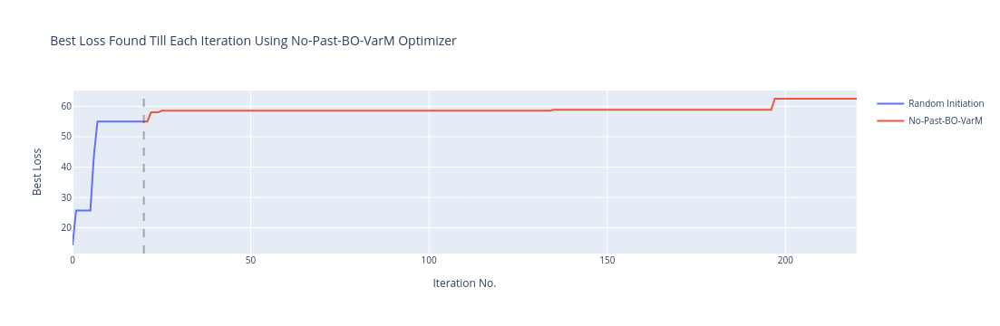

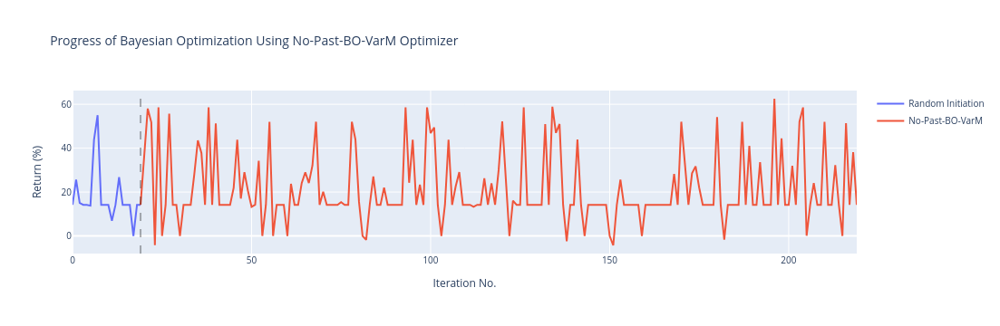

In [30]:
plot_optimization_progress(optimizer, init_set)

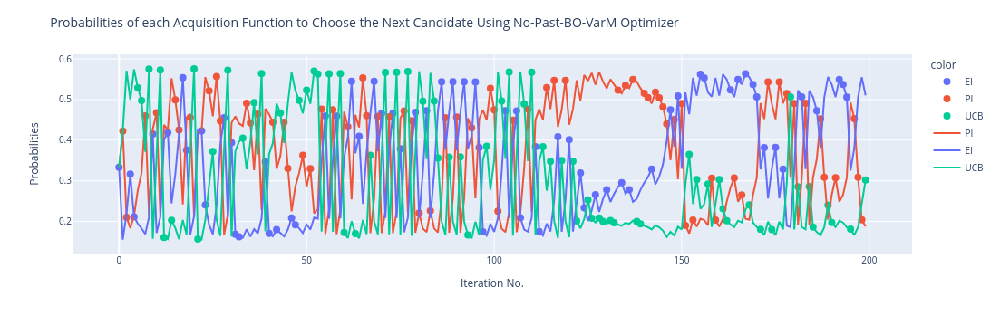

In [31]:
plot_prob_accusition(optimizer)

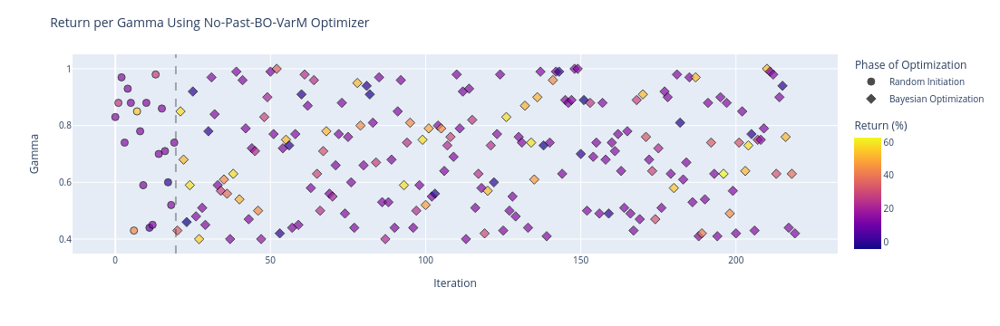

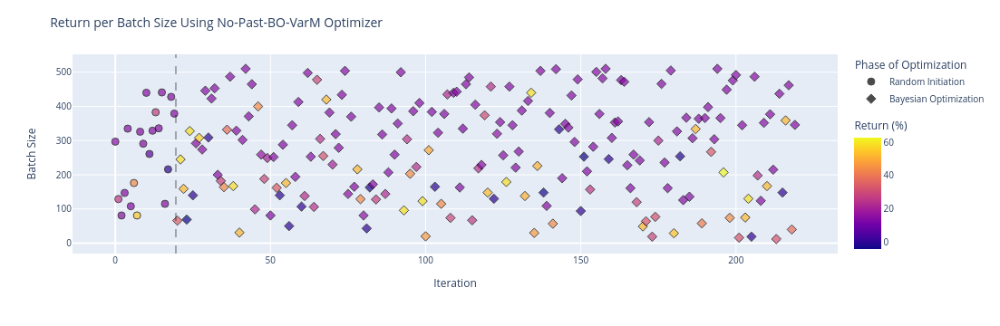

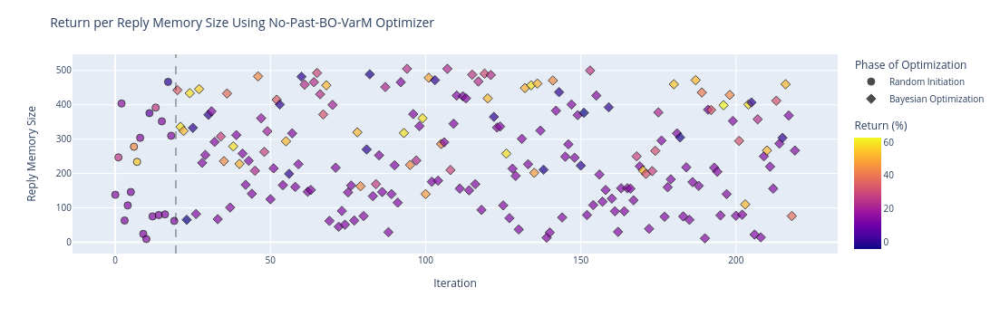

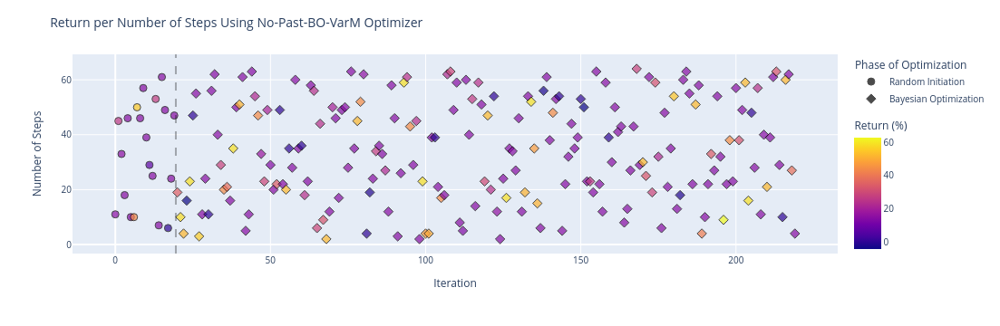

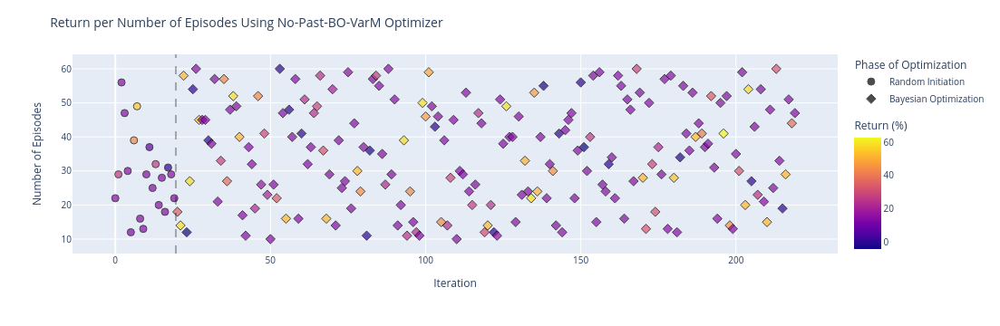

In [32]:
plot_hyperparams(params, optimizer, init_set)

In [33]:
# Imports Optimizer
from Optimizer.SETUPOptimaizer import SETUPBayesianOptimizer
set_random_seed(42)

In [ ]:
run = SensitivityRun(
    dataset_name,
    gamma_default,
    batch_size_default,
    replay_memory_size_default,
    feature_size,
    target_update,
    n_episodes,
    n_step,
    window_size,
    device,
    evaluation_parameter='SETUP-BO',
    transaction_cost=0)

for model_name  in models:

    run.model_in_question = model_name

    def objective_func(params):
        print(params)
        run.gamma = round(params[0].item(), 2)
        run.batch_size = int(round(params[1].item()))
        run.replay_memory_size = int(round(params[2].item()))
        run.n_step = int(round(params[3].item()))
        run.n_episodes = int(round(params[4].item()))
        set_random_seed(42)
        run.reset()
        run.train()
        set_random_seed()
        run.evaluate_sensitivity()
        eval = torch.tensor([run.average_return()])
        X = torch.tensor([
            round(params[0].item(), 2),
            int(round(params[1].item())),
            int(round(params[2].item())),
            int(round(params[3].item())),
            int(round(params[4].item()))
            ])
        return eval, X

    optimizer = SETUPBayesianOptimizer(objective_func, bounds, types, name='SETUP BO')
    run.evaluation_parameter = optimizer.optimizer_name
    optimizer.optimize(n_steps=iter, n_init_points=init_set)

    run.save_experiment()

    path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/{run.model_in_question}/')
    if not os.path.exists(path):
        os.makedirs(path)
    save_pkl(os.path.join(path, 'optimizer.pkl'), optimizer)

    optimizer.save_plots(path)

path = os.path.join(os.getcwd(), f'run/{optimizer.optimizer_name}/')
if not os.path.exists(path):
    os.makedirs(path)
save_pkl(os.path.join(path, 'run.pkl'), run)

tensor([  0.8341, 297.0000, 138.0000,  11.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:07<00:00,  2.93it/s]


Complete
tensor([  0.8830, 129.0000, 247.0000,  45.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [02:20<00:00,  4.84s/it]


Complete
tensor([  0.9661,  81.0000, 404.0000,  33.0000,  56.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 56/56 [04:09<00:00,  4.45s/it]


Complete
tensor([  0.7434, 147.0000,  63.0000,  18.0000,  47.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 47/47 [00:19<00:00,  2.42it/s]


Complete
tensor([  0.9297, 335.0000, 107.0000,  46.0000,  30.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 30/30 [00:10<00:00,  2.83it/s]


Complete
tensor([  0.8842, 108.0000, 146.0000,  10.0000,  12.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 12/12 [00:55<00:00,  4.65s/it]


Complete
tensor([  0.4334, 176.0000, 278.0000,  10.0000,  39.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 39/39 [03:27<00:00,  5.31s/it]


Complete
tensor([  0.8473,  81.0000, 234.0000,  50.0000,  49.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 49/49 [03:34<00:00,  4.37s/it]


Complete
tensor([  0.7818, 326.0000, 304.0000,  46.0000,  16.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 16/16 [00:05<00:00,  2.83it/s]


Complete
tensor([  0.5895, 291.0000,  24.0000,  57.0000,  13.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.73it/s]


Complete
tensor([  0.8772, 440.0000,   9.0000,  39.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:10<00:00,  2.72it/s]


Complete
tensor([  0.4421, 261.0000, 376.0000,  29.0000,  37.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 37/37 [03:35<00:00,  5.82s/it]


Complete
tensor([  0.4468, 329.0000,  75.0000,  25.0000,  25.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 25/25 [00:08<00:00,  2.82it/s]


Complete
tensor([  0.9766, 383.0000, 392.0000,  53.0000,  32.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 32/32 [03:24<00:00,  6.38s/it]


Complete
tensor([  0.7007, 336.0000,  79.0000,   7.0000,  20.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.33it/s]


Complete
tensor([  0.8550, 441.0000, 352.0000,  61.0000,  28.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.86it/s]


Complete
tensor([  0.7107, 115.0000,  81.0000,  49.0000,  18.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.25it/s]


Complete
tensor([  0.5957, 216.0000, 467.0000,   6.0000,  31.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 31/31 [02:52<00:00,  5.57s/it]


Complete
tensor([  0.5185, 428.0000, 310.0000,  24.0000,  29.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 29/29 [00:11<00:00,  2.58it/s]


Complete
tensor([  0.7387, 379.0000,  62.0000,  47.0000,  22.0000], dtype=torch.float64)
Training CNN-ATTN ...


100%|███████████████████████████████████████████| 22/22 [00:08<00:00,  2.57it/s]


Complete


  0%|                                                   | 0/200 [00:00<?, ?it/s]

0.1
tensor([  0.9993, 188.9061, 501.4052,  20.3964,  40.0075])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 40/40 [03:37<00:00,  5.44s/it]


Complete


  0%|▏                                      | 1/200 [03:38<12:04:45, 218.52s/it]

1.1
tensor([  0.7459, 181.1543, 248.6425,  11.0897,  14.0298])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 14/14 [01:15<00:00,  5.39s/it]


Complete


  1%|▍                                       | 2/200 [04:54<7:24:51, 134.81s/it]

2.0427833728582883
tensor([  0.7959, 440.1023, 411.4084,  24.7380,  24.7103])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:09<00:00,  2.71it/s]


Complete


  2%|▌                                        | 3/200 [05:04<4:15:36, 77.85s/it]

3.0427833728582883
tensor([  0.4969, 479.8079,  45.5551,  39.7327,  12.1040])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [00:04<00:00,  2.60it/s]


Complete


  2%|▊                                        | 4/200 [05:10<2:40:48, 49.23s/it]

4.042783372858288
tensor([  0.6750, 371.0197, 125.3668,  15.5573,  34.3836])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:16<00:00,  2.12it/s]


Complete


  2%|█                                        | 5/200 [05:26<2:01:58, 37.53s/it]

4.943346976798272
tensor([  0.5451,  24.8347, 465.3455,  21.0822,  19.1431])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:20<00:00,  4.24s/it]


Complete


  3%|█▏                                       | 6/200 [06:48<2:49:39, 52.47s/it]

4.943346976798272
tensor([  0.8768, 279.7516, 232.2004,  15.9678,  23.6610])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 24/24 [00:09<00:00,  2.57it/s]


Complete


  4%|█▍                                       | 7/200 [06:58<2:04:15, 38.63s/it]

5.295896746976202
tensor([  0.8910, 217.7446, 450.9245,  13.1123,  48.6758])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:46<00:00,  5.85s/it]


Complete


  4%|█▌                                      | 8/200 [11:45<6:16:59, 117.81s/it]

6.295896746976202
tensor([  0.4500, 153.1214, 274.3959,   9.7219,  33.0017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [02:50<00:00,  5.17s/it]


Complete


  4%|█▊                                      | 9/200 [14:37<7:08:30, 134.61s/it]

6.7305519661828574
tensor([  0.5230, 214.5149, 426.6970,   5.9948,  32.2153])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [03:02<00:00,  5.71s/it]


Complete


  5%|█▉                                     | 10/200 [17:40<7:54:02, 149.70s/it]

6.7305519661828574
tensor([  0.4672, 450.9676,  98.0098,  21.0932,  44.3331])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [00:16<00:00,  2.67it/s]


Complete


  6%|██▏                                    | 11/200 [17:58<5:43:47, 109.14s/it]

7.7305519661828574
tensor([  0.9363, 394.2257, 445.6831,  37.4083,  47.5615])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [05:23<00:00,  6.73s/it]


Complete


  6%|██▎                                    | 12/200 [23:21<9:06:30, 174.42s/it]

7.7305519661828574
tensor([  0.7811, 163.0533, 221.8445,  53.5433,  55.2306])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 55/55 [04:38<00:00,  5.07s/it]


Complete


  6%|██▍                                   | 13/200 [28:01<10:42:59, 206.31s/it]

7.7305519661828574
tensor([  0.8459, 151.8747, 324.2538,  34.2651,  34.1731])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:50<00:00,  5.02s/it]


Complete


  7%|██▋                                   | 14/200 [30:52<10:06:56, 195.79s/it]

8.730551966182858
tensor([  0.5983, 427.4666, 257.8430,  16.7068,  37.4140])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [00:15<00:00,  2.33it/s]


Complete


  8%|██▉                                    | 15/200 [31:09<7:17:10, 141.79s/it]

8.730551966182858
tensor([  0.8444, 264.9816,  39.5157,  21.7031,  54.4729])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:21<00:00,  2.53it/s]


Complete


  8%|███                                    | 16/200 [31:31<5:24:26, 105.80s/it]

8.730551966182858
tensor([  0.5858, 228.7475, 450.3252,  15.5851,  45.3146])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:19<00:00,  5.76s/it]


Complete


  8%|███▎                                   | 17/200 [35:51<7:43:59, 152.13s/it]

8.730551966182858
tensor([  0.6522, 317.9345, 474.9247,  35.4990,  43.4017])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [04:31<00:00,  6.31s/it]


Complete


  9%|███▌                                   | 18/200 [40:23<9:30:52, 188.20s/it]

8.730551966182858
tensor([  0.7871, 125.9452, 226.6354,  17.9486,  30.9659])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [02:33<00:00,  4.96s/it]


Complete


 10%|███▋                                   | 19/200 [42:58<8:57:15, 178.10s/it]

8.730551966182858
tensor([  0.7625, 507.0966, 111.2832,   6.6976,  59.9587])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:24<00:00,  2.43it/s]


Complete


 10%|███▉                                   | 20/200 [43:23<6:36:49, 132.28s/it]

8.730551966182858
tensor([ 0.5439, 95.5392, 21.7798, 23.1396, 14.6570])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:06<00:00,  2.23it/s]


Complete


 10%|████▏                                   | 21/200 [43:31<4:42:54, 94.83s/it]

8.730551966182858
tensor([  0.7611, 156.0924, 139.8070,   6.8557,  59.8970])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:23<00:00,  2.51it/s]


Complete


 11%|████▍                                   | 22/200 [43:56<3:38:56, 73.80s/it]

8.730551966182858
tensor([  0.6407, 381.1578, 483.9024,  28.2905,  44.4550])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [05:05<00:00,  6.94s/it]


Complete


 12%|████▍                                  | 23/200 [49:02<7:03:27, 143.55s/it]

8.730551966182858
tensor([ 0.5061, 15.0747, 29.3751, 13.0679, 47.3848])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [03:10<00:00,  4.05s/it]


Complete


 12%|████▋                                  | 24/200 [52:13<7:42:52, 157.80s/it]

8.730551966182858
tensor([  0.9915, 363.6538, 347.8893,  11.2224,  38.9933])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:14<00:00,  2.72it/s]


Complete


 12%|████▉                                  | 25/200 [52:28<5:35:23, 114.99s/it]

8.730551966182858
tensor([  0.5911, 435.3193, 436.6451,   2.9496,  25.2885])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [03:07<00:00,  7.48s/it]


Complete


 13%|█████                                  | 26/200 [55:36<6:36:45, 136.81s/it]

8.730551966182858
tensor([  0.9362,  34.4293, 196.0403,  58.3182,  33.7029])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [02:15<00:00,  3.99s/it]


Complete


 14%|█████▎                                 | 27/200 [57:52<6:34:17, 136.75s/it]

8.730551966182858
tensor([  0.4566, 182.5951, 416.0541,  39.8359,  46.9948])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [04:09<00:00,  5.30s/it]


Complete


 14%|█████▏                               | 28/200 [1:02:03<8:09:28, 170.75s/it]

8.730551966182858
tensor([  0.4989, 248.3494,  61.7232,   2.3979,  49.6887])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:19<00:00,  2.51it/s]


Complete


 14%|█████▎                               | 29/200 [1:02:23<5:58:23, 125.75s/it]

8.730551966182858
tensor([  0.5093, 320.9405, 452.8930,  46.2683,  58.8175])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [06:11<00:00,  6.30s/it]


Complete


 15%|█████▌                               | 30/200 [1:08:36<9:25:52, 199.72s/it]

8.730551966182858
tensor([  0.7023,  63.4970, 194.7342,  13.4706,  53.5385])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [04:00<00:00,  4.46s/it]


Complete


 16%|█████▋                               | 31/200 [1:12:37<9:57:57, 212.29s/it]

8.730551966182858
tensor([  0.4186, 414.5893,  69.6312,  11.3213,  16.9250])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 17/17 [00:05<00:00,  2.87it/s]


Complete


 16%|█████▉                               | 32/200 [1:12:44<7:01:45, 150.63s/it]

8.730551966182858
tensor([  0.7485, 315.1737, 100.4552,  57.4109,  13.2257])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [00:04<00:00,  2.68it/s]


Complete


 16%|██████                               | 33/200 [1:12:50<4:58:08, 107.12s/it]

8.730551966182858
tensor([  0.7518, 356.5851,  67.9830,   8.1387,  17.9303])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 18/18 [00:07<00:00,  2.42it/s]


Complete


 17%|██████▍                               | 34/200 [1:12:58<3:34:18, 77.46s/it]

8.730551966182858
tensor([  0.4718, 434.8207,  28.6611,  54.0958,  25.8129])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:08<00:00,  2.89it/s]


Complete


 18%|██████▋                               | 35/200 [1:13:08<2:37:10, 57.16s/it]

8.730551966182858
tensor([  0.4480, 131.2166, 297.3894,  51.1589,  41.2588])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:18<00:00,  4.84s/it]


Complete


 18%|██████▊                               | 36/200 [1:16:27<4:32:37, 99.74s/it]

8.730551966182858
tensor([  0.9508, 324.0288,  18.3421,  27.9533,  16.4741])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:07<00:00,  2.24it/s]


Complete


 18%|███████                               | 37/200 [1:16:35<3:16:12, 72.22s/it]

8.730551966182858
tensor([  0.5820,  50.2535, 170.7177,  18.6320,  52.2795])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [03:43<00:00,  4.30s/it]


Complete


 19%|███████                              | 38/200 [1:20:19<5:18:20, 117.90s/it]

8.730551966182858
tensor([  0.6771, 480.8992,  53.3470,  34.4588,  10.9672])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 11/11 [00:03<00:00,  2.82it/s]


Complete


 20%|███████▍                              | 39/200 [1:20:24<3:45:14, 83.94s/it]

8.730551966182858
tensor([  0.7937, 270.1483, 108.6631,  17.6081,  32.8699])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 33/33 [00:11<00:00,  2.86it/s]


Complete


 20%|███████▌                              | 40/200 [1:20:36<2:46:34, 62.47s/it]

8.730551966182858
tensor([  0.9159, 105.7321, 175.3723,  40.8790,  19.0044])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:30<00:00,  4.77s/it]


Complete


 20%|███████▊                              | 41/200 [1:22:08<3:08:47, 71.24s/it]

8.730551966182858
tensor([  0.7843, 134.8507, 390.3514,  26.8155,  44.8142])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:42<00:00,  4.95s/it]


Complete


 21%|███████▊                             | 42/200 [1:25:52<5:08:07, 117.01s/it]

8.730551966182858
tensor([  0.7380, 396.6754, 253.6950,  20.9499,  59.9594])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:21<00:00,  2.84it/s]


Complete


 22%|████████▏                             | 43/200 [1:26:14<3:51:30, 88.48s/it]

8.730551966182858
tensor([  0.9634, 175.6376, 366.6035,  52.7285,  45.3734])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [03:58<00:00,  5.30s/it]


Complete


 22%|████████▏                            | 44/200 [1:30:13<5:48:00, 133.85s/it]

8.730551966182858
tensor([  0.4185, 342.9974, 107.8377,  61.1487,  36.3636])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 36/36 [00:12<00:00,  2.89it/s]


Complete


 22%|████████▌                             | 45/200 [1:30:27<4:12:20, 97.68s/it]

8.730551966182858
tensor([  0.7733,  54.8034, 364.3455,  29.5838,  42.1601])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 42/42 [03:02<00:00,  4.34s/it]


Complete


 23%|████████▌                            | 46/200 [1:33:30<5:16:34, 123.34s/it]

8.730551966182858
tensor([  0.8804, 131.7298, 465.6595,  17.9815,  43.5768])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 44/44 [03:44<00:00,  5.11s/it]


Complete


 24%|████████▋                            | 47/200 [1:37:15<6:32:39, 153.98s/it]

8.730551966182858
tensor([  0.7395, 343.8401, 137.1260,  59.7255,  29.2884])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 29/29 [00:13<00:00,  2.21it/s]


Complete


 24%|████████▉                            | 48/200 [1:37:29<4:43:42, 111.99s/it]

8.730551966182858
tensor([  0.4686, 194.4030,  92.9092,  28.9348,  51.8121])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:23<00:00,  2.23it/s]


Complete


 24%|█████████▎                            | 49/200 [1:37:54<3:35:32, 85.65s/it]

8.730551966182858
tensor([  0.9142, 182.1924, 301.6655,  43.6581,  49.3863])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [04:22<00:00,  5.36s/it]


Complete


 25%|█████████▎                           | 50/200 [1:42:17<5:47:39, 139.06s/it]

8.730551966182858
tensor([  0.7080, 431.1149, 159.4526,  52.5741,  55.9508])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 56/56 [00:20<00:00,  2.74it/s]


Complete


 26%|█████████▍                           | 51/200 [1:42:38<4:17:32, 103.71s/it]

8.730551966182858
tensor([  0.5427, 179.9264, 273.4146,  15.8623,  43.4959])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 43/43 [03:53<00:00,  5.43s/it]


Complete


 26%|█████████▌                           | 52/200 [1:46:33<5:52:33, 142.93s/it]

8.730551966182858
tensor([  0.6783, 455.2523,  15.5192,   5.1252,  52.0963])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [00:21<00:00,  2.45it/s]


Complete


 26%|█████████▊                           | 53/200 [1:46:55<4:21:16, 106.64s/it]

8.730551966182858
tensor([  0.7499,  80.5509, 315.5191,  52.2215,  19.3661])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 19/19 [01:26<00:00,  4.56s/it]


Complete


 27%|█████████▉                           | 54/200 [1:48:22<4:05:31, 100.90s/it]

8.730551966182858
tensor([  0.5035, 103.5191,  41.0103,  49.0455,  34.4375])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [00:11<00:00,  2.89it/s]


Complete


 28%|██████████▍                           | 55/200 [1:48:35<2:59:51, 74.42s/it]

8.730551966182858
tensor([  0.4081, 162.5969, 282.1736,  23.2461,  22.5539])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 23/23 [01:58<00:00,  5.17s/it]


Complete


 28%|██████████▋                           | 56/200 [1:50:35<3:31:12, 88.00s/it]

8.730551966182858
tensor([  0.5542,  29.9394, 155.2558,  45.8633,  21.3498])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:24<00:00,  4.05s/it]


Complete


 28%|██████████▊                           | 57/200 [1:52:01<3:28:08, 87.33s/it]

8.730551966182858
tensor([  0.6552, 333.0708, 333.6293,  56.7177,  51.4518])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 51/51 [05:14<00:00,  6.17s/it]


Complete


 29%|██████████▋                          | 58/200 [1:57:16<6:08:57, 155.90s/it]

8.730551966182858
tensor([  0.6118, 366.7006,  68.2133,  23.1689,  54.0650])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 54/54 [00:22<00:00,  2.41it/s]


Complete


 30%|██████████▉                          | 59/200 [1:57:40<4:32:47, 116.08s/it]

8.730551966182858
tensor([  0.4563, 125.3523, 261.3040,  56.4550,  57.3421])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [04:30<00:00,  4.75s/it]


Complete


 30%|███████████                          | 60/200 [2:02:11<6:19:53, 162.81s/it]

8.730551966182858
tensor([  0.6327, 444.2530,  13.2995,  36.8566,  35.1225])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 35/35 [00:12<00:00,  2.72it/s]


Complete


 30%|███████████▎                         | 61/200 [2:02:25<4:33:31, 118.07s/it]

8.730551966182858
tensor([  0.9033, 256.7258, 109.7227,  14.1810,  59.8384])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 60/60 [00:20<00:00,  2.86it/s]


Complete


 31%|███████████▊                          | 62/200 [2:02:47<3:25:09, 89.20s/it]

8.730551966182858
tensor([  0.4165, 261.9297, 254.1092,  40.8941,  25.5722])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 26/26 [00:12<00:00,  2.08it/s]


Complete


 32%|███████████▉                          | 63/200 [2:03:00<2:31:41, 66.43s/it]

8.730551966182858
tensor([  0.8716, 119.9134, 477.3438,  59.1175,  25.0809])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [02:04<00:00,  4.96s/it]


Complete


 32%|████████████▏                         | 64/200 [2:05:05<3:10:20, 83.98s/it]

8.730551966182858
tensor([  0.6743, 473.9040, 136.4159,  51.4261,  38.1705])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 38/38 [00:14<00:00,  2.55it/s]


Complete


 32%|████████████▎                         | 65/200 [2:05:21<2:22:53, 63.51s/it]

8.730551966182858
tensor([  0.6500, 182.6777, 309.7582,   5.2990,  11.5418])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 12/12 [01:05<00:00,  5.47s/it]


Complete


 33%|████████████▌                         | 66/200 [2:06:27<2:23:51, 64.41s/it]

8.730551966182858
tensor([  0.4814, 243.9142, 137.2810,  16.2832,  53.1948])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:19<00:00,  2.66it/s]


Complete


 34%|████████████▋                         | 67/200 [2:06:48<1:53:52, 51.37s/it]

8.730551966182858
tensor([  0.7456, 392.2591, 282.0412,  32.4503,  39.2578])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:13<00:00,  2.90it/s]


Complete


 34%|████████████▉                         | 68/200 [2:07:03<1:28:31, 40.24s/it]

8.730551966182858
tensor([  0.4608,  87.9483, 258.5153,  19.7961,  58.1709])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [04:29<00:00,  4.65s/it]


Complete


 34%|████████████▊                        | 69/200 [2:11:33<3:58:49, 109.39s/it]

8.730551966182858
tensor([  0.8125, 362.4901, 324.9181,   9.8364,  32.0988])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 32/32 [00:12<00:00,  2.65it/s]


Complete


 35%|█████████████▎                        | 70/200 [2:11:46<2:54:22, 80.48s/it]

8.730551966182858
tensor([  0.9280, 124.7781,  17.0728,  39.1303,  57.5925])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:21<00:00,  2.69it/s]


Complete


 36%|█████████████▍                        | 71/200 [2:12:09<2:15:33, 63.05s/it]

8.730551966182858
tensor([  0.7640, 289.9945,  51.8927,  50.4703,  16.2343])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 16/16 [00:06<00:00,  2.32it/s]


Complete


 36%|█████████████▋                        | 72/200 [2:12:17<1:39:08, 46.47s/it]

8.730551966182858
tensor([  0.7072, 157.8434, 464.1628,   5.8711,  46.2721])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [04:13<00:00,  5.52s/it]


Complete


 36%|█████████████▌                       | 73/200 [2:16:31<3:50:25, 108.86s/it]

8.730551966182858
tensor([4.6477e-01, 3.4684e+02, 5.0958e+02, 1.6878e+01, 3.1060e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [03:21<00:00,  6.51s/it]


Complete


 37%|█████████████▋                       | 74/200 [2:19:54<4:47:47, 137.04s/it]

8.730551966182858
tensor([  0.4815, 255.7112, 312.8595,  45.9623,  48.2870])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [04:33<00:00,  5.70s/it]


Complete


 38%|█████████████▉                       | 75/200 [2:24:28<6:11:16, 178.21s/it]

8.730551966182858
tensor([  0.7142, 269.3444, 189.0523,  29.3143,  49.3089])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 49/49 [00:20<00:00,  2.38it/s]


Complete


 38%|██████████████                       | 76/200 [2:24:49<4:31:06, 131.18s/it]

8.730551966182858
tensor([  0.7613, 204.2225,  89.5225,  34.8484,  58.6334])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 59/59 [00:22<00:00,  2.67it/s]


Complete


 38%|██████████████▋                       | 77/200 [2:25:12<3:22:23, 98.73s/it]

8.730551966182858
tensor([  0.7331, 269.6427, 491.3098,   9.3099,  50.4876])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [05:06<00:00,  6.13s/it]


Complete


 39%|██████████████▍                      | 78/200 [2:30:20<5:28:09, 161.39s/it]

8.730551966182858
tensor([  0.8530, 494.3014, 102.9799,  40.2249,  53.2133])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 53/53 [00:19<00:00,  2.76it/s]


Complete


 40%|██████████████▌                      | 79/200 [2:30:40<3:59:58, 119.00s/it]

8.730551966182858
tensor([  0.9481, 301.2233, 143.3743,  55.6550,  49.9102])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:20<00:00,  2.39it/s]


Complete


 40%|███████████████▏                      | 80/200 [2:31:02<2:59:38, 89.82s/it]

8.730551966182858
tensor([  0.5217, 289.6834, 352.3032,  41.5710,  34.0545])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 34/34 [03:29<00:00,  6.17s/it]


Complete


 40%|██████████████▉                      | 81/200 [2:34:33<4:10:01, 126.07s/it]

8.730551966182858
tensor([  0.5885,  89.0958, 432.8069,  53.2428,  20.7441])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 21/21 [01:34<00:00,  4.48s/it]


Complete


 41%|███████████████▏                     | 82/200 [2:36:08<3:49:39, 116.78s/it]

8.730551966182858
tensor([  0.7233, 317.9507,  46.7795,  58.8071,  14.5110])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.51it/s]


Complete


 42%|███████████████▊                      | 83/200 [2:36:14<2:43:23, 83.79s/it]

8.730551966182858
tensor([  0.7463,  74.0373, 490.5756,  24.5852,  22.1241])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 22/22 [01:39<00:00,  4.51s/it]


Complete


 42%|███████████████▉                      | 84/200 [2:37:55<2:51:26, 88.68s/it]

8.730551966182858
tensor([  0.8791, 394.9452,  78.4030,  51.5760,  25.4206])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 25/25 [00:10<00:00,  2.48it/s]


Complete


 42%|████████████████▏                     | 85/200 [2:38:06<2:05:16, 65.36s/it]

8.730551966182858
tensor([4.5253e-01, 4.8408e+02, 3.1803e+02, 3.8769e+01, 5.6848e+01])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:26<00:00,  2.16it/s]


Complete


 43%|████████████████▎                     | 86/200 [2:38:33<1:42:26, 53.91s/it]

8.730551966182858
tensor([  0.4008, 183.3664, 303.3179,  32.0348,  52.4573])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 52/52 [04:43<00:00,  5.45s/it]


Complete


 44%|████████████████                     | 87/200 [2:43:17<3:51:36, 122.97s/it]

8.730551966182858
tensor([  0.8754, 482.6067, 470.9202,  33.0280,  45.5607])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:17<00:00,  2.60it/s]


Complete


 44%|████████████████▋                     | 88/200 [2:43:35<2:51:03, 91.64s/it]

8.730551966182858
tensor([  0.5912, 199.0605, 403.4478,   9.4259,  44.5040])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 45/45 [04:21<00:00,  5.81s/it]


Complete


 44%|████████████████▍                    | 89/200 [2:47:58<4:24:13, 142.82s/it]

8.730551966182858
tensor([  0.9516,  95.7251, 350.6761,  15.4221,  13.3487])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 13/13 [01:01<00:00,  4.75s/it]


Complete


 45%|████████████████▋                    | 90/200 [2:49:00<3:37:45, 118.77s/it]

8.730551966182858
tensor([  0.6464, 263.1172,  40.0090,  11.5063,  57.3791])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:25<00:00,  2.27it/s]


Complete


 46%|█████████████████▎                    | 91/200 [2:49:26<2:45:13, 90.95s/it]

8.730551966182858
tensor([  0.4419, 310.1851,  92.5680,  33.7745,  14.5073])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 15/15 [00:05<00:00,  2.86it/s]


Complete


 46%|█████████████████▍                    | 92/200 [2:49:33<1:57:57, 65.53s/it]

8.730551966182858
tensor([  0.4499, 171.5452, 261.8628,  57.5643,  40.7614])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 41/41 [03:33<00:00,  5.21s/it]


Complete


 46%|█████████████████▏                   | 93/200 [2:53:07<3:16:32, 110.21s/it]

8.730551966182858
tensor([  0.6157, 409.1650, 121.3614,  46.9381,  46.2195])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 46/46 [00:17<00:00,  2.60it/s]


Complete


 47%|█████████████████▊                    | 94/200 [2:53:26<2:26:08, 82.72s/it]

8.730551966182858
tensor([  0.4420, 318.3851, 240.5381,  52.2907,  28.3918])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [00:09<00:00,  2.86it/s]


Complete


 48%|██████████████████                    | 95/200 [2:53:36<1:46:59, 61.13s/it]

8.730551966182858
tensor([  0.4645, 373.2041, 287.2141,  20.8362,  47.7306])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 48/48 [00:18<00:00,  2.55it/s]


Complete


 48%|██████████████████▏                   | 96/200 [2:53:56<1:24:24, 48.70s/it]

8.730551966182858
tensor([  0.9422, 252.8399, 388.8884,  15.9005,  47.0220])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 47/47 [05:05<00:00,  6.51s/it]


Complete


 48%|█████████████████▉                   | 97/200 [2:59:03<3:36:28, 126.11s/it]

8.730551966182858
tensor([  0.7877, 158.0542, 470.5721,  57.3061,  36.7467])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 37/37 [03:05<00:00,  5.02s/it]


Complete


 49%|██████████████████▏                  | 98/200 [3:02:10<4:05:19, 144.31s/it]

8.730551966182858
tensor([  0.8744, 106.7557, 191.2619,   3.7846,  28.2090])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 28/28 [02:15<00:00,  4.83s/it]


Complete


 50%|██████████████████▎                  | 99/200 [3:04:25<3:58:42, 141.81s/it]

8.730551966182858
tensor([  0.8328, 398.5829, 162.4914,  28.7075,  56.5112])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 57/57 [00:22<00:00,  2.54it/s]


Complete


 50%|██████████████████                  | 100/200 [3:04:49<2:57:06, 106.26s/it]

8.730551966182858
tensor([  0.5622, 481.5848, 288.2688,  30.3111,  30.8235])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 31/31 [00:12<00:00,  2.55it/s]


Complete


 50%|██████████████████▋                  | 101/200 [3:05:02<2:09:11, 78.30s/it]

8.730551966182858
tensor([  0.8566, 306.4861, 158.6431,  49.6334,  39.1378])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 39/39 [00:14<00:00,  2.71it/s]


Complete


 51%|██████████████████▊                  | 102/200 [3:05:17<1:37:04, 59.44s/it]

8.730551966182858
tensor([  0.7226, 238.3230, 198.8937,  62.5452,  57.9702])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 58/58 [00:20<00:00,  2.77it/s]


Complete


 52%|███████████████████                  | 103/200 [3:05:39<1:17:51, 48.16s/it]

8.730551966182858
tensor([  0.8450, 179.1135,  29.8738,  40.5208,  50.4978])
Training CNN-ATTN ...



100%|███████████████████████████████████████████| 50/50 [00:17<00:00,  2.90it/s]


Complete


 52%|███████████████████▏                 | 104/200 [3:05:57<1:02:38, 39.16s/it]

8.730551966182858
tensor([  0.5405, 326.2983, 345.2628,  45.8887,  14.5716])
Training CNN-ATTN ...



 73%|███████████████████████████████▌           | 11/15 [01:15<00:28,  7.02s/it]

In [ ]:
plot_optimization_progress(optimizer, init_set)

In [ ]:
plot_prob_accusition(optimizer)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(len(optimizer.m_history)), y=optimizer.m_history, mode='lines', name='m'))

fig.update_layout(
    xaxis_title="Iteration No.",
    yaxis_title="Value",
    title=f"m for {optimizer.optimizer_name}",
    font=dict(size=10),
)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(len(optimizer.eta_history)), y=optimizer.eta_history, mode='lines', name='eta'))

fig.update_layout(
    xaxis_title="Iteration No.",
    yaxis_title="Value",
    title=f"eta for {optimizer.optimizer_name}",
    font=dict(size=10),
)

In [ ]:
plot_hyperparams(params, optimizer, init_set)

In [3]:
def objective_func(params):
            print(params)
            run.gamma = round(params[0].item(), 2)
            run.batch_size = int(round(params[1].item()))
            run.replay_memory_size = int(round(params[2].item()))
            run.n_step = int(round(params[3].item()))
            run.n_episodes = int(round(params[4].item()))
            set_random_seed(42)
            run.reset()
            run.train()
            set_random_seed()
            run.evaluate_sensitivity()
            eval = torch.tensor([run.average_return()])
            X = torch.tensor([
                round(params[0].item(), 2),
                int(round(params[1].item())),
                int(round(params[2].item())),
                int(round(params[3].item())),
                int(round(params[4].item()))
                ])
            return eval, X
    
def retrive_best_result(optimizer_name, model_name):
    run = load_pkl(f'run/{optimizer_name}/run.pkl')
    optimizer = load_pkl(f'run/{optimizer_name}/{model_name}/optimizer.pkl')
    
    gamma = round(optimizer.best.flatten()[0].item(), 2)
    batch_size = int(round(optimizer.best.flatten()[1].item()))
    replay_memory_size = int(round(optimizer.best.flatten()[2].item()))
    n_step = int(round(optimizer.best.flatten()[3].item()))
    n_episodes = int(round(optimizer.best.flatten()[4].item()))
    key = f'G: {gamma}, BS: {batch_size}, RMS: {replay_memory_size}, n: {n_step}, episodes: {n_episodes}'

    return run, key, optimizermodel

In [4]:
def retrive_base_best(model_name):
    run = load_pkl(f'run/BaseModel/run.pkl')
    data = run.test_portfolios[model_name]
    print(data.keys())
    returns = {key: (data[key][-1] - data[key][0]) / data[key][0] * 100 for key in data.keys()}
    best_key = max(returns, key=returns.get)
    best_return = returns[best_key]
    return run, best_key, best_return

In [13]:
optimizers = [
    'Random Search',
    'Simple BO (UCB)',
    'Simple BO (PI)',
    'Simple BO (EI)',
    'GP Hedge_eta:0.01',  
    'No-Past-BO_eta:0.1_m:0.8', 
    'No-Past-BO-VarM_eta:1.0_m:0.1-1.0',
    'SETUP BO',
]
init_set = 20
models = [
    # 'DQN-pattern',
    # 'DQN-vanilla',
    # 'DQN-candlerep',
    # 'DQN-windowed',
    # 'MLP-pattern',
    # 'MLP-vanilla',
    # 'MLP-candlerep',
    # 'MLP-windowed',
    # 'CNN1d',
    # 'CNN2d',
    # 'GRU',
    # 'Deep-CNN',
    # 'CNN-GRU',
    # 'CNN-ATTN'
]
model_in_question = 'CNN-GRU'
is_first = True
progress_fig = go.Figure()
train_fig = go.Figure()
test_fig = go.Figure()
validation_fig = go.Figure()

# Optimizer Results
for optimizer_name in optimizers:
    run, best_key, optimizer = retrive_best_result(optimizer_name, model_in_question)
    print(optimizer_name, best_key)
    if is_first:
        progress_fig.add_trace(go.Scatter(x=np.arange(0, init_set+1), y=optimizer.history['Y'][:init_set+1], mode='lines', name='Random Initiation'))
        
        profit_percentage = [
                    (run.data_loader.data_train_with_date['close'][i] - run.data_loader.data_train_with_date['close'][0]) /
                    run.data_loader.data_train_with_date['close'][0] * 100
                    for i in range(len(run.data_loader.data_train_with_date['close']))]
        train_fig.add_trace(go.Scatter(x=run.data_loader.data_train_with_date.index, y=profit_percentage, mode='lines', name='Hold Strategy'))

        profit_percentage = [
                    (run.data_loader.data_test_with_date['close'][i] - run.data_loader.data_test_with_date['close'][0]) /
                    run.data_loader.data_test_with_date['close'][0] * 100
                    for i in range(len(run.data_loader.data_test_with_date['close']))]
        test_fig.add_trace(go.Scatter(x=run.data_loader.data_test_with_date.index, y=profit_percentage, mode='lines', name='Hold Strategy'))

        profit_percentage = [
                    (run.data_loader.data_validation_with_date['close'][i] - run.data_loader.data_validation_with_date['close'][0]) /
                    run.data_loader.data_validation_with_date['close'][0] * 100
                    for i in range(len(run.data_loader.data_validation_with_date['close']))]
        validation_fig.add_trace(go.Scatter(x=run.data_loader.data_validation_with_date.index, y=profit_percentage, mode='lines', name='Hold Strategy'))
        is_first = False
        
    progress_fig.add_trace(go.Scatter(x=np.arange(init_set, len(optimizer.history['Y'])), y=optimizer.history['Y'][init_set:], mode='lines', name=optimizer.optimizer_name))

    data = run.train_portfolios
    print(data[model_in_question].keys())
    profit_percentage = [
                    (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                    data[model_in_question][best_key][0] * 100
                    for i in range(len(data[model_in_question][best_key]))]
    difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_train_with_date)
    prediction_df = pd.DataFrame({'date': run.data_loader.data_train_with_date.index,
                                                    'portfolio': profit_percentage[difference:]})
    train_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name=optimizer.optimizer_name))

    data = run.test_portfolios
    profit_percentage = [
                    (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                    data[model_in_question][best_key][0] * 100
                    for i in range(len(data[model_in_question][best_key]))]
    difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_test_with_date)
    prediction_df = pd.DataFrame({'date': run.data_loader.data_test_with_date.index,
                                                    'portfolio': profit_percentage[difference:]})
    test_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name=optimizer.optimizer_name))

    data = run.validation_portfolios
    profit_percentage = [
                    (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                    data[model_in_question][best_key][0] * 100
                    for i in range(len(data[model_in_question][best_key]))]
    difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_validation_with_date)
    prediction_df = pd.DataFrame({'date': run.data_loader.data_validation_with_date.index,
                                                    'portfolio': profit_percentage[difference:]})
    validation_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name=optimizer.optimizer_name))

progress_fig.add_vline(x=init_set, line_width=2, line_dash="dash", line_color="black", opacity=0.3)
# Base Model
run, best_key, ret = retrive_base_best(model_in_question)
progress_fig.add_trace(go.Scatter(
    x=np.arange(len(optimizer.history['Y'])), 
    y=[ret]*len(optimizer.history['Y']), 
    mode='lines', 
    name='Base Model',
    line=dict(dash='dash')  # This line makes the trace dashed
))
data = run.train_portfolios
profit_percentage = [
                (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                data[model_in_question][best_key][0] * 100
                for i in range(len(data[model_in_question][best_key]))]
difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_train_with_date)
prediction_df = pd.DataFrame({'date': run.data_loader.data_train_with_date.index,
                                                'portfolio': profit_percentage[difference:]})
train_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name='Base Model', line=dict(dash='dash')))

data = run.test_portfolios
profit_percentage = [
                (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                data[model_in_question][best_key][0] * 100
                for i in range(len(data[model_in_question][best_key]))]
difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_test_with_date)
prediction_df = pd.DataFrame({'date': run.data_loader.data_test_with_date.index,
                                                'portfolio': profit_percentage[difference:]})
test_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name='Base Model', line=dict(dash='dash')))

data = run.validation_portfolios
profit_percentage = [
                (data[model_in_question][best_key][i] - data[model_in_question][best_key][0]) /
                data[model_in_question][best_key][0] * 100
                for i in range(len(data[model_in_question][best_key]))]
difference = len(data[model_in_question][best_key]) - len(run.data_loader.data_validation_with_date)
prediction_df = pd.DataFrame({'date': run.data_loader.data_validation_with_date.index,
                                                'portfolio': profit_percentage[difference:]})
validation_fig.add_trace(go.Scatter(x=prediction_df['date'], y=prediction_df['portfolio'], mode='lines', name='Base Model', line=dict(dash='dash')))


# Update plot layout
train_fig.update_layout(
    title=f'Performance of Hyperparameters Tuning of {model_in_question} on Train Data of {dataset_name} Index',
    xaxis_title='Time',
    yaxis_title='% Rate of Return',
    legend_title="Model Name",
    font=dict(size=10))
test_fig.update_layout(
    title=f'Performance of Hyperparameters Tuning of {model_in_question} on Test Data of {dataset_name} Index',
    xaxis_title='Time',
    yaxis_title='% Rate of Return',
    legend_title="Model Name",
    font=dict(size=10))
validation_fig.update_layout(
    title=f'Performance of Hyperparameters Tuning of {model_in_question} on Validation Data of {dataset_name} Index',
    xaxis_title='Time',
    yaxis_title='% Rate of Return',
    legend_title="Model Name",
    font=dict(size=10))
progress_fig.update_layout(
    xaxis_title="Iteration No.",
    yaxis_title="% Rate of Return",
    legend_title="Model Name",
    title=f"Best Rate of Return Found Till Each Iteration for {model_in_question} on {dataset_name} Index",
    font=dict(size=10)
)


# Show the plot    
progress_fig.show()
train_fig.show()
test_fig.show()
validation_fig.show()

# Save plot as an file
plot_path = os.path.join(os.getcwd(), f'run/figs')
if not os.path.exists(plot_path):
    os.makedirs(plot_path)

# Calculate the width and height in pixels (300 DPI for high-quality print)
dpi = 300
width_inches = 3.5  # Single column width in inches
height_inches = 2.625  # Adjusted height in inches for a 4:3 aspect ratio

# Convert inches to pixels
width_pixels = int(width_inches * dpi)
height_pixels = int(height_inches * dpi)

# Save the plot to files in different formats with dimensions suitable for single column figures
progress_fig.write_html(f'{plot_path}/{model_in_question}_progress.html')
train_fig.write_html(f'{plot_path}/{model_in_question}_train.html')
test_fig.write_html(f'{plot_path}/{model_in_question}_test.html')
validation_fig.write_html(f'{plot_path}/{model_in_question}_validation.html')
save_format = ['pdf', 'svg', 'jpg']
for f in save_format:
    progress_fig.write_image(f'{plot_path}/{model_in_question}_progress.{f}', format=f, width=width_pixels, height=height_pixels)
    train_fig.write_image(f'{plot_path}/{model_in_question}_train.{f}', format=f, width=width_pixels, height=height_pixels)
    test_fig.write_image(f'{plot_path}/{model_in_question}_test.{f}', format=f, width=width_pixels, height=height_pixels)
    validation_fig.write_image(f'{plot_path}/{model_in_question}_validation.{f}', format=f, width=width_pixels, height=height_pixels)

Random Search G: 0.85, BS: 226, RMS: 235, n: 16, episodes: 31
dict_keys([])


KeyError: 'G: 0.85, BS: 226, RMS: 235, n: 16, episodes: 31'

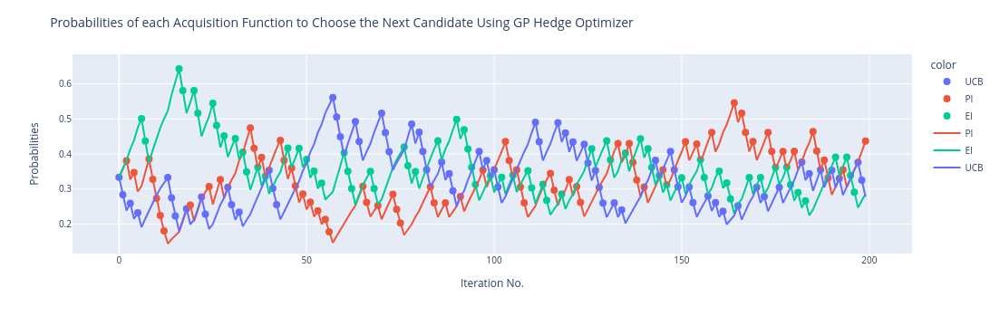

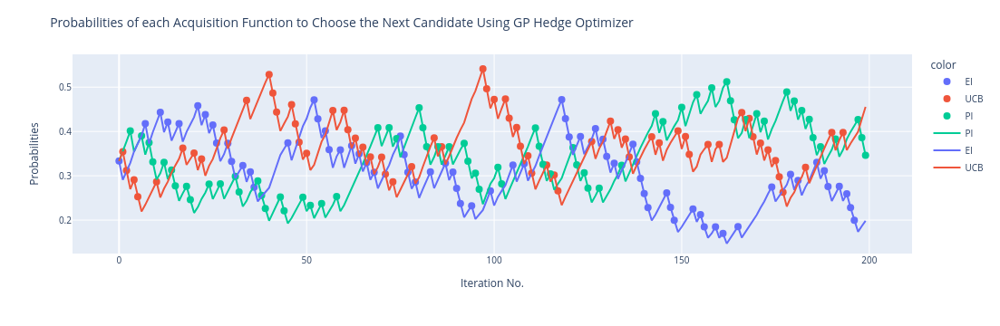

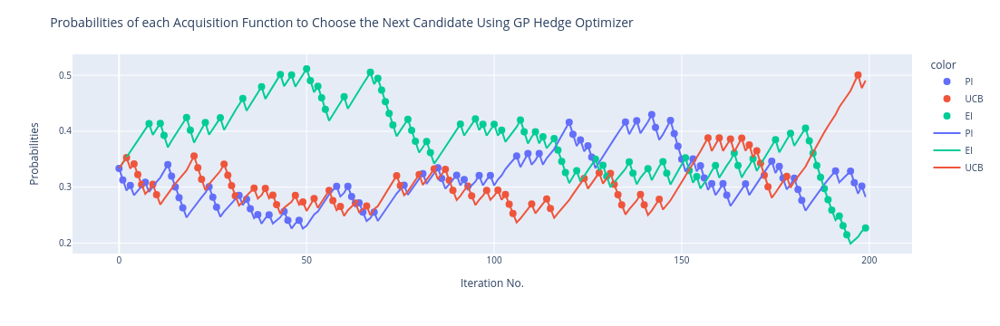

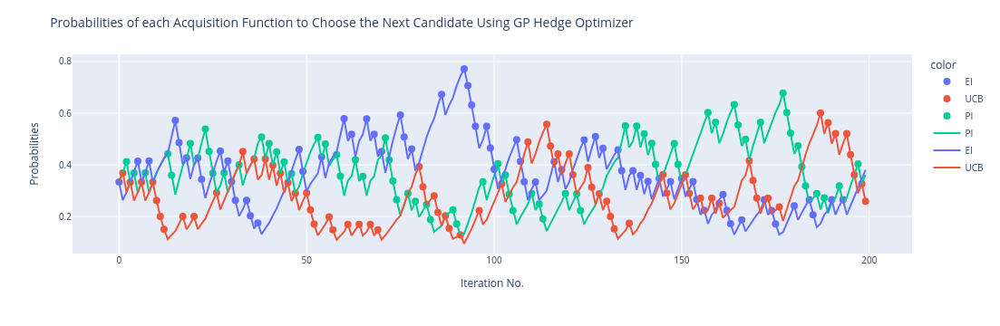

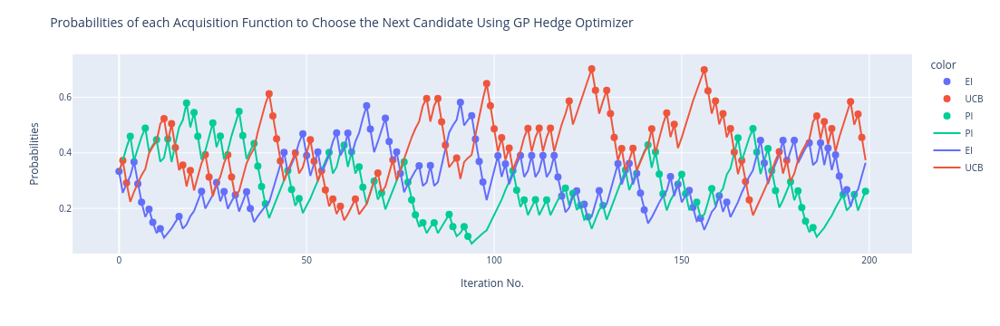

...

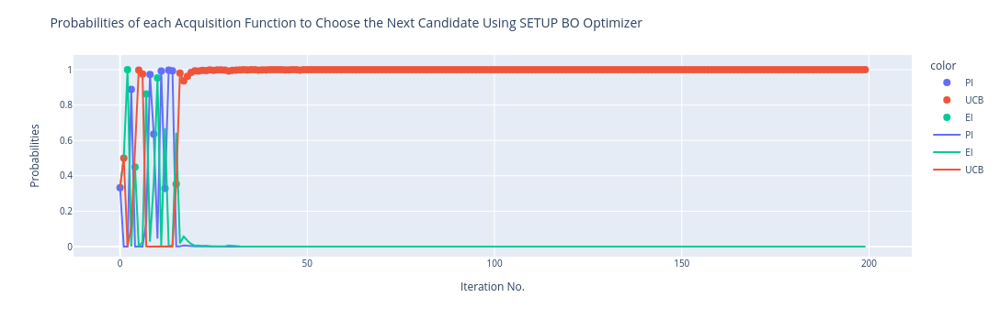

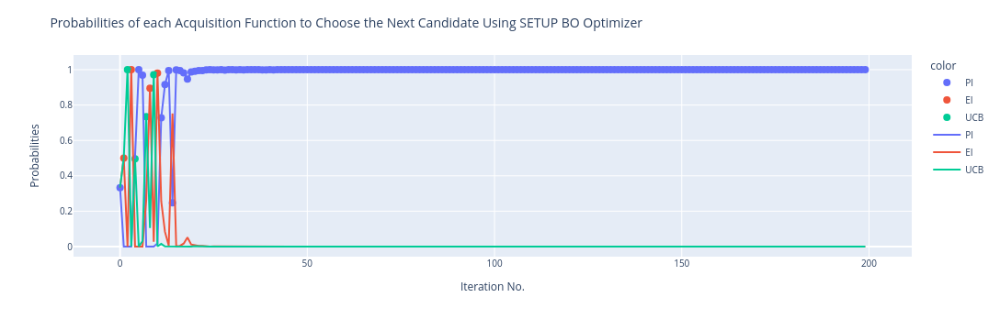

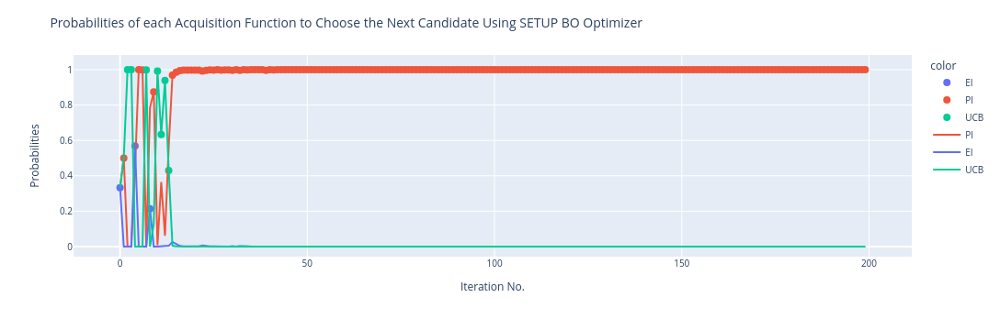

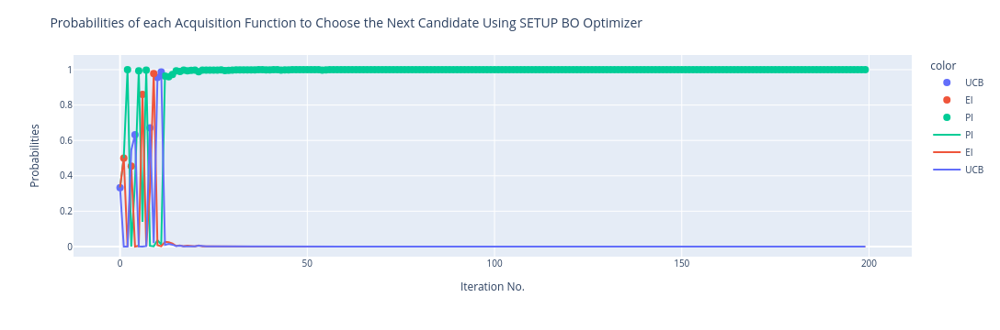

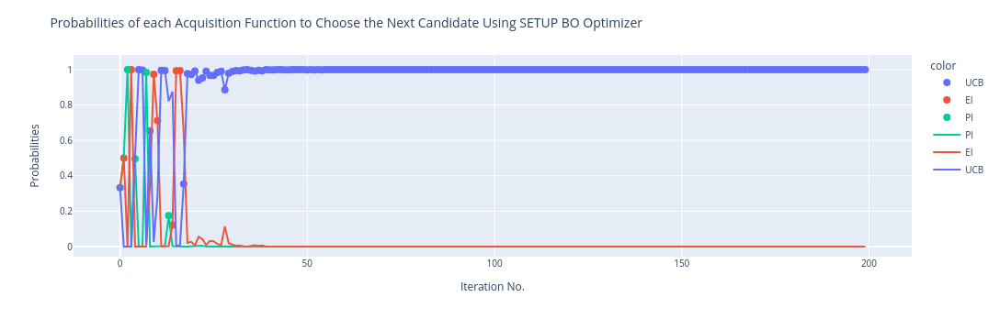

In [6]:
optimizers = {
    'Random Search': 'Random Search',
    'Simple BO (UCB)': 'Simple BO (UCB)',
    'Simple BO (PI)': 'Simple BO (PI)',
    'Simple BO (EI)': 'Simple BO (EI)',
    'GP Hedge_eta:0.01': 'GP Hedge',  
    'No-Past-BO_eta:0.1_m:0.8': 'No-Past-BO', 
    'No-Past-BO-VarM_eta:1.0_m:0.1-1.0': 'No-Past-BO-VarM',
    'SETUP BO': 'SETUP BO'
}
models = [
    'DQN-pattern',
    'DQN-vanilla',
    'DQN-candlerep',
    'DQN-windowed',
    'MLP-pattern',
    'MLP-vanilla',
    'MLP-candlerep',
    'MLP-windowed',
    'CNN1d',
    'CNN2d',
    'GRU',
    'Deep-CNN',
    'CNN-GRU',
    'CNN-ATTN'
]
import pandas as pd

# Assuming 'optimizers' and 'models' are predefined lists
data = {}

# Iterate over each optimizer and model combination
for optim, optimizer_name in optimizers.items():
    data[optimizer_name] = []
    for model_name in models:
        optimizer = load_pkl(f'run/{optim}/{model_name}/optimizer.pkl')
        try:
            plot_prob_accusition(optimizer, f'run/{optim}/{model_name}/')
        except:
            pass
            
        try:
            data[optimizer_name].append(optimizer.max_obj_value.item())
        except:
            data[optimizer_name].append(optimizer.max_obj_value)
# data['Base Model'] = []
# for model_name in models:
#     _, _, best = retrive_base_best(model_name)
#     data['Base Model'].append(best)

# Create a DataFrame
df = pd.DataFrame(data, index=models)

In [7]:
df

,Random Search,Simple BO (UCB),Simple BO (PI),Simple BO (EI),GP Hedge,No-Past-BO,No-Past-BO-VarM,SETUP BO
DQN-pattern,57.960553,56.902010,61.759910,60.767054,60.767054,59.561457,57.960553,56.821549
DQN-vanilla,63.672473,66.016342,60.935639,66.771070,63.767325,60.702453,61.911631,58.900101
DQN-candlerep,53.519732,57.339727,55.617557,63.417765,53.519732,55.732334,56.295714,57.339727
DQN-windowed,59.296865,63.070791,62.957416,59.652314,65.620724,61.287595,61.272172,66.760684
MLP-pattern,57.960553,57.960553,57.960553,62.394139,59.875408,61.851713,62.263762,57.960553
MLP-vanilla,64.128685,70.446989,60.114026,68.930937,60.114026,60.114026,74.173443,60.114026
MLP-candlerep,56.564119,54.162981,54.162981,57.343640,54.162981,54.162981,54.162981,54.162981
MLP-windowed,64.783462,65.687117,60.762244,58.566937,62.273655,59.740632,58.876128,61.910889
CNN1d,67.105986,60.114026,60.702453,60.426233,76.244812,65.026617,77.425390,64.422356
CNN2d,72.870206,62.257897,65.948547,60.780456,64.465693,60.780456,63.837849,61.011191


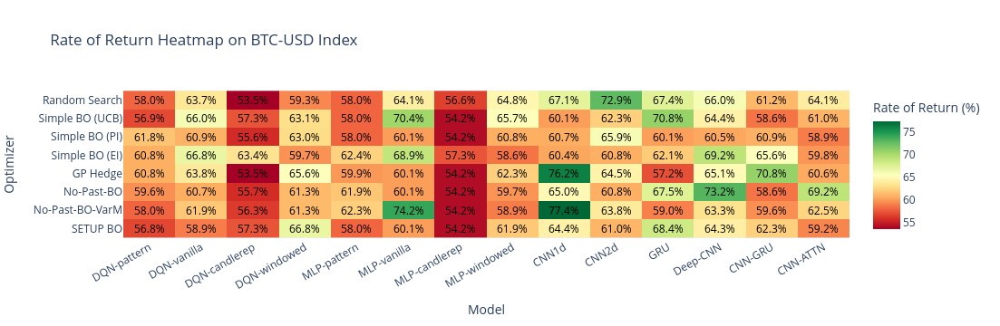

In [8]:
import plotly.express as px

# Assuming df is defined as shown previously.
fig_heatmap = px.imshow(
    df.T, 
    labels=dict(x="Model", y="Optimizer", color="Rate of Return (%)"),
    x=df.index, 
    y=df.columns, 
    aspect="auto", 
    title=f"Rate of Return Heatmap on {'BTC-USD'} Index",
    color_continuous_scale='RdYlGn'  # Red to Green color scale
)

# Add annotations
for i, optimizer in enumerate(df.columns):
    for j, model in enumerate(df.index):
        fig_heatmap.add_annotation(
            x=j, 
            y=i, 
            text=str(round(df.loc[model, optimizer],1)) + '%',
            showarrow=False,
            font=dict(
                color="black"
            )
        )

fig_heatmap.update_layout(
    xaxis=dict(tickangle=-30)
)

fig_heatmap.show()

# Save plot as an file
plot_path = os.path.join(os.getcwd(), f'run/figs')
if not os.path.exists(plot_path):
    os.makedirs(plot_path)
save_format = ['pdf', 'svg', 'jpg']
# Calculate the width and height in pixels (300 DPI for high-quality print)
dpi = 300
width_inches = 3.5  # Single column width in inches
height_inches = 2.625  # Adjusted height in inches for a 4:3 aspect ratio
# Convert inches to pixels
width_pixels = int(width_inches * dpi)
height_pixels = int(height_inches * dpi)
fig_heatmap.write_html(f'{plot_path}/ROR_heatmap.html')
for f in save_format:
    fig_heatmap.write_image(f'{plot_path}/ROR_heatmap.{f}', format=f, width=width_pixels, height=height_pixels)

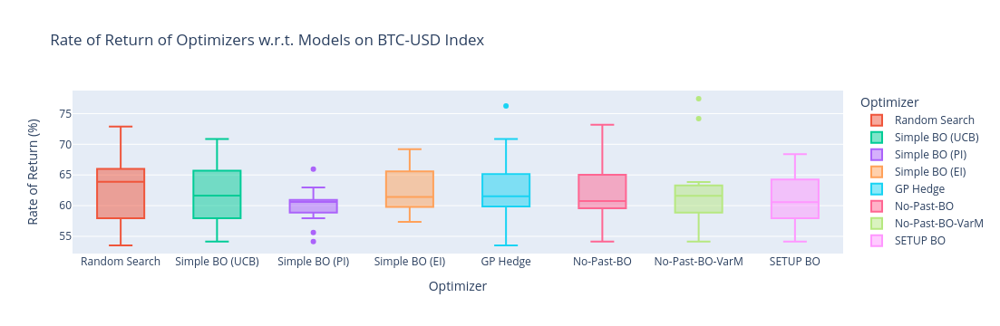

In [9]:
default_colors = px.colors.qualitative.Plotly  # This is typically the default qualitative color scale
new_color_sequence = default_colors[1:]  # Skip the first color

fig_box_optimizers = px.box(df.reset_index().melt(id_vars='index', var_name='Optimizer', value_name='Rate of Return (%)'),
                            x='Optimizer', y='Rate of Return (%)', color='Optimizer', color_discrete_sequence=new_color_sequence,
                            title=f"Rate of Return of Optimizers w.r.t. Models on {'BTC-USD'} Index")
fig_box_optimizers.show()

# Save plot as an file
plot_path = os.path.join(os.getcwd(), f'run/figs')
if not os.path.exists(plot_path):
    os.makedirs(plot_path)
save_format = ['pdf', 'svg', 'jpg']
# Calculate the width and height in pixels (300 DPI for high-quality print)
dpi = 300
width_inches = 3.5  # Single column width in inches
height_inches = 2.625  # Adjusted height in inches for a 4:3 aspect ratio
# Convert inches to pixels
width_pixels = int(width_inches * dpi)
height_pixels = int(height_inches * dpi)
fig_box_optimizers.write_html(f'{plot_path}/ROR_optimizer_model.html')
for f in save_format:
    fig_box_optimizers.write_image(f'{plot_path}/ROR_optimizer_model.{f}', format=f, width=width_pixels, height=height_pixels)

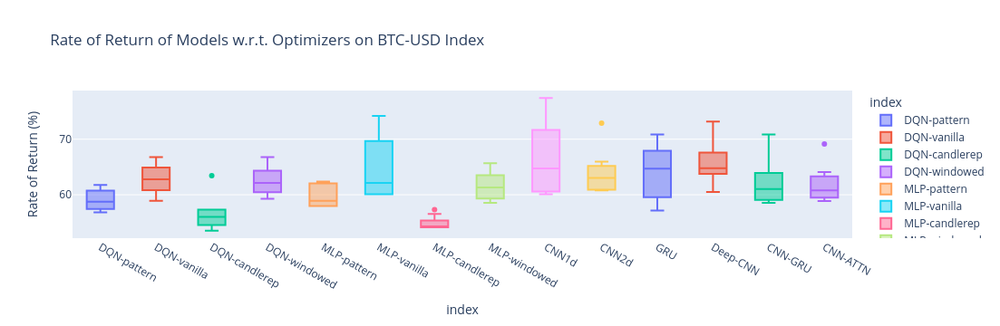

In [10]:
fig_box_models = px.box(df.reset_index().melt(id_vars='index', var_name='Optimizer', value_name='Rate of Return (%)'),
                        x='index', y='Rate of Return (%)', color='index', 
                        title=f"Rate of Return of Models w.r.t. Optimizers on {'BTC-USD'} Index")
fig_box_models.show()

# Save plot as an file
plot_path = os.path.join(os.getcwd(), f'run/figs')
if not os.path.exists(plot_path):
    os.makedirs(plot_path)
save_format = ['pdf', 'svg', 'jpg']
# Calculate the width and height in pixels (300 DPI for high-quality print)
dpi = 300
width_inches = 3.5  # Single column width in inches
height_inches = 2.625  # Adjusted height in inches for a 4:3 aspect ratio
# Convert inches to pixels
width_pixels = int(width_inches * dpi)
height_pixels = int(height_inches * dpi)
fig_box_models.write_html(f'{plot_path}/ROR_model_optimizer.html')
for f in save_format:
    fig_box_models.write_image(f'{plot_path}/ROR_model_optimizer.{f}', format=f, width=width_pixels, height=height_pixels)